In [1]:
# intalling libraries for automatic EDA and other necessary libraries
!pip install sweetviz
!pip install seaborn
!pip install ydata-profiling
!pip install pca

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 15.1/15.1 MB 72.5 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 357.8/357.8 kB 979.9 kB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 102.7/102.7 kB 11.9 MB/s eta 0:00:00
  Preparing metadata (setup.py) ... done
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 686.1/686.1 kB 31.6 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 293.3/293.3 kB 24.3 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 296.5/296.5 kB 34.5 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 4.7/4.7 MB 86.3 MB/s eta 0:00:00
  Created wheel for htmlmin: filename=htmlmin-0.1.12-py3-none-any.whl size=27081 sha256=550ad04f818ad6817a72a494d1f9e27a4fa7300657da6395029a3b28cadc00a4
  Stored in directory: /root/.cache/pip/wheels/dd/91/29/a79cecb328d01739e64017b6fb9a1ab9d8cb1853098ec5966d
Successfully built htmlmin
  Attempting uninstall: seaborn
    Found existing installation: seaborn 0.13.1
    Uninstalling

In [2]:
# Import necessary libraries
import pandas as pd
import numpy as np
from matplotlib import pyplot as plt
import seaborn as sns
from scipy import stats

In [4]:
df = pd.read_csv('/content/sample_data/hrm-employee-attrition_unclean.csv')

In [ ]:
# Initial look at the data
df.head()

,Unnamed: 0,Attrition,Age,BusinessTravel,DailyRate,Department,DistanceFromHome,Education,EducationField,EnvironmentSatisfaction,...,TotalWorkingYears,TrainingTimesLastYear,WorkLifeBalance,YearsAtCompany,YearsInCurrentRole,YearsSinceLastPromotion,YearsWithCurrManager,SalaryAddition,YearlyHollidayDays,DrivingKilometers
0,0,Yes,41.0,Travel_Rarely,1102.0,Sales,1.0,2,Life Sciences,2.0,...,8.0,0.0,1.0,6.0,4.0,NaN,5.0,792.803050,10.0,NaN
1,1,No,49.0,Travel_Frequently,279.0,Research & Development,8.0,1,Life Sciences,3.0,...,10.0,3.0,3.0,10.0,7.0,1.0,7.0,1199.848653,NaN,NaN
2,2,Yes,37.0,Travel_Rarely,1373.0,Research & Development,2.0,2,Other,4.0,...,7.0,3.0,3.0,0.0,0.0,0.0,0.0,1366.620630,NaN,NaN
3,3,No,33.0,Travel_Frequently,1392.0,Research & Development,3.0,4,Life Sciences,4.0,...,8.0,3.0,3.0,8.0,7.0,3.0,0.0,1770.840125,10.0,0.640162
4,4,No,27.0,Travel_Rarely,591.0,Research & Development,2.0,1,Medical,1.0,...,6.0,3.0,3.0,2.0,2.0,2.0,2.0,1043.414893,10.0,2.122465


In [ ]:
# Columns names
df.columns

Index(['Unnamed: 0', 'Attrition', 'Age', 'BusinessTravel', 'DailyRate',
       'Department', 'DistanceFromHome', 'Education', 'EducationField',
       'EnvironmentSatisfaction', 'Gender', 'HourlyRate', 'JobInvolvement',
       'JobLevel', 'JobRole', 'JobSatisfaction', 'MaritalStatus',
       'MonthlyIncome', 'MonthlyRate', 'NumCompaniesWorked', 'Over18',
       'OverTime', 'PercentSalaryHike', 'PerformanceRating',
       'RelationshipSatisfaction', 'StandardHours', 'StockOptionLevel',
       'TotalWorkingYears', 'TrainingTimesLastYear', 'WorkLifeBalance',
       'YearsAtCompany', 'YearsInCurrentRole', 'YearsSinceLastPromotion',
       'YearsWithCurrManager', 'SalaryAddition', 'YearlyHollidayDays',
       'DrivingKilometers'],
      dtype='object')

In [ ]:
# look at the end of the data
df.tail()

,Unnamed: 0,Attrition,Age,BusinessTravel,DailyRate,Department,DistanceFromHome,Education,EducationField,EnvironmentSatisfaction,...,TotalWorkingYears,TrainingTimesLastYear,WorkLifeBalance,YearsAtCompany,YearsInCurrentRole,YearsSinceLastPromotion,YearsWithCurrManager,SalaryAddition,YearlyHollidayDays,DrivingKilometers
1465,1465,No,36.0,Travel_Frequently,884.0,Research & Development,23.0,2,Medical,3.0,...,17.0,NaN,3.0,5.0,2.0,0.0,3.0,1468.084847,NaN,NaN
1466,1466,No,39.0,Travel_Rarely,613.0,Research & Development,6.0,1,Medical,4.0,...,9.0,5.0,3.0,7.0,7.0,1.0,7.0,377.731602,NaN,NaN
1467,1467,No,27.0,Travel_Rarely,155.0,Research & Development,4.0,3,Life Sciences,2.0,...,6.0,0.0,3.0,6.0,2.0,0.0,3.0,701.628425,10.0,NaN
1468,1468,No,49.0,Travel_Frequently,1023.0,Sales,2.0,3,Medical,4.0,...,17.0,3.0,2.0,9.0,6.0,0.0,8.0,1646.231971,NaN,NaN
1469,1469,No,34.0,Travel_Rarely,628.0,Research & Development,8.0,3,Medical,2.0,...,6.0,3.0,4.0,4.0,3.0,1.0,2.0,567.093057,10.0,NaN


In [ ]:
# A look at the descriptive statistics of the variables
df.describe().T

,count,mean,std,min,25%,50%,75%,max
Unnamed: 0,1470.0,734.500000,424.496761,0.000000,367.250000,734.500000,1101.750000,1469.000000
Age,1470.0,36.923810,9.135373,18.000000,30.000000,36.000000,43.000000,60.000000
DailyRate,1470.0,802.485714,403.509100,102.000000,465.000000,802.000000,1157.000000,1499.000000
DistanceFromHome,1470.0,9.192517,8.106864,1.000000,2.000000,7.000000,14.000000,29.000000
Education,1470.0,2.912925,1.024165,1.000000,2.000000,3.000000,4.000000,5.000000
EnvironmentSatisfaction,1470.0,2.721769,1.093082,1.000000,2.000000,3.000000,4.000000,4.000000
HourlyRate,1470.0,65.891156,20.329428,30.000000,48.000000,66.000000,83.750000,100.000000
JobInvolvement,1470.0,2.729932,0.711561,1.000000,2.000000,3.000000,3.000000,4.000000
JobLevel,1470.0,2.063946,1.106940,1.000000,1.000000,2.000000,3.000000,5.000000
JobSatisfaction,1470.0,2.728571,1.102846,1.000000,2.000000,3.000000,4.000000,4.000000


# Question 1 - Initial automatic EDA

### - Done with SweetViz and ydata-profiling

In [5]:
# Automated EDA with SweetViz
import sweetviz as sv

my_report = sv.analyze(df)
my_report.show_html() # Default arguments will generate to "SWEETVIZ_REPORT.html"

                                             |          | [  0%]   00:00 -> (? left)

Report SWEETVIZ_REPORT.html was generated! NOTEBOOK/COLAB USERS: the web browser MAY not pop up, regardless, the report IS saved in your notebook/colab files.


In [6]:
# Automated EDA with Y-Data
from ydata_profiling import ProfileReport

profile = ProfileReport(df, title="Profiling Report")
profile.to_file("profiling_report.html")

/usr/local/lib/python3.10/dist-packages/ydata_profiling/profile_report.py:354: UserWarning: Try running command: 'pip install --upgrade Pillow' to avoid ValueError
  warnings.warn(


Summarize dataset:   0%|          | 0/5 [00:00<?, ?it/s]

Generate report structure:   0%|          | 0/1 [00:00<?, ?it/s]

Render HTML:   0%|          | 0/1 [00:00<?, ?it/s]

Export report to file:   0%|          | 0/1 [00:00<?, ?it/s]

# Question 2 - Check each variable using graphs grouping
# Every graphic by the data types (categorical-nominal, ordinal, and continuous)

In [ ]:
# Assigning the target variable as the label column
label_col = 'Attrition'

In [ ]:
# Dictionary grouping the columns of the data into data types
type_to_col = {'continuous':
['Age', 'DailyRate', 'DistanceFromHome', 'HourlyRate', 'MonthlyIncome', 'MonthlyRate', 'NumCompaniesWorked', 'PercentSalaryHike', 'TotalWorkingYears', 'YearsAtCompany', 'YearsInCurrentRole', 'YearsSinceLastPromotion', 'YearsWithCurrManager', 'SalaryAddition', "YearlyHollidayDays", "TrainingTimesLastYear", "DrivingKilometers"],
'ordinal': ['BusinessTravel', 'Education', 'EnvironmentSatisfaction', 'JobInvolvement', 'JobLevel', 'JobSatisfaction', 'PerformanceRating', 'RelationshipSatisfaction', 'StockOptionLevel',  'WorkLifeBalance', 'StandardHours'],
'categorical': ['Department', 'EducationField', 'Gender', 'JobRole', 'MaritalStatus', 'OverTime', 'Over18']}
# Maybe add another code block with dtype to show what we are transforming from into

In [ ]:
# changing the data type of each variable from "object" or "Int" or "Float" to "category"
for col in type_to_col['categorical']:
    df[col] = df[col].astype('category')

for col in type_to_col['ordinal']:
    df[col] = df[col].astype('category')

In [ ]:
# Assigning the number of columns to num_cols in order to lay out the sublots grid afterwards
num_cols = sum([len(val) for val in type_to_col.values()])
num_cols

35

In [ ]:
# Additional look at the column names
cols = df.columns
cols

Index(['Unnamed: 0', 'Attrition', 'Age', 'BusinessTravel', 'DailyRate',
       'Department', 'DistanceFromHome', 'Education', 'EducationField',
       'EnvironmentSatisfaction', 'Gender', 'HourlyRate', 'JobInvolvement',
       'JobLevel', 'JobRole', 'JobSatisfaction', 'MaritalStatus',
       'MonthlyIncome', 'MonthlyRate', 'NumCompaniesWorked', 'Over18',
       'OverTime', 'PercentSalaryHike', 'PerformanceRating',
       'RelationshipSatisfaction', 'StandardHours', 'StockOptionLevel',
       'TotalWorkingYears', 'TrainingTimesLastYear', 'WorkLifeBalance',
       'YearsAtCompany', 'YearsInCurrentRole', 'YearsSinceLastPromotion',
       'YearsWithCurrManager', 'SalaryAddition', 'YearlyHollidayDays',
       'DrivingKilometers'],
      dtype='object')

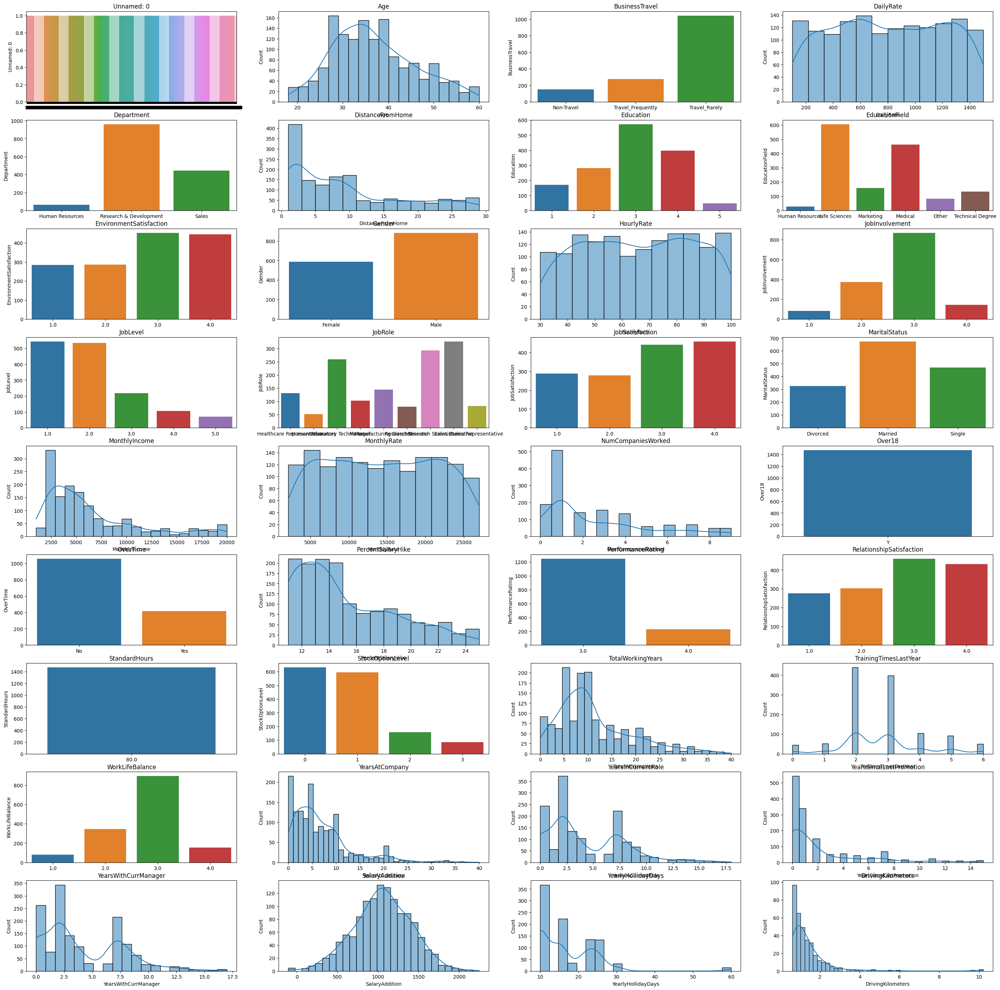

In [ ]:
# Creating subplots in order to visualize our data
fig, ax = plt.subplots(9,4,figsize=(num_cols,num_cols))
m = 0
n = 0
for col in cols:
    if col == label_col:
        continue
    else:
        if m >= 4:
            m = 0
            n = n + 1
        if col in type_to_col['continuous']:
            sns.histplot(ax=ax[n,m], x=df[col], kde=True).set(title=col)
        else:
            sns.barplot(ax=ax[n,m], x=df[col].value_counts().index, y=df[col].value_counts()).set(title=col)
        m = m + 1

# Question 3 - plot boxplot in order to see outliers

In [ ]:
# A look at the continuous data before box plotting
type_to_col['continuous']

['Age',
 'DailyRate',
 'DistanceFromHome',
 'HourlyRate',
 'MonthlyIncome',
 'MonthlyRate',
 'NumCompaniesWorked',
 'PercentSalaryHike',
 'TotalWorkingYears',
 'YearsAtCompany',
 'YearsInCurrentRole',
 'YearsSinceLastPromotion',
 'YearsWithCurrManager',
 'SalaryAddition',
 'YearlyHollidayDays',
 'TrainingTimesLastYear',
 'DrivingKilometers']

Age 30.0 43.0 13.0
DailyRate 465.0 1157.0 692.0
DistanceFromHome 2.0 14.0 12.0
HourlyRate 48.0 83.75 35.75
MonthlyIncome 2911.0 8379.0 5468.0
MonthlyRate 8047.0 20461.5 12414.5
NumCompaniesWorked 1.0 4.0 3.0
PercentSalaryHike 12.0 18.0 6.0
TotalWorkingYears 6.0 15.0 9.0
YearsAtCompany 3.0 9.0 6.0
YearsInCurrentRole 2.0 7.0 5.0
YearsSinceLastPromotion 0.0 3.0 3.0
YearsWithCurrManager 2.0 7.0 5.0
SalaryAddition 829.1501612087204 1294.532565098015 465.38240388929466
YearlyHollidayDays 10.0 22.0 12.0
TrainingTimesLastYear 2.0 3.0 1.0
DrivingKilometers 0.8025399830168563 1.5526734347663296 0.7501334517494733
{'Age': (10.5, 62.5), 'DailyRate': (-573.0, 2195.0), 'DistanceFromHome': (-16.0, 32.0), 'HourlyRate': (-5.625, 137.375), 'MonthlyIncome': (-5291.0, 16581.0), 'MonthlyRate': (-10574.75, 39083.25), 'NumCompaniesWorked': (-3.5, 8.5), 'PercentSalaryHike': (3.0, 27.0), 'TotalWorkingYears': (-7.5, 28.5), 'YearsAtCompany': (-6.0, 18.0), 'YearsInCurrentRole': (-5.5, 14.5), 'YearsSinceLastPromot

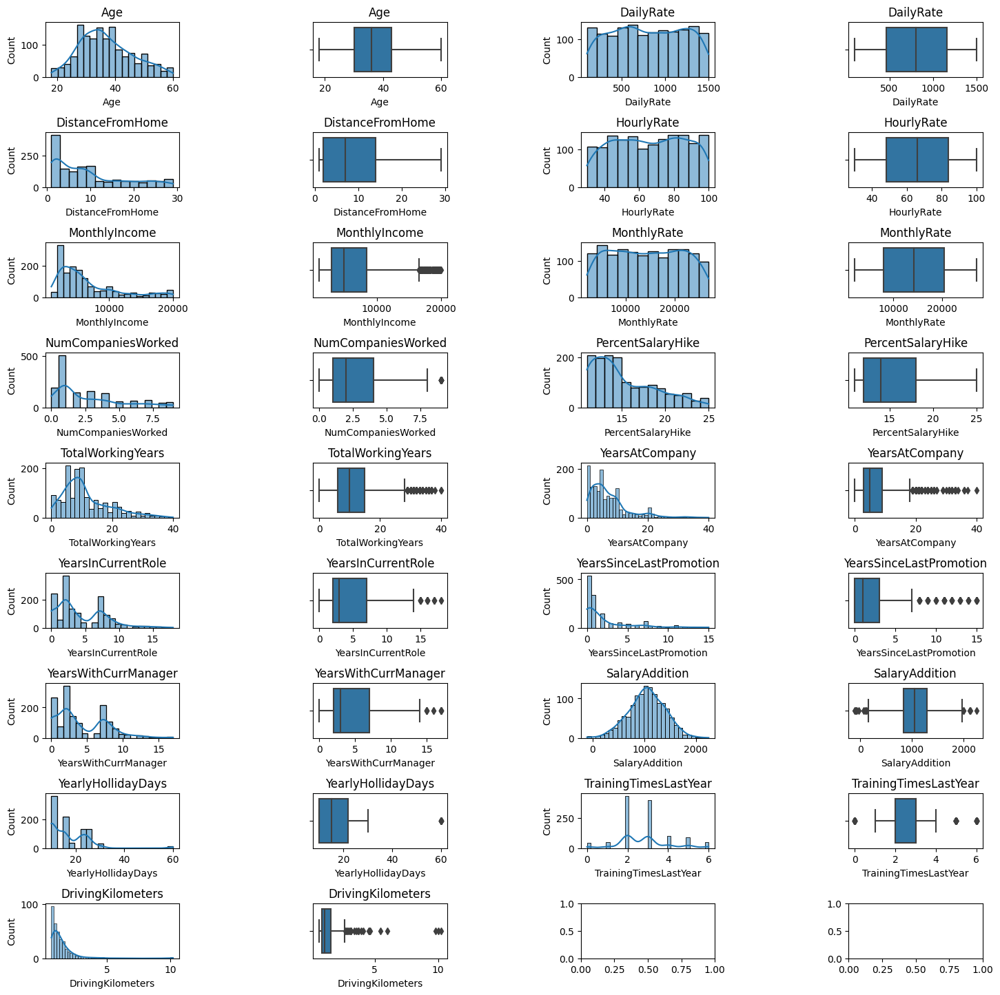

In [ ]:
# Plotting box plots and density plots for the continuous variables to look for outliers
from pandas.api.types import is_numeric_dtype
import math

fig, ax = plt.subplots(math.ceil(len(type_to_col['continuous']) / 2),4,figsize=(len(type_to_col['continuous']), len(type_to_col['continuous'])))
borders = {}

m = 0
n = 0
for i in range(len(type_to_col['continuous'])):
    col = type_to_col['continuous'][i]
    if col == label_col:
        continue
    if m >= 4:
        m = 0
        n = n + 1
    if col in type_to_col['continuous']:
        q1, q3 = np.percentile(df[col].dropna(), [25, 75])
        iqr = q3 - q1
        print(col, q1, q3, iqr)
        borders[col] = (q1 - 1.5 * iqr, q3 + 1.5 * iqr)
        sns.histplot(ax=ax[n,m], x=df[col].dropna(), kde=True).set(title=col)
        sns.boxplot(ax=ax[n,m+1], x=df[col].dropna()).set(title=col)

    m = m + 2

plt.subplots_adjust(left=0.1, bottom=0.1, right=0.9, \
                    top=0.9, wspace=1,hspace=1)
print(borders)

In [ ]:
# Looking if there are any outliers in "Age" variable
df[(df.Age < borders["Age"][0]) | (df.Age > borders["Age"][1])]

,Unnamed: 0,Attrition,Age,BusinessTravel,DailyRate,Department,DistanceFromHome,Education,EducationField,EnvironmentSatisfaction,...,TotalWorkingYears,TrainingTimesLastYear,WorkLifeBalance,YearsAtCompany,YearsInCurrentRole,YearsSinceLastPromotion,YearsWithCurrManager,SalaryAddition,YearlyHollidayDays,DrivingKilometers


In [ ]:
# It show us there are no outliers at age which is important (since basically all ages between 0 to 120 are possible)

In [ ]:
# It's possible to see sometimes outliers outside of the 1.5 * inter quantile range, usually it is from the right side and
# the outliers too big, but sometimes you can notice it from the left side which means they are to small (for example SalaryAddition)

In [ ]:
# Computing Total number of missing values and the percentage of missing values before changing the data
missing_values_df = df.isna().sum().to_frame().rename(columns={0:"Total No. of Missing Values"})

missing_values_df["% of Missing Values"] = round((missing_values_df["Total No. of Missing Values"]/len(df))*100,2)

missing_values_df

,Total No. of Missing Values,% of Missing Values
Unnamed: 0,0,0.00
Attrition,0,0.00
Age,0,0.00
BusinessTravel,0,0.00
DailyRate,0,0.00
Department,0,0.00
DistanceFromHome,0,0.00
Education,0,0.00
EducationField,0,0.00
EnvironmentSatisfaction,0,0.00


In [ ]:
print("These are the outliers:")
print(borders)
for col in type_to_col['continuous']:
    print(col, borders[col])
    print(df[(df[col] < borders[col][0]) | (df[col] > borders[col][1])][col])

These are the outliers:
{'Age': (10.5, 62.5), 'DailyRate': (-573.0, 2195.0), 'DistanceFromHome': (-16.0, 32.0), 'HourlyRate': (-5.625, 137.375), 'MonthlyIncome': (-5291.0, 16581.0), 'MonthlyRate': (-10574.75, 39083.25), 'NumCompaniesWorked': (-3.5, 8.5), 'PercentSalaryHike': (3.0, 27.0), 'TotalWorkingYears': (-7.5, 28.5), 'YearsAtCompany': (-6.0, 18.0), 'YearsInCurrentRole': (-5.5, 14.5), 'YearsSinceLastPromotion': (-4.5, 7.5), 'YearsWithCurrManager': (-5.5, 14.5), 'SalaryAddition': (131.07655537477842, 1992.606170931957), 'YearlyHollidayDays': (-8.0, 40.0), 'TrainingTimesLastYear': (0.5, 4.5), 'DrivingKilometers': (-0.32266019460735373, 2.6778736123905396)}
Age (10.5, 62.5)
Series([], Name: Age, dtype: float64)
DailyRate (-573.0, 2195.0)
Series([], Name: DailyRate, dtype: float64)
DistanceFromHome (-16.0, 32.0)
Series([], Name: DistanceFromHome, dtype: float64)
HourlyRate (-5.625, 137.375)
Series([], Name: HourlyRate, dtype: float64)
MonthlyIncome (-5291.0, 16581.0)
25      19094.0
29

In [ ]:
# As one can see all outliers are positive except a few negative in "SalaryAddition" variable.
# However, it makes sense that a few workers' saleries were decreased during the time

# Question 4 - Graphs (scatterplots) and statistical analysis for correlation between numeric variables

In [ ]:
# Function that implement Pearson correlation test
from scipy.stats import pearsonr

def corr_pearson_func(x, y, hue=None, ax=None, **kws):
    """Plot the correlation coefficient in the top left hand corner of a plot."""
    corr, p_siginificane = pearsonr(x, y)

    return corr, p_siginificane

In [ ]:
# Function that implement Spearman correlation test
from scipy.stats import spearmanr

def corr_spearman_func(x, y, hue=None, ax=None, **kws):
    """Plot the correlation coefficient in the top left hand corner of a plot."""
    corr, p_siginificane = spearmanr(x, y)

    return corr, p_siginificane

In [ ]:
# Another look at the continuous variables
df[type_to_col['continuous']]

,Age,DailyRate,DistanceFromHome,HourlyRate,MonthlyIncome,MonthlyRate,NumCompaniesWorked,PercentSalaryHike,TotalWorkingYears,YearsAtCompany,YearsInCurrentRole,YearsSinceLastPromotion,YearsWithCurrManager,SalaryAddition,YearlyHollidayDays,TrainingTimesLastYear,DrivingKilometers
0,41.0,1102.0,1.0,94.0,5993.0,19479.0,8.0,11.0,8.0,6.0,4.0,NaN,5.0,792.803050,10.0,0.0,NaN
1,49.0,279.0,8.0,61.0,5130.0,24907.0,1.0,23.0,10.0,10.0,7.0,1.0,7.0,1199.848653,NaN,3.0,NaN
2,37.0,1373.0,2.0,92.0,2090.0,2396.0,6.0,15.0,7.0,0.0,0.0,0.0,0.0,1366.620630,NaN,3.0,NaN
3,33.0,1392.0,3.0,56.0,2909.0,23159.0,1.0,11.0,8.0,8.0,7.0,3.0,0.0,1770.840125,10.0,3.0,0.640162
4,27.0,591.0,2.0,40.0,3468.0,16632.0,9.0,12.0,6.0,2.0,2.0,2.0,2.0,1043.414893,10.0,3.0,2.122465
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1465,36.0,884.0,23.0,41.0,2571.0,12290.0,4.0,17.0,17.0,5.0,2.0,0.0,3.0,1468.084847,NaN,NaN,NaN
1466,39.0,613.0,6.0,42.0,9991.0,21457.0,4.0,15.0,9.0,7.0,7.0,1.0,7.0,377.731602,NaN,5.0,NaN
1467,27.0,155.0,4.0,87.0,6142.0,5174.0,1.0,20.0,6.0,6.0,2.0,0.0,3.0,701.628425,10.0,0.0,NaN
1468,49.0,1023.0,2.0,63.0,5390.0,13243.0,2.0,14.0,17.0,9.0,6.0,0.0,8.0,1646.231971,NaN,3.0,NaN


In [ ]:
# Sum of NA values for every continuous variable
for col in type_to_col['continuous']:
    print(col, df[col].isna().sum())

Age 0
DailyRate 0
DistanceFromHome 0
HourlyRate 0
MonthlyIncome 0
MonthlyRate 0
NumCompaniesWorked 45
PercentSalaryHike 0
TotalWorkingYears 0
YearsAtCompany 0
YearsInCurrentRole 0
YearsSinceLastPromotion 88
YearsWithCurrManager 0
SalaryAddition 173
YearlyHollidayDays 528
TrainingTimesLastYear 292
DrivingKilometers 1117


1. spearman correlation between Age and MonthlyIncome is 0.47, while p is 0.000


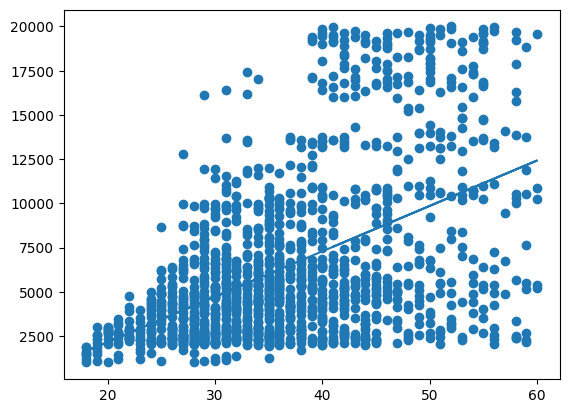

2. spearman correlation between Age and NumCompaniesWorked is 0.36, while p is 0.000


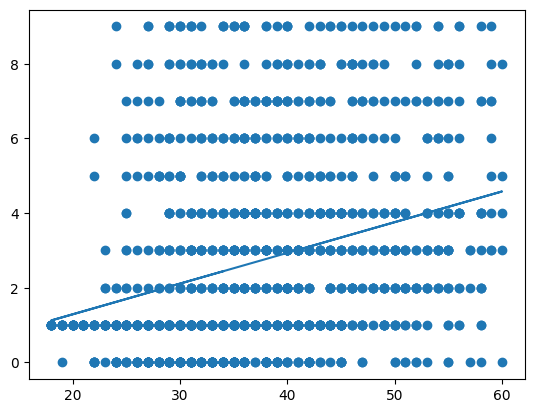

3. spearman correlation between Age and TotalWorkingYears is 0.66, while p is 0.000


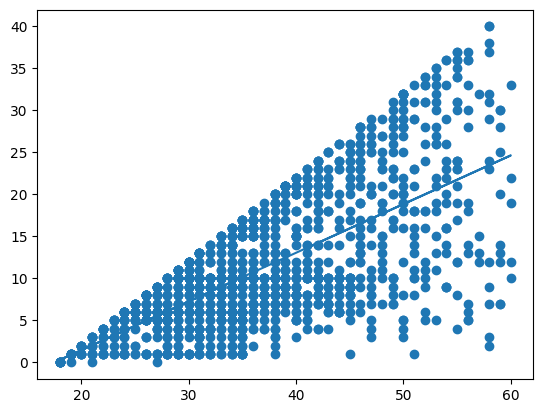

4. spearman correlation between MonthlyIncome and TotalWorkingYears is 0.71, while p is 0.000


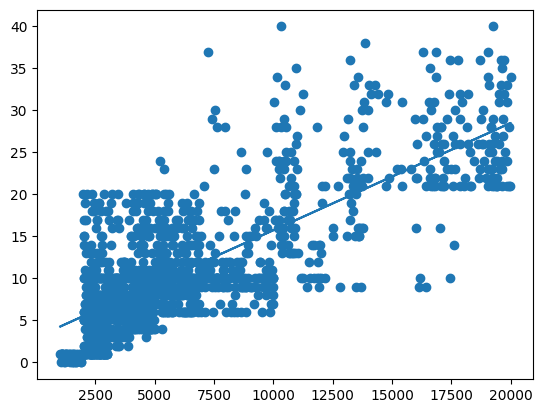

5. spearman correlation between MonthlyIncome and YearsAtCompany is 0.46, while p is 0.000


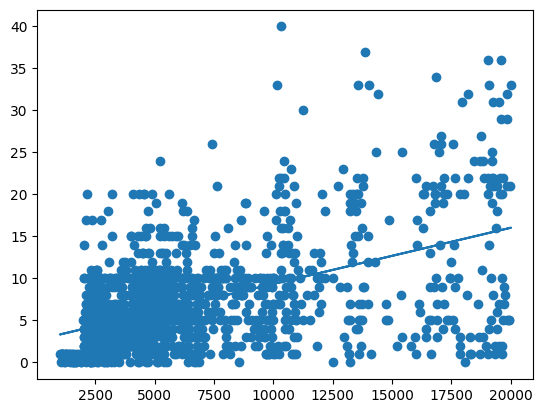

6. spearman correlation between MonthlyIncome and YearsInCurrentRole is 0.39, while p is 0.000


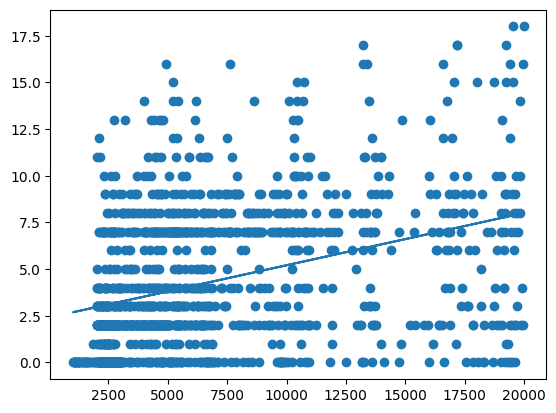

7. spearman correlation between MonthlyIncome and YearsWithCurrManager is 0.37, while p is 0.000


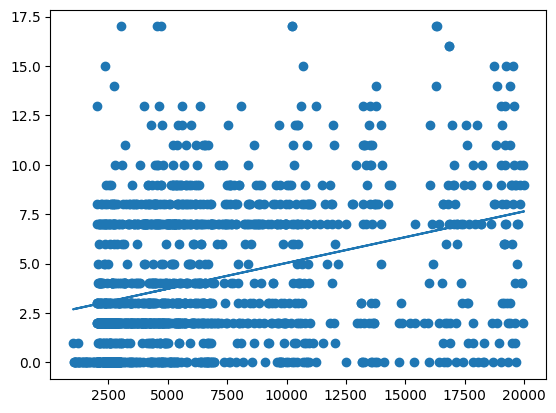

8. spearman correlation between NumCompaniesWorked and TotalWorkingYears is 0.31, while p is 0.000


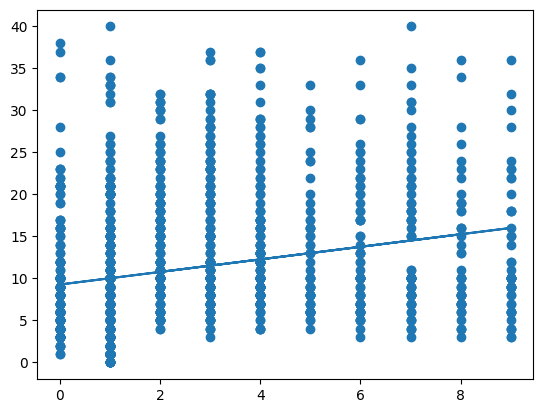

9. spearman correlation between TotalWorkingYears and YearsAtCompany is 0.59, while p is 0.000


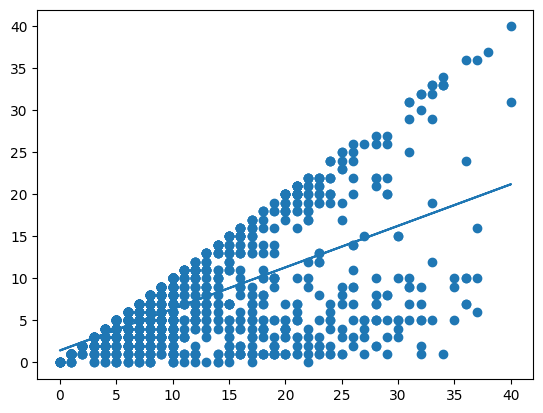

10. spearman correlation between TotalWorkingYears and YearsInCurrentRole is 0.49, while p is 0.000


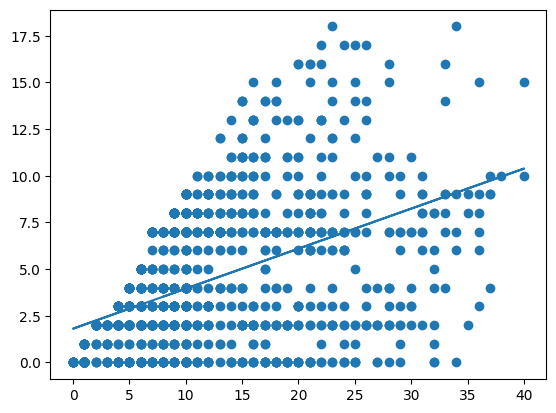

11. spearman correlation between TotalWorkingYears and YearsSinceLastPromotion is 0.34, while p is 0.000


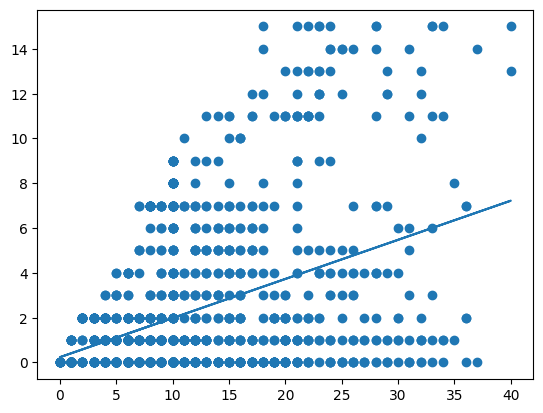

12. spearman correlation between TotalWorkingYears and YearsWithCurrManager is 0.50, while p is 0.000


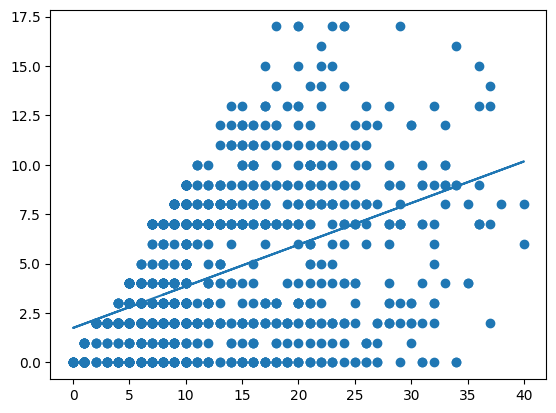

13. spearman correlation between YearsAtCompany and YearsInCurrentRole is 0.85, while p is 0.000


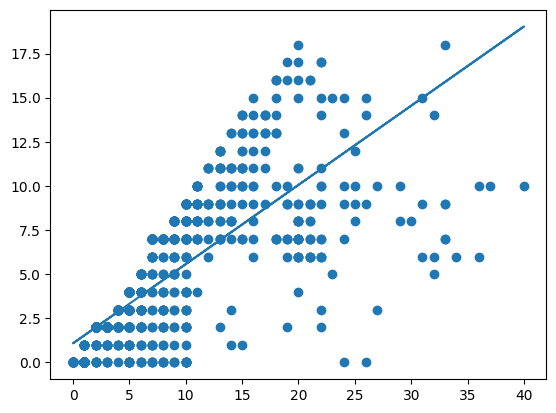

14. spearman correlation between YearsAtCompany and YearsSinceLastPromotion is 0.52, while p is 0.000


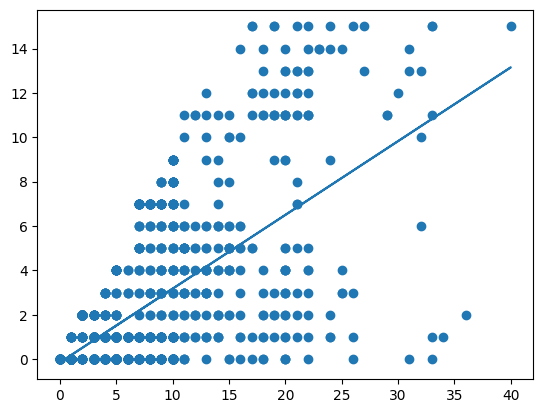

15. spearman correlation between YearsAtCompany and YearsWithCurrManager is 0.84, while p is 0.000


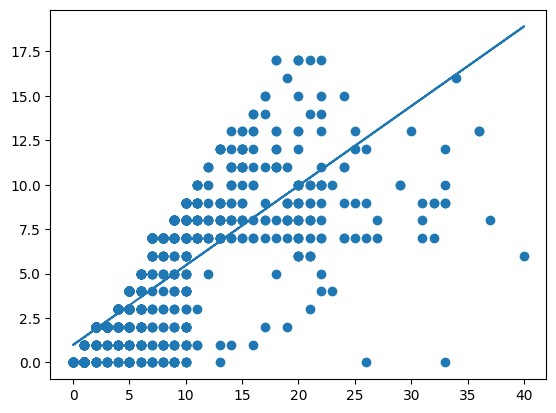

16. spearman correlation between YearsInCurrentRole and YearsSinceLastPromotion is 0.51, while p is 0.000


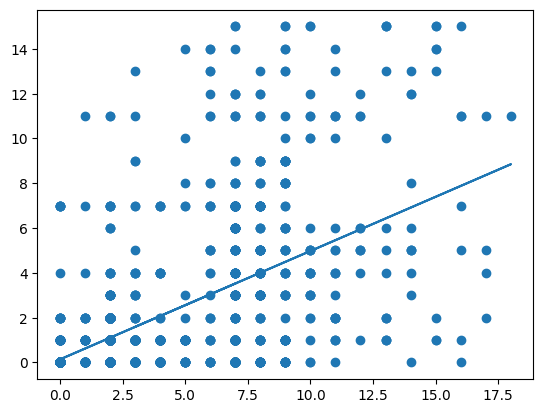

17. spearman correlation between YearsInCurrentRole and YearsWithCurrManager is 0.72, while p is 0.000


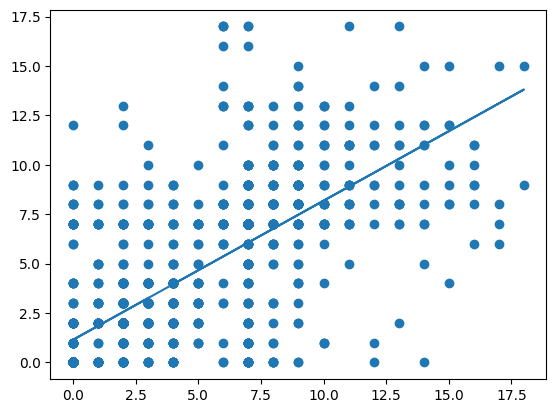

18. spearman correlation between YearsSinceLastPromotion and YearsWithCurrManager is 0.47, while p is 0.000


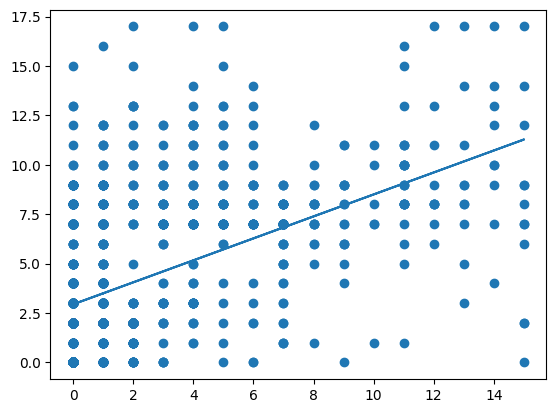

In [ ]:
# Scatter plot for correlations
from scipy.stats import shapiro

count = 0

for idx1, col1 in enumerate(type_to_col['continuous']):
    for idx2 in range(idx1 + 1, len(type_to_col['continuous'])):
        col2 = type_to_col['continuous'][idx2]
        df_for_corr = df[[col1, col2]].copy()
        df_for_corr = df_for_corr.dropna()

        if shapiro(df_for_corr[col1]).pvalue >= 0.05 and shapiro(df_for_corr[col2]).pvalue >= 0.05:
            corr, p = corr_pearson_func(df_for_corr[col1], df_for_corr[col2])
            title = f"pearson correlation between {col1} and {col2} (both normal distributed) is {corr:.2f}, while p is {p:.3f}"
        else:
            corr, p = corr_spearman_func(df_for_corr[col1], df_for_corr[col2])
            title = f"spearman correlation between {col1} and {col2} is {corr:.2f}, while p is {p:.3f}"

        if abs(corr) >= 0.3 and p <= 0.05:
            count += 1
            title = f"{count}. " + title
            print(title)
            plt.scatter(df_for_corr[col1], df_for_corr[col2])
            # obtain m (slope) and b(intercept) of linear regression line
            m, b = np.polyfit(df_for_corr[col1], df_for_corr[col2], 1)
            # add linear regression line to scatterplot
            plt.plot(df_for_corr[col1], m * df_for_corr[col1] + b)
            plt.show()

In [ ]:
# Findings of correlation tests:

# 1. spearman correlation between Age and MonthlyIncome

# 3. spearman correlation between Age and TotalWorkingYears

# 4. spearman correlation between MonthlyIncome and TotalWorkingYears

# 5. spearman correlation between MonthlyIncome and YearsAtCompany

# 9. spearman correlation between TotalWorkingYears and YearsAtCompany

# 10. spearman correlation between TotalWorkingYears and YearsInCurrentRole

# 11. spearman correlation between TotalWorkingYears and YearsSinceLastPromotion

# 12. spearman correlation between TotalWorkingYears and YearsWithCurrManager

# 13. spearman correlation between YearsAtCompany and YearsInCurrentRole

# 14. spearman correlation between YearsAtCompany and YearsSinceLastPromotion

# 15. spearman correlation between YearsAtCompany and YearsWithCurrManager

# Summary:
# 11 correlations that are reliable in our opinion

# Question 5 - Graphs (histograms/distribution plots) and statistical analysis, for checking the difference between the numeric variables within categories of different categorical variables

In [ ]:
# A look at the ordinal variables before difference test
df[type_to_col['ordinal']].describe().T

,count,unique,top,freq
BusinessTravel,1470,3,Travel_Rarely,1043
Education,1470,5,3,572
EnvironmentSatisfaction,1470.0,4.0,3.0,453.0
JobInvolvement,1470.0,4.0,3.0,868.0
JobLevel,1470.0,5.0,1.0,543.0
JobSatisfaction,1470.0,4.0,4.0,459.0
PerformanceRating,1470.0,2.0,3.0,1244.0
RelationshipSatisfaction,1470.0,4.0,3.0,459.0
StockOptionLevel,1470,4,0,631
WorkLifeBalance,1470.0,4.0,3.0,893.0


In [ ]:
# A look at the categorial variables before difference test
df[type_to_col['categorical']].describe().T

,count,unique,top,freq
Department,1470,3,Research & Development,961
EducationField,1470,6,Life Sciences,606
Gender,1470,2,Male,882
JobRole,1470,9,Sales Executive,326
MaritalStatus,1470,3,Married,673
OverTime,1470,2,No,1054
Over18,1470,1,Y,1470


In [ ]:
# This code block is taken from the example given in class in the eda notebook

In [ ]:
numvar = type_to_col['continuous']
catvar = type_to_col['ordinal'] + type_to_col['categorical']

len(numvar), len(catvar)

(17, 18)

1. Age vs BusinessTravel (kruskal p-value=0.714)


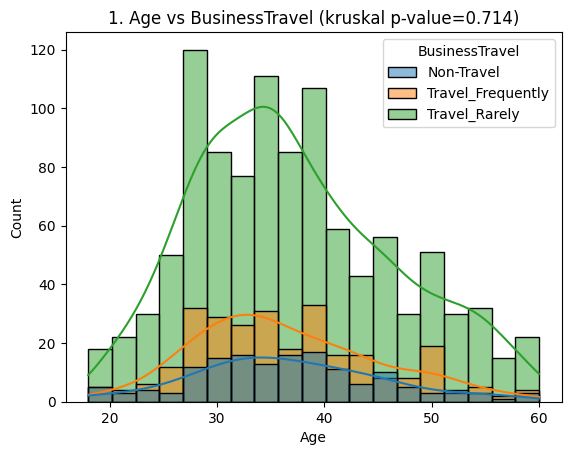

2. Age vs Education (kruskal p-value=0.0)


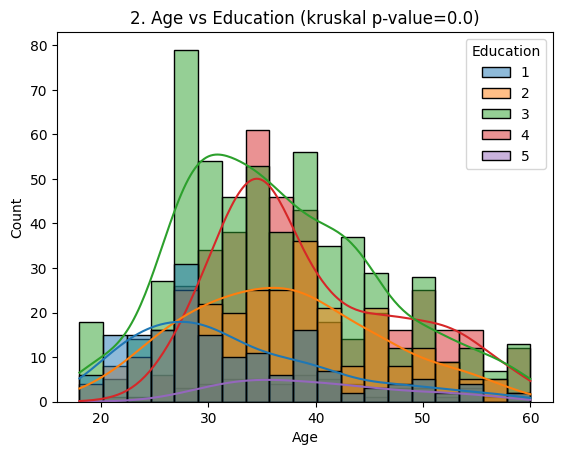

3. Age vs EnvironmentSatisfaction (kruskal p-value=0.87)


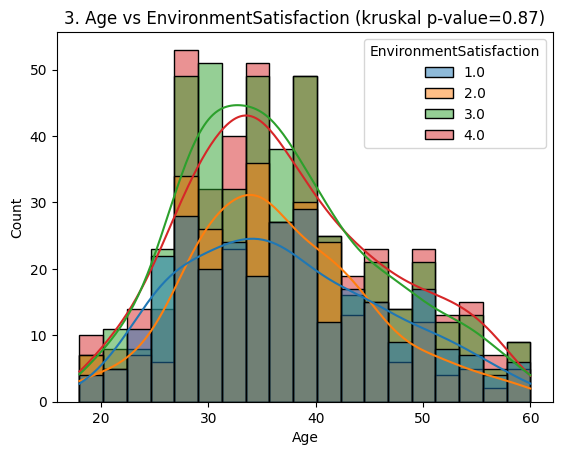

4. Age vs JobInvolvement (kruskal p-value=0.356)


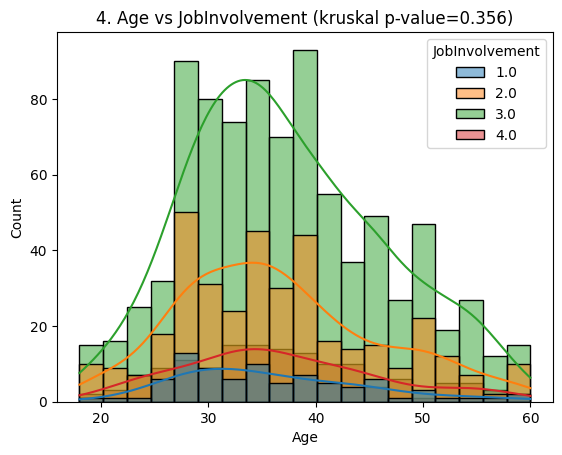

5. Age vs JobLevel (kruskal p-value=0.0)


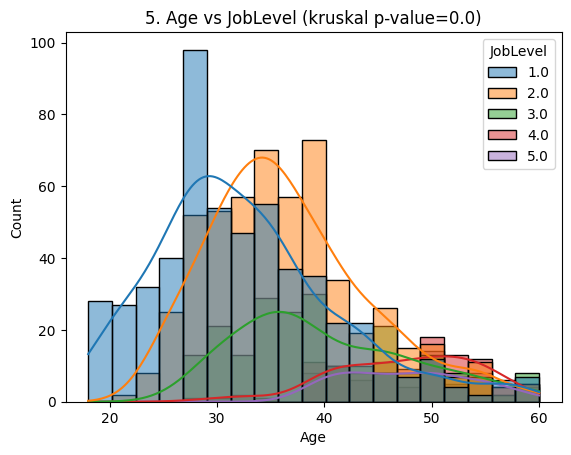

6. Age vs JobSatisfaction (kruskal p-value=0.956)


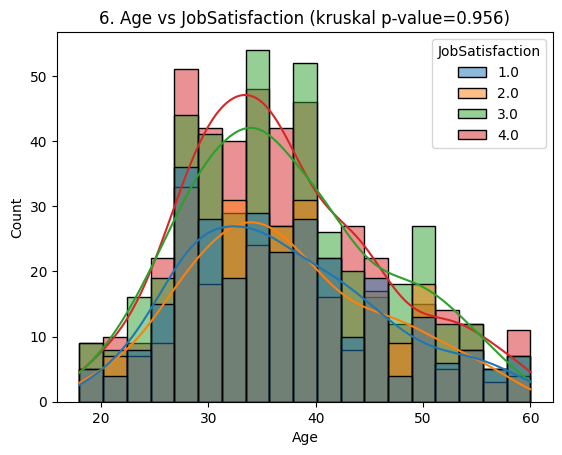

7. Age vs PerformanceRating(mannwhitneyu p-value=0.997)


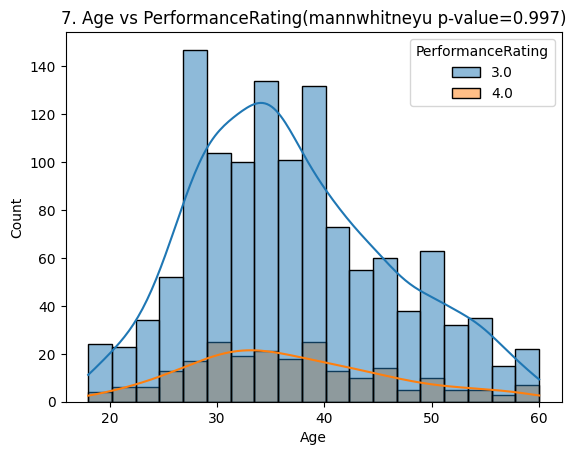

8. Age vs RelationshipSatisfaction (kruskal p-value=0.354)


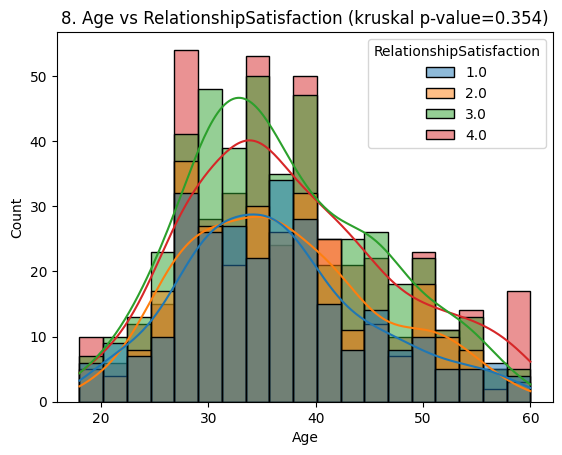

9. Age vs StockOptionLevel (kruskal p-value=0.001)


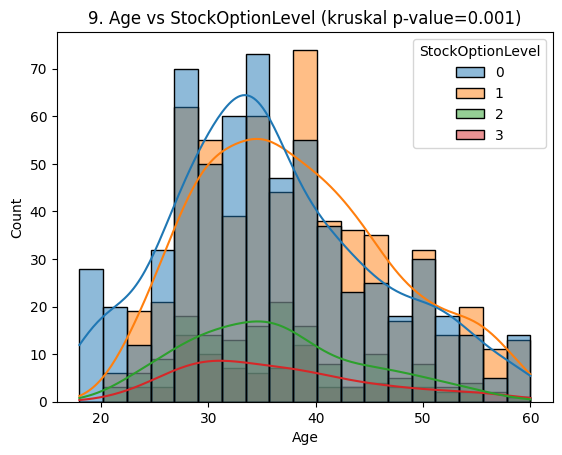

10. Age vs WorkLifeBalance (kruskal p-value=0.997)


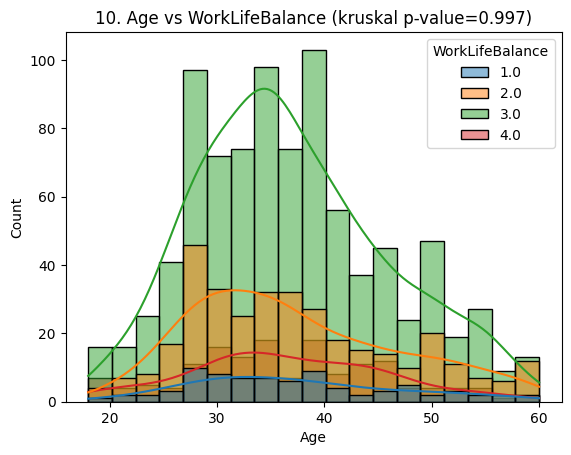

12. Age vs Department (kruskal p-value=0.452)


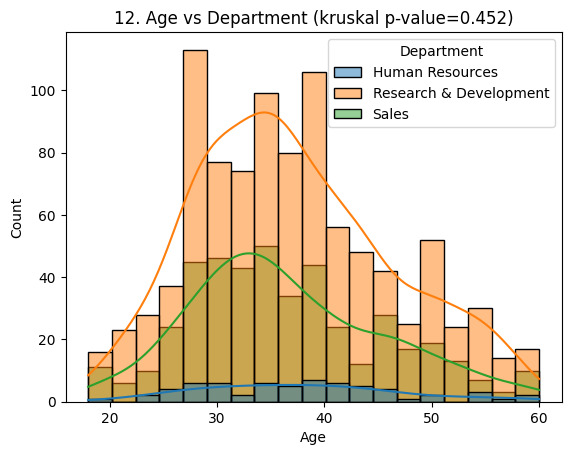

13. Age vs EducationField (kruskal p-value=0.304)


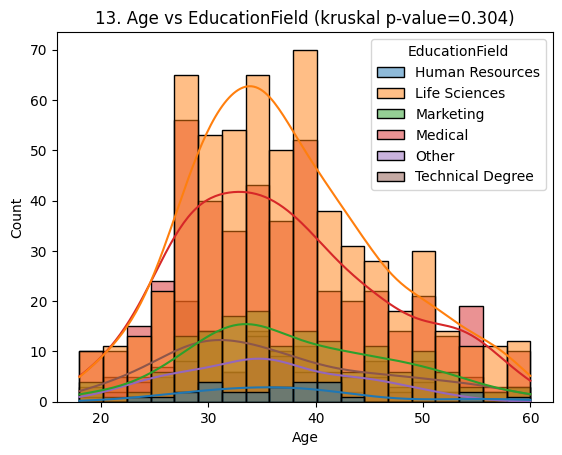

14. Age vs Gender(mannwhitneyu p-value=0.167)


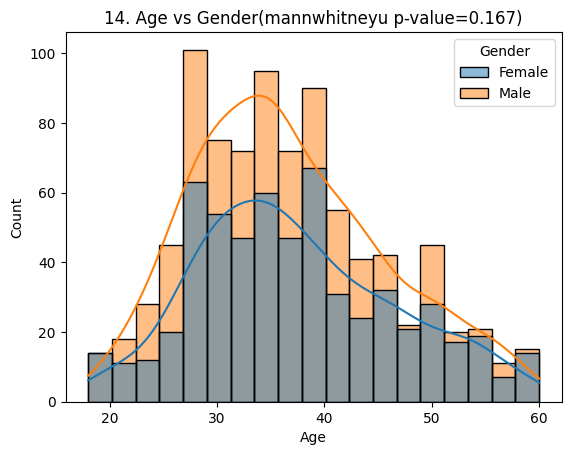

15. Age vs JobRole (kruskal p-value=0.0)


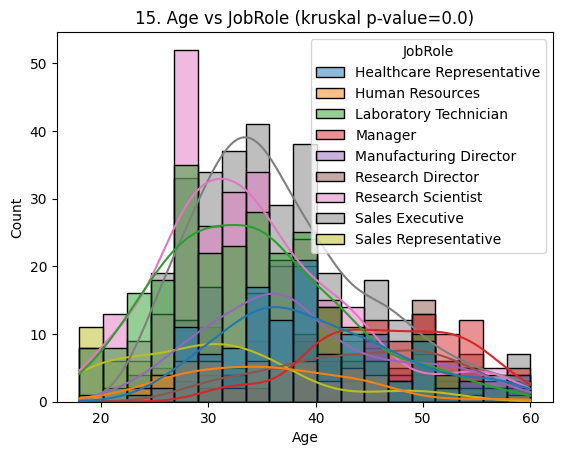

16. Age vs MaritalStatus (kruskal p-value=0.0)


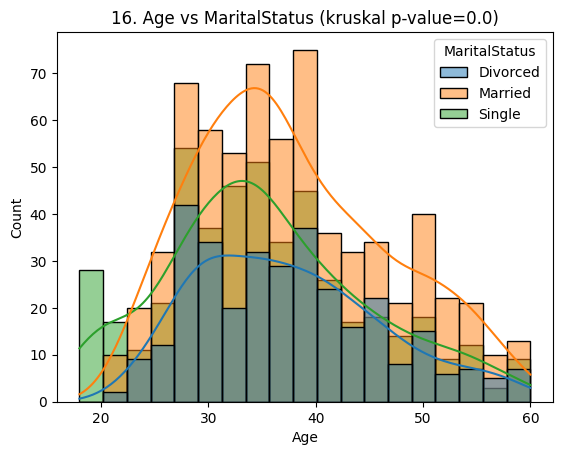

17. Age vs OverTime(mannwhitneyu p-value=0.3)


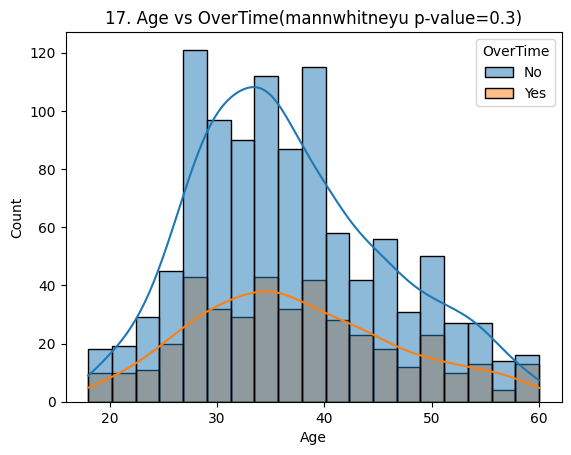

19. DailyRate vs BusinessTravel (kruskal p-value=0.828)


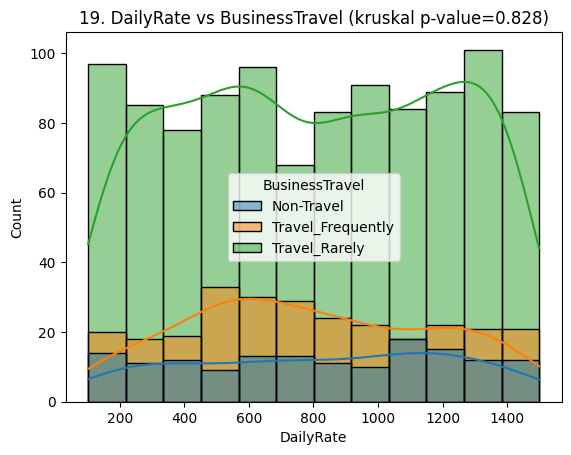

20. DailyRate vs Education (kruskal p-value=0.586)


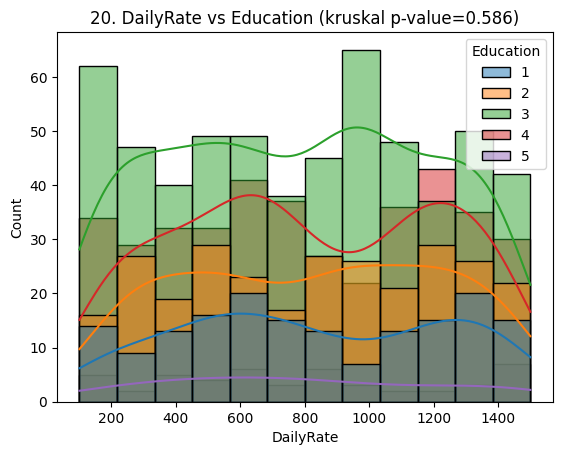

21. DailyRate vs EnvironmentSatisfaction (kruskal p-value=0.899)


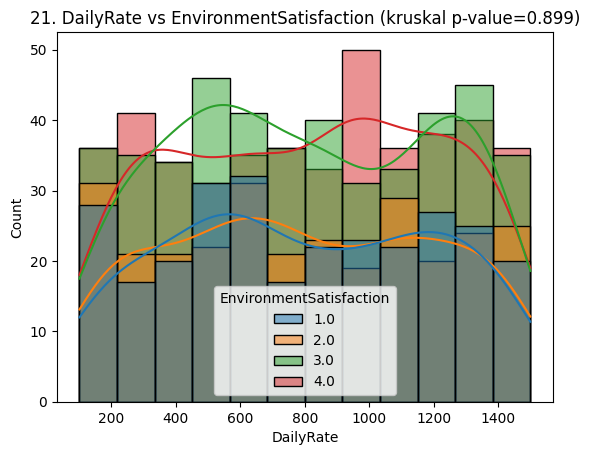

22. DailyRate vs JobInvolvement (kruskal p-value=0.235)


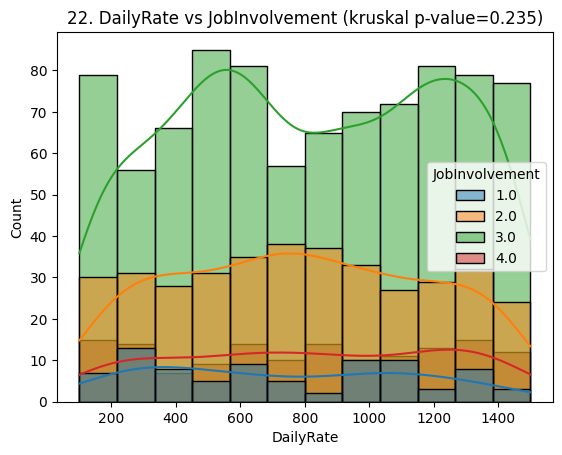

23. DailyRate vs JobLevel (kruskal p-value=0.774)


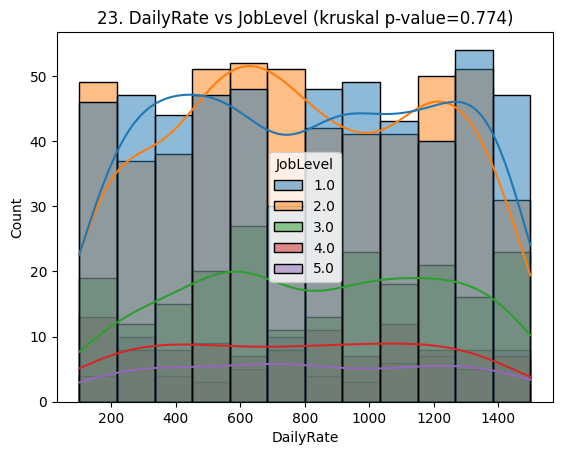

24. DailyRate vs JobSatisfaction (kruskal p-value=0.149)


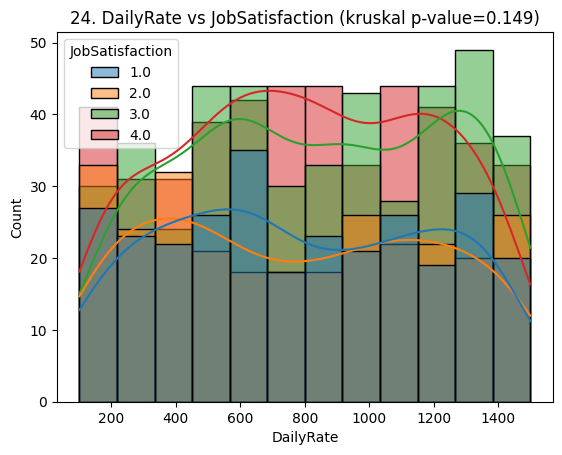

25. DailyRate vs PerformanceRating(mannwhitneyu p-value=0.981)


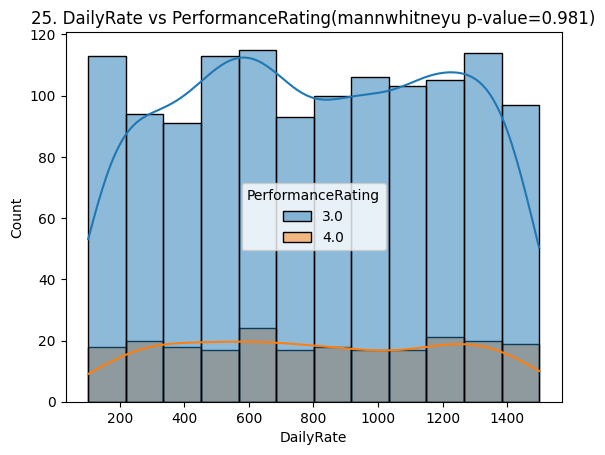

26. DailyRate vs RelationshipSatisfaction (kruskal p-value=0.736)


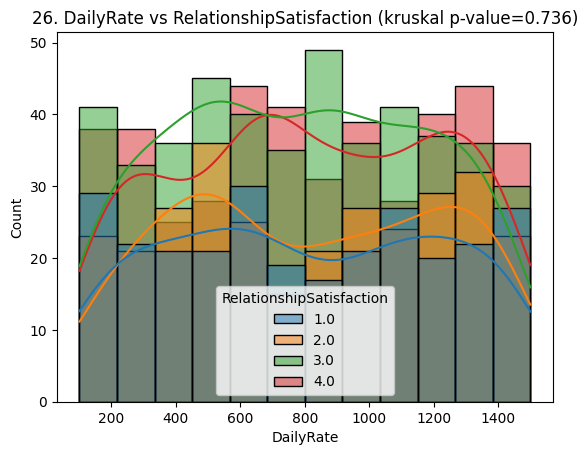

27. DailyRate vs StockOptionLevel (kruskal p-value=0.232)


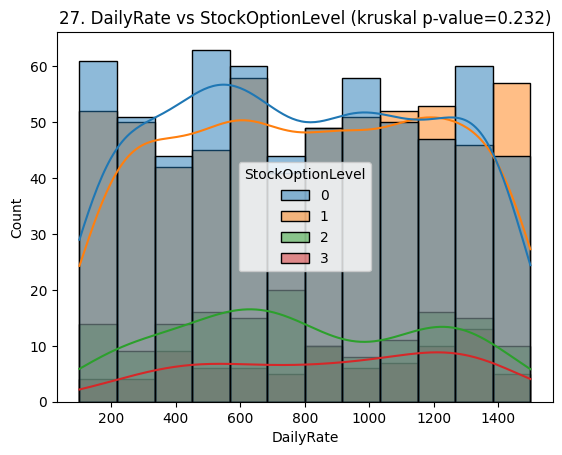

28. DailyRate vs WorkLifeBalance (kruskal p-value=0.43)


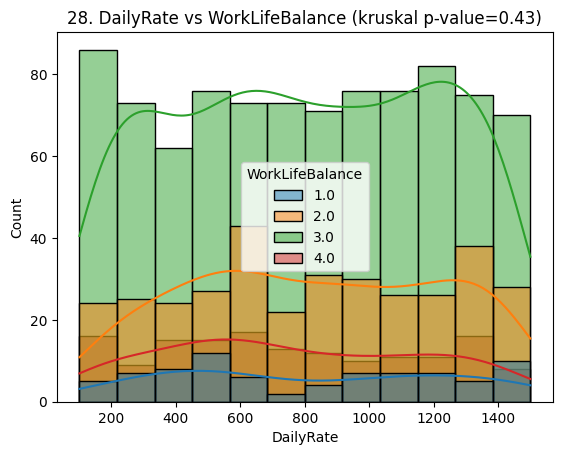

30. DailyRate vs Department (kruskal p-value=0.564)


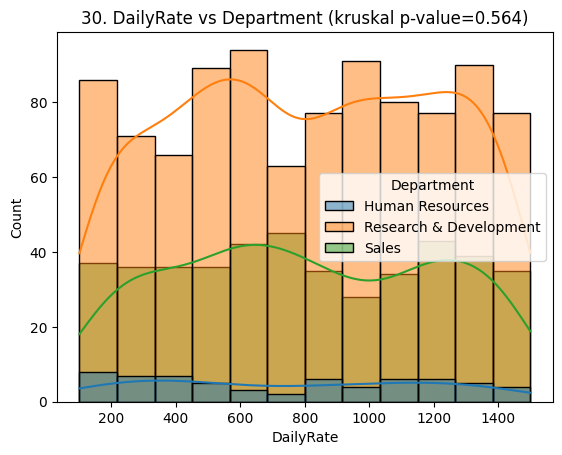

31. DailyRate vs EducationField (kruskal p-value=0.062)


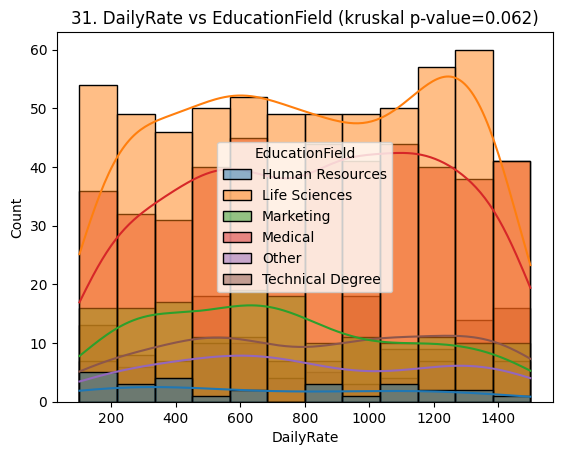

32. DailyRate vs Gender(mannwhitneyu p-value=0.662)


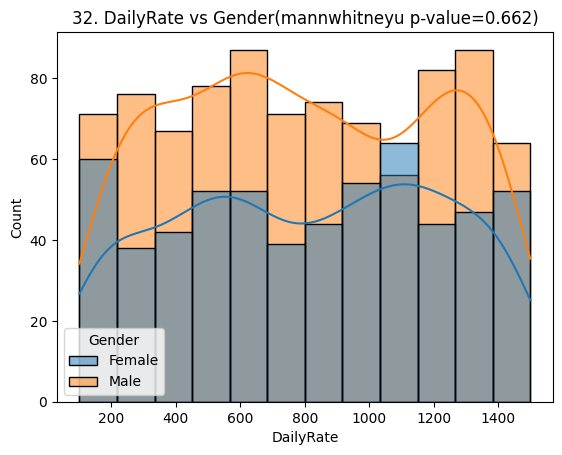

33. DailyRate vs JobRole (kruskal p-value=0.922)


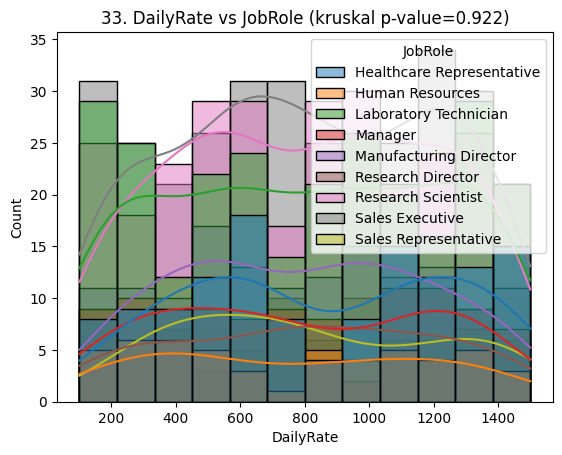

34. DailyRate vs MaritalStatus (kruskal p-value=0.013)


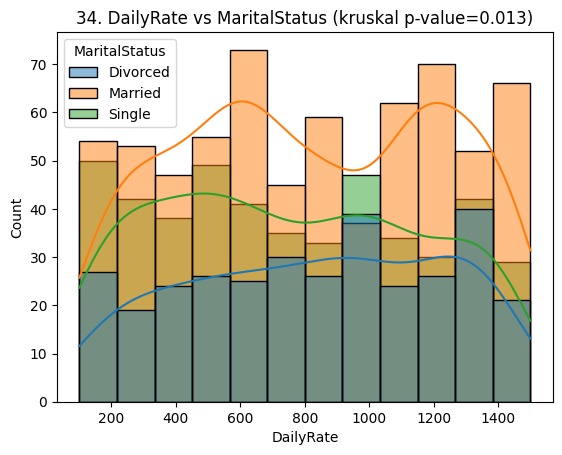

35. DailyRate vs OverTime(mannwhitneyu p-value=0.748)


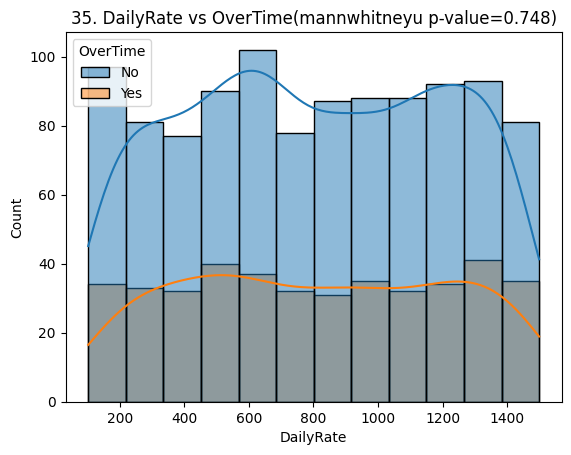

37. DistanceFromHome vs BusinessTravel (kruskal p-value=0.791)


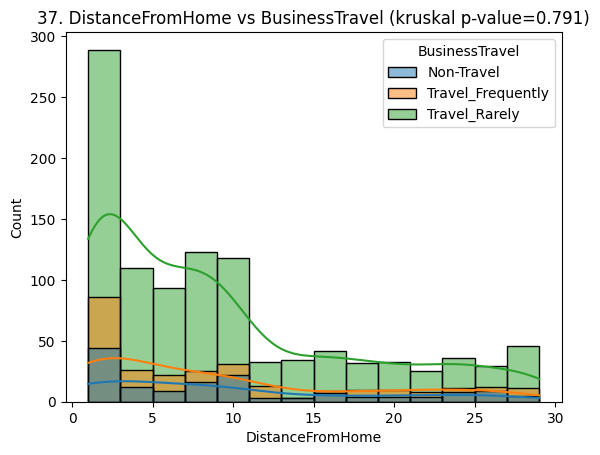

38. DistanceFromHome vs Education (kruskal p-value=0.768)


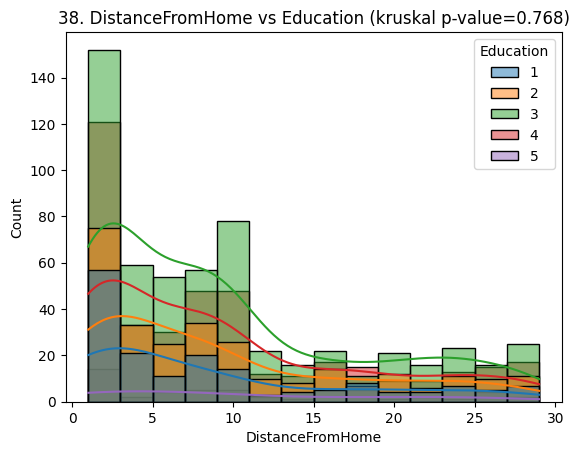

39. DistanceFromHome vs EnvironmentSatisfaction (kruskal p-value=0.742)


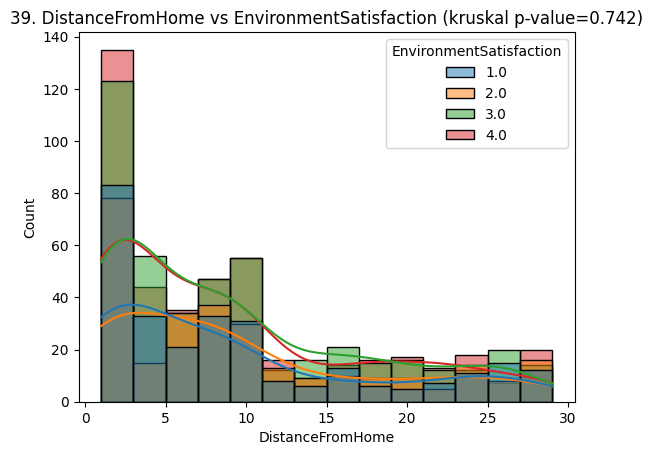

40. DistanceFromHome vs JobInvolvement (kruskal p-value=0.503)


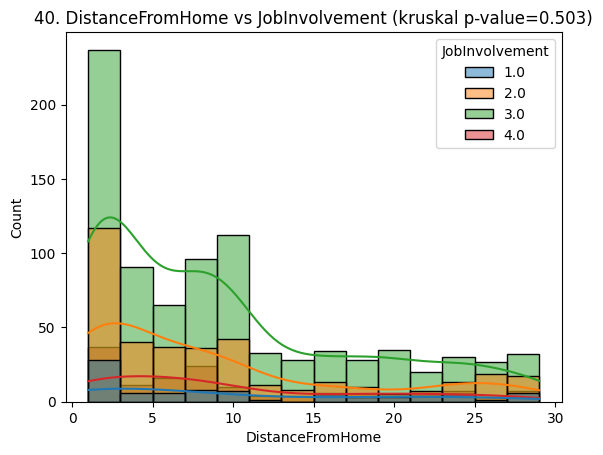

41. DistanceFromHome vs JobLevel (kruskal p-value=0.016)


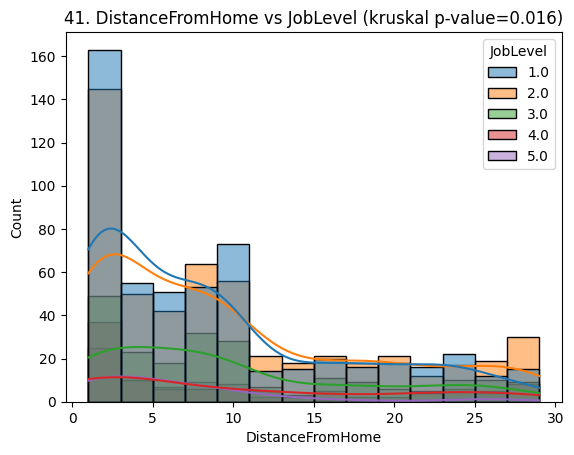

42. DistanceFromHome vs JobSatisfaction (kruskal p-value=0.696)


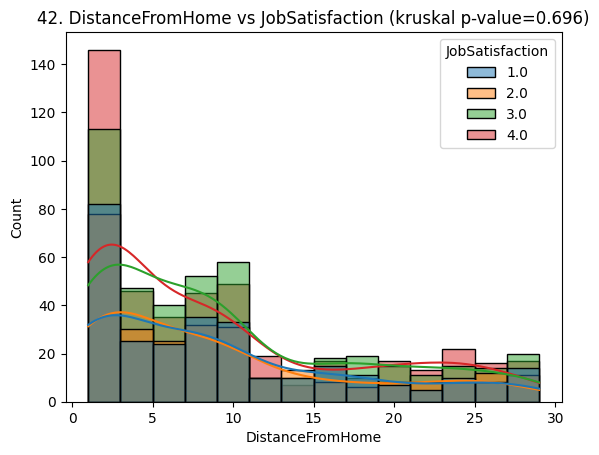

43. DistanceFromHome vs PerformanceRating(mannwhitneyu p-value=0.664)


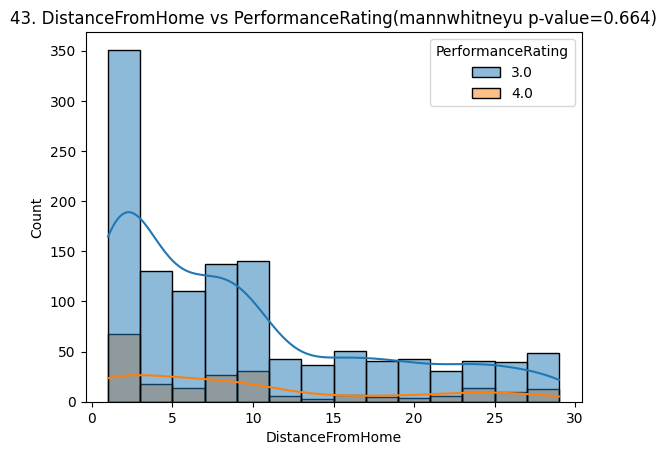

44. DistanceFromHome vs RelationshipSatisfaction (kruskal p-value=0.602)


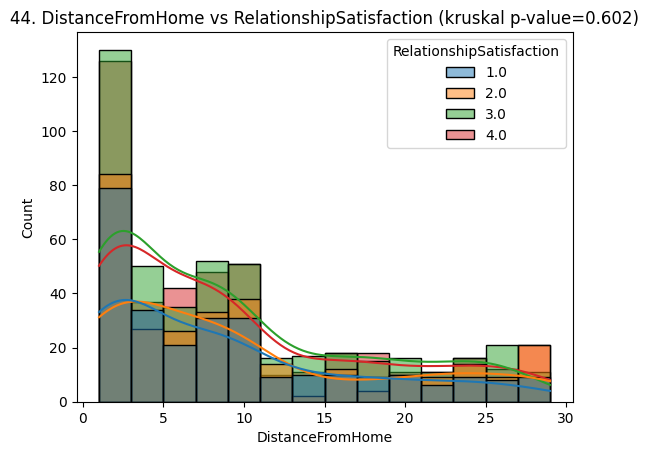

45. DistanceFromHome vs StockOptionLevel (kruskal p-value=0.043)


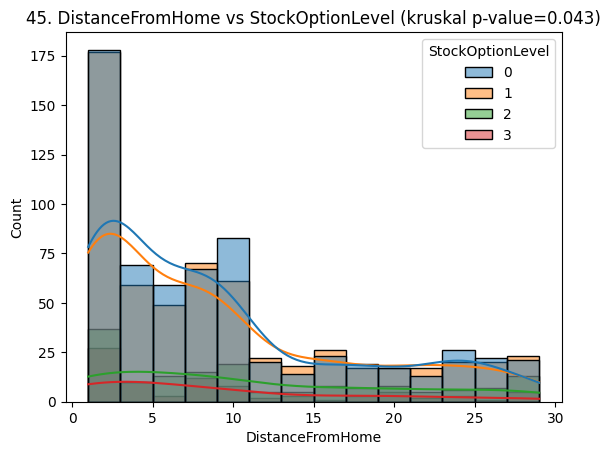

46. DistanceFromHome vs WorkLifeBalance (kruskal p-value=0.527)


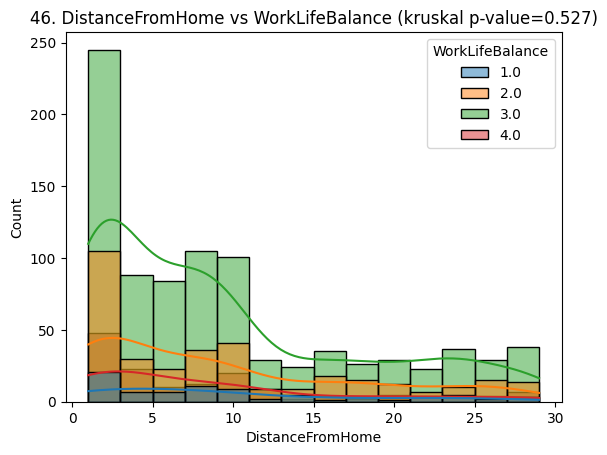

48. DistanceFromHome vs Department (kruskal p-value=0.498)


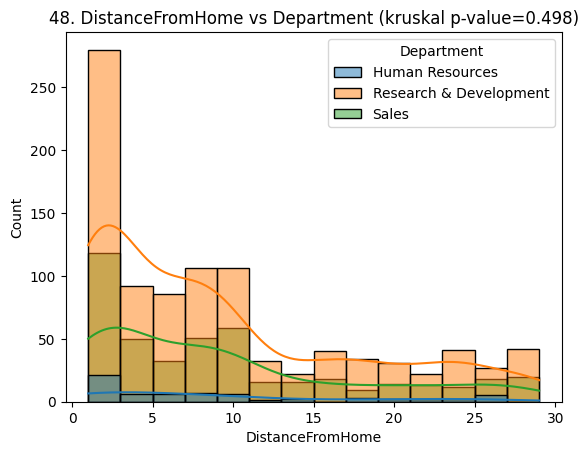

49. DistanceFromHome vs EducationField (kruskal p-value=0.253)


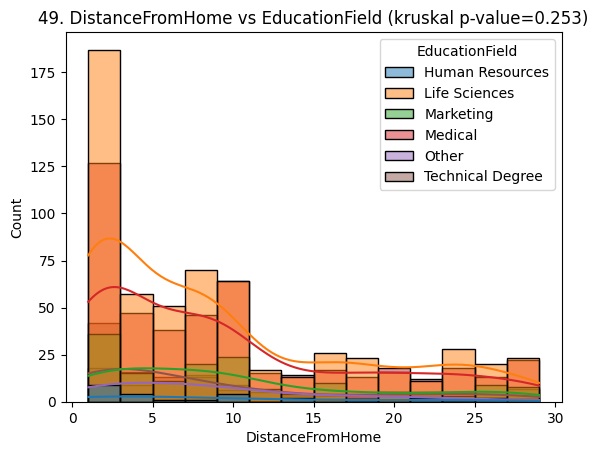

50. DistanceFromHome vs Gender(mannwhitneyu p-value=0.867)


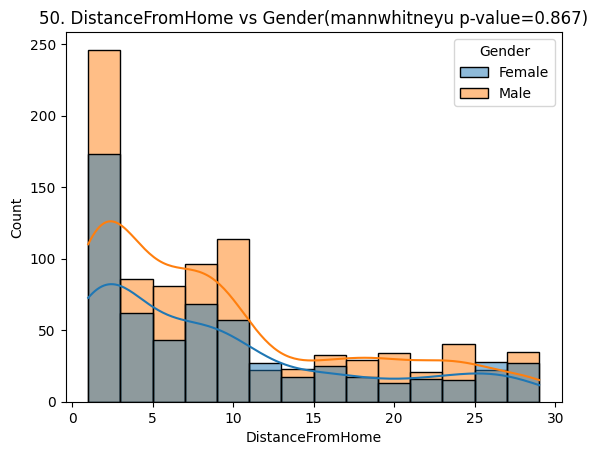

51. DistanceFromHome vs JobRole (kruskal p-value=0.398)


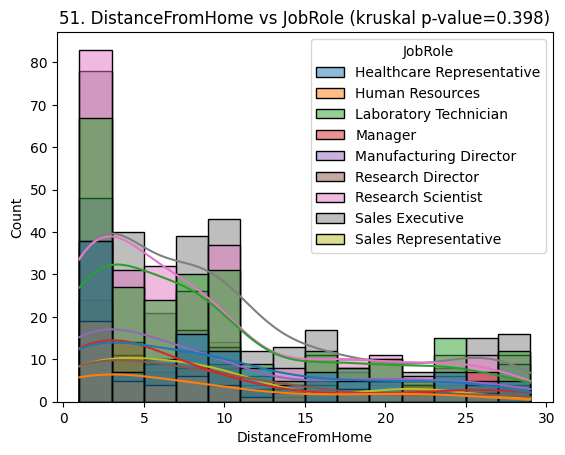

52. DistanceFromHome vs MaritalStatus (kruskal p-value=0.602)


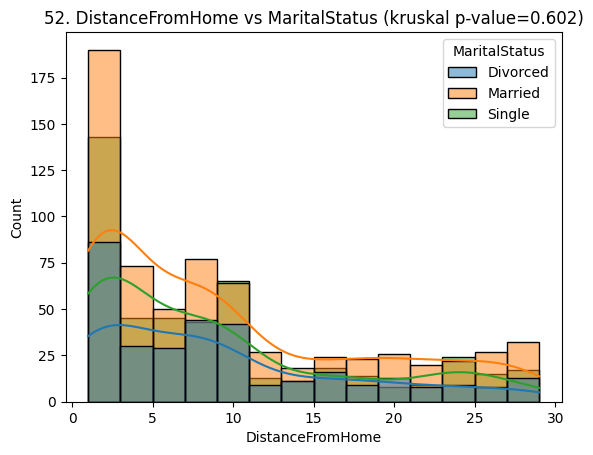

53. DistanceFromHome vs OverTime(mannwhitneyu p-value=0.16)


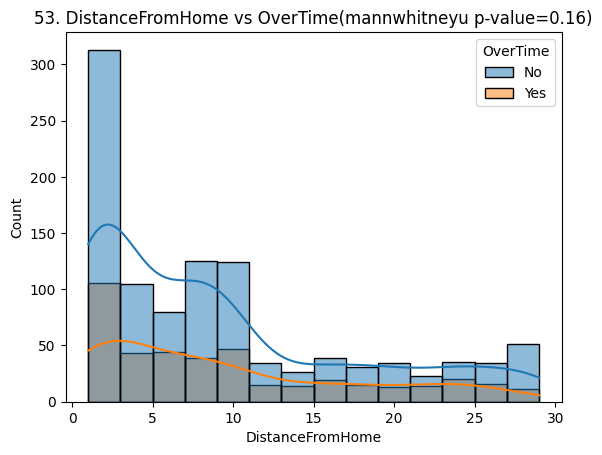

55. HourlyRate vs BusinessTravel (kruskal p-value=0.559)


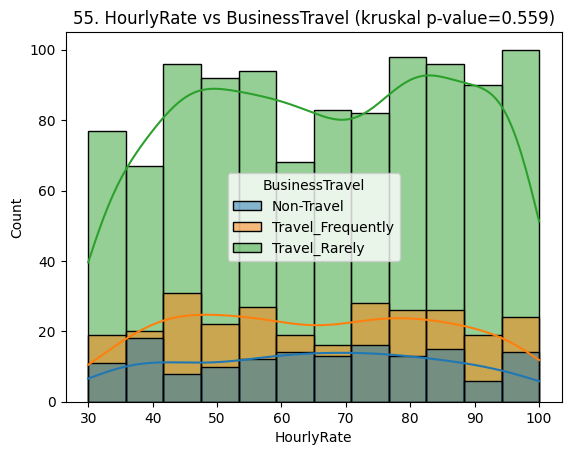

56. HourlyRate vs Education (kruskal p-value=0.872)


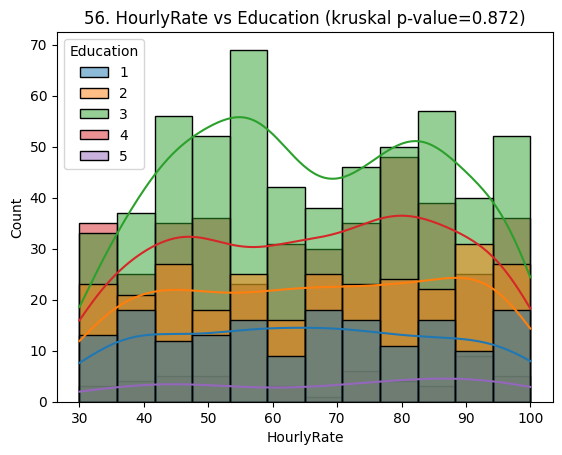

57. HourlyRate vs EnvironmentSatisfaction (kruskal p-value=0.173)


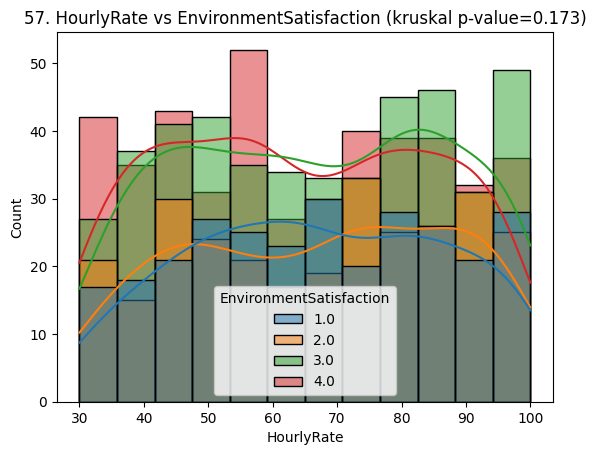

58. HourlyRate vs JobInvolvement (kruskal p-value=0.339)


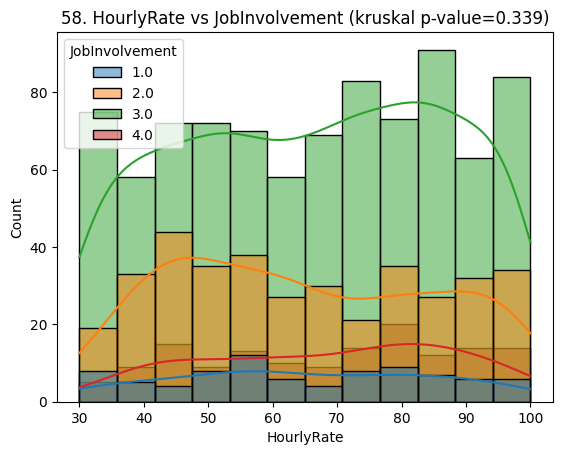

59. HourlyRate vs JobLevel (kruskal p-value=0.637)


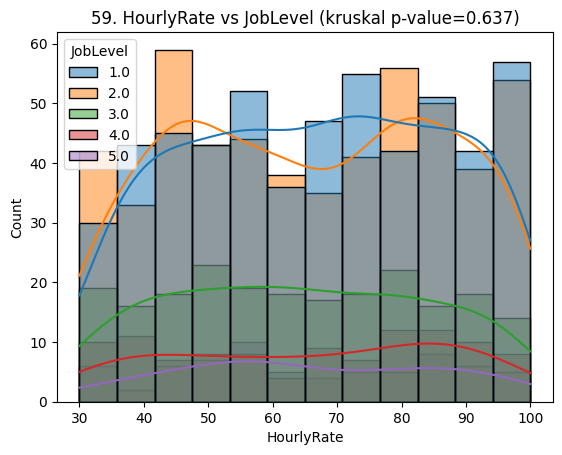

60. HourlyRate vs JobSatisfaction (kruskal p-value=0.04)


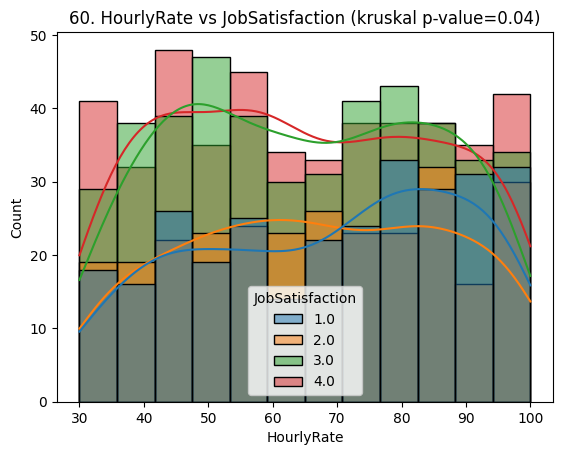

61. HourlyRate vs PerformanceRating(mannwhitneyu p-value=0.933)


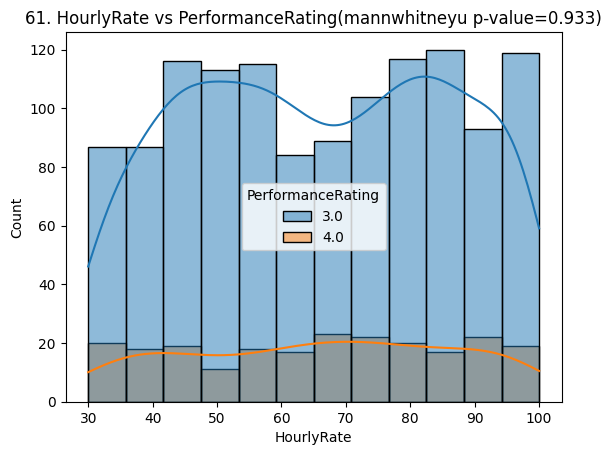

62. HourlyRate vs RelationshipSatisfaction (kruskal p-value=0.293)


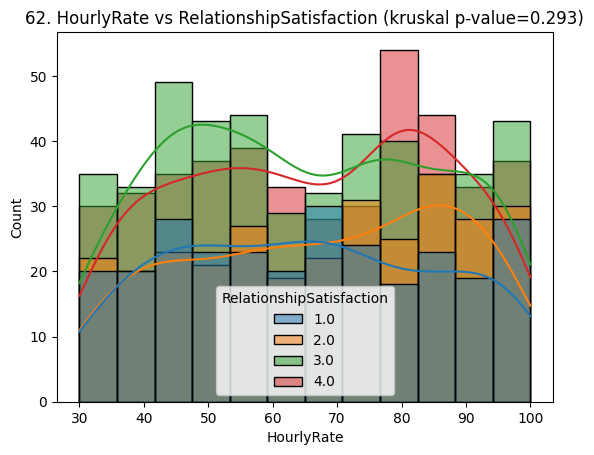

63. HourlyRate vs StockOptionLevel (kruskal p-value=0.089)


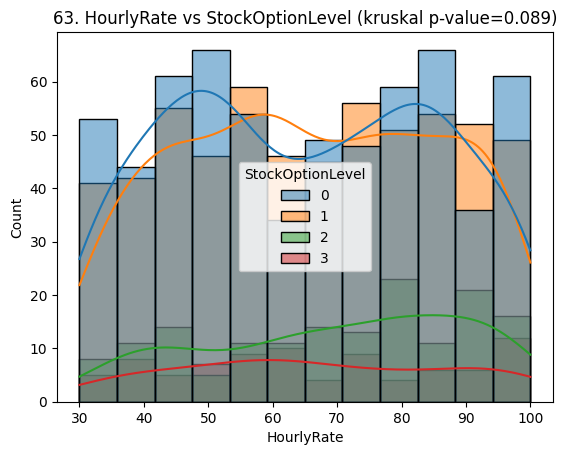

64. HourlyRate vs WorkLifeBalance (kruskal p-value=0.576)


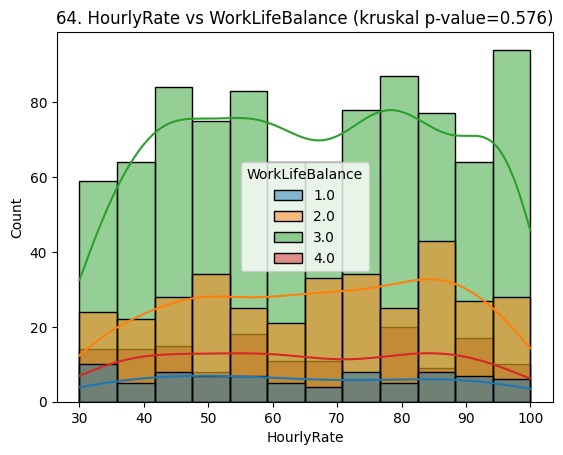

66. HourlyRate vs Department (kruskal p-value=0.722)


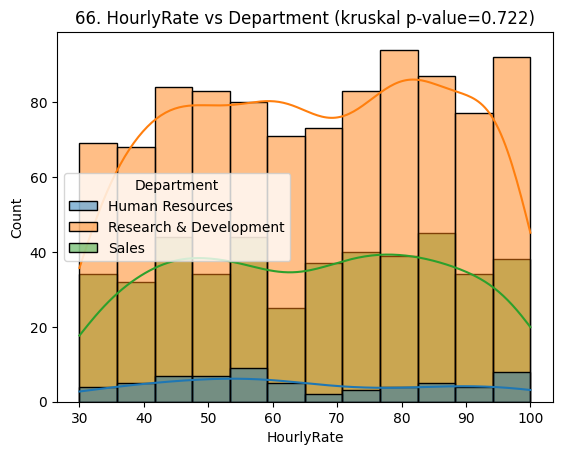

67. HourlyRate vs EducationField (kruskal p-value=0.319)


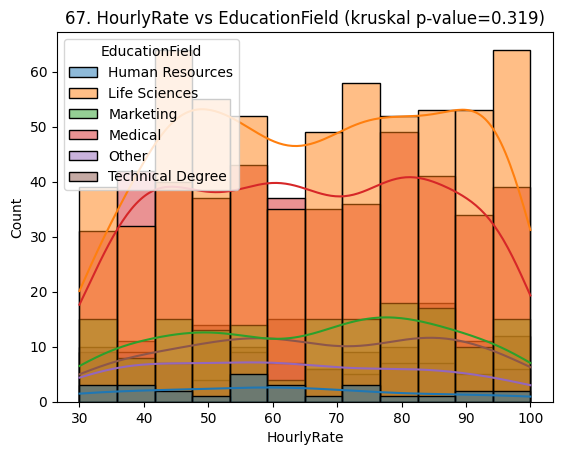

68. HourlyRate vs Gender(mannwhitneyu p-value=0.992)


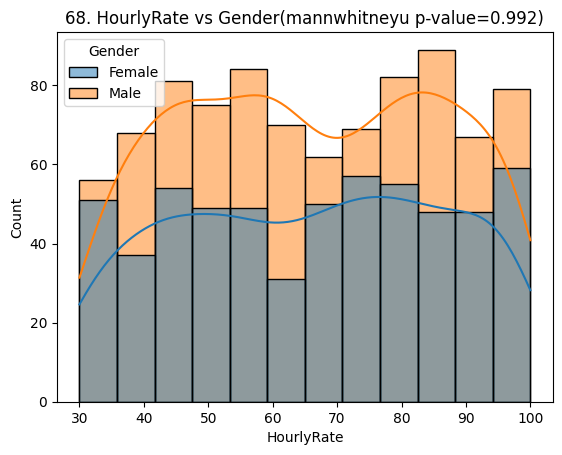

69. HourlyRate vs JobRole (kruskal p-value=0.9)


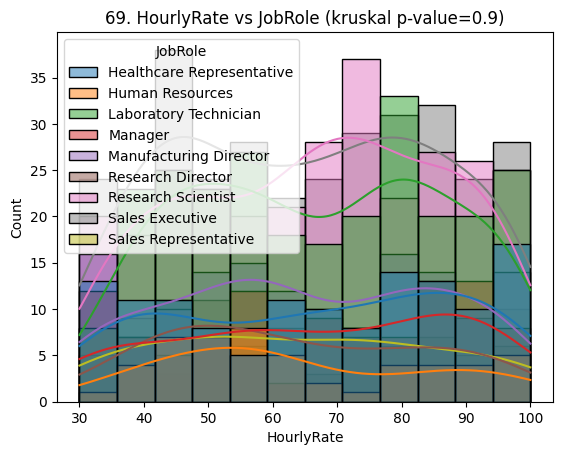

70. HourlyRate vs MaritalStatus (kruskal p-value=0.351)


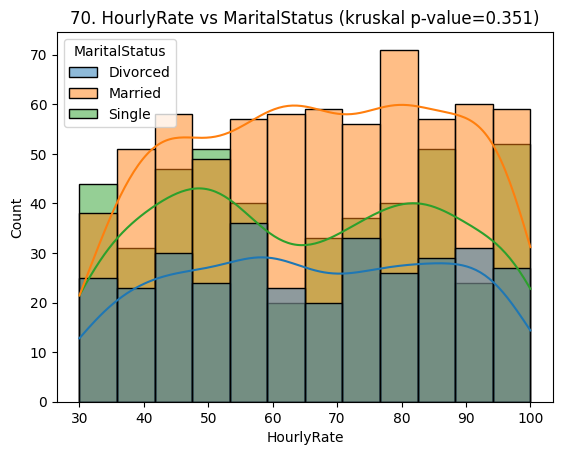

71. HourlyRate vs OverTime(mannwhitneyu p-value=0.726)


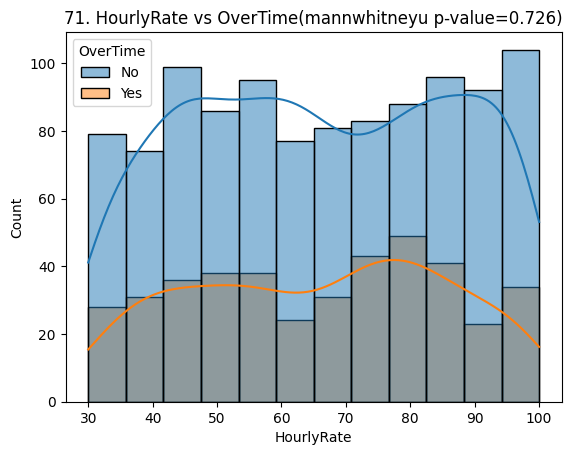

73. MonthlyIncome vs BusinessTravel (kruskal p-value=0.532)


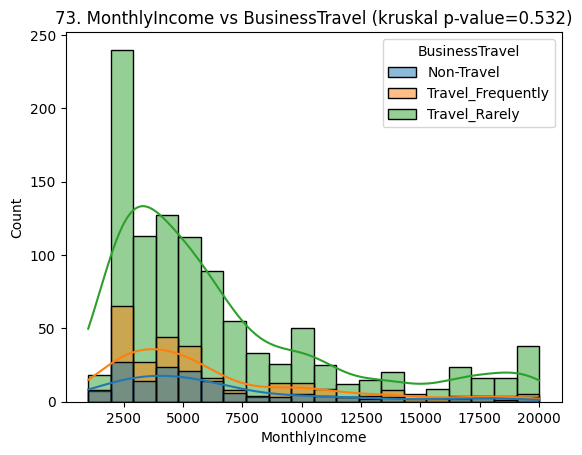

74. MonthlyIncome vs Education (kruskal p-value=0.0)


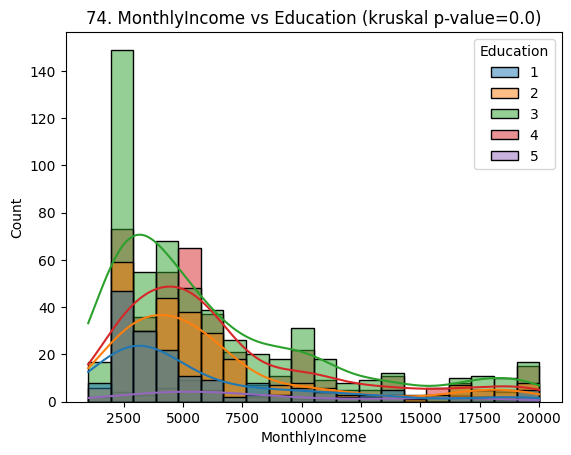

75. MonthlyIncome vs EnvironmentSatisfaction (kruskal p-value=0.884)


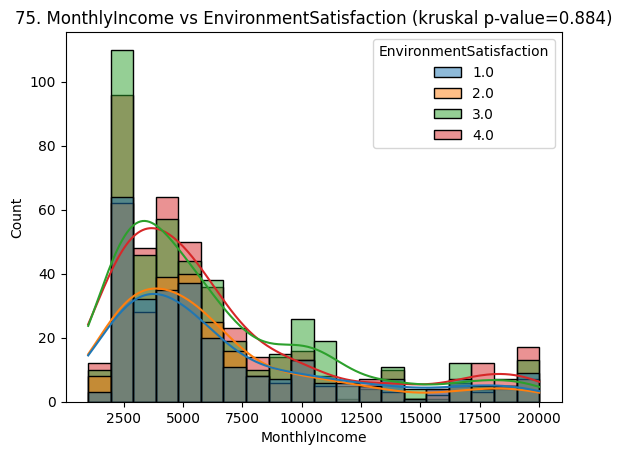

76. MonthlyIncome vs JobInvolvement (kruskal p-value=0.811)


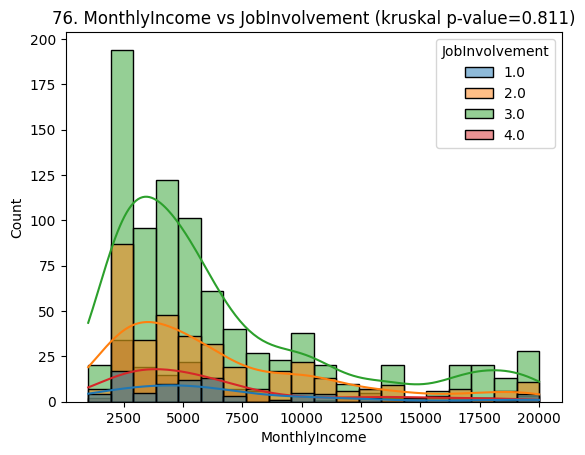

77. MonthlyIncome vs JobLevel (kruskal p-value=0.0)


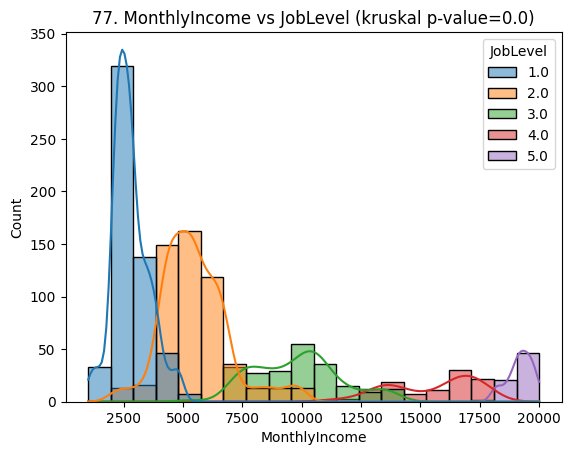

78. MonthlyIncome vs JobSatisfaction (kruskal p-value=0.858)


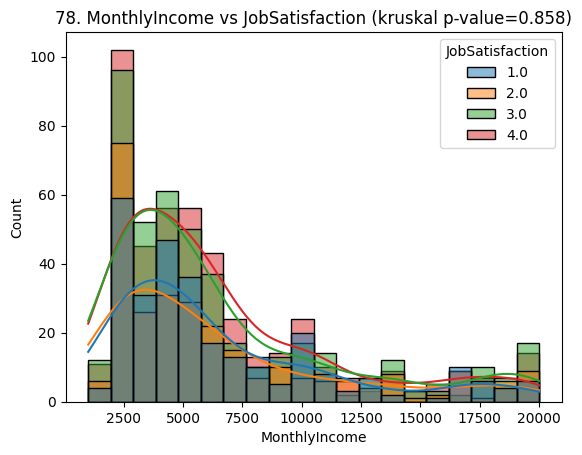

79. MonthlyIncome vs PerformanceRating(mannwhitneyu p-value=0.301)


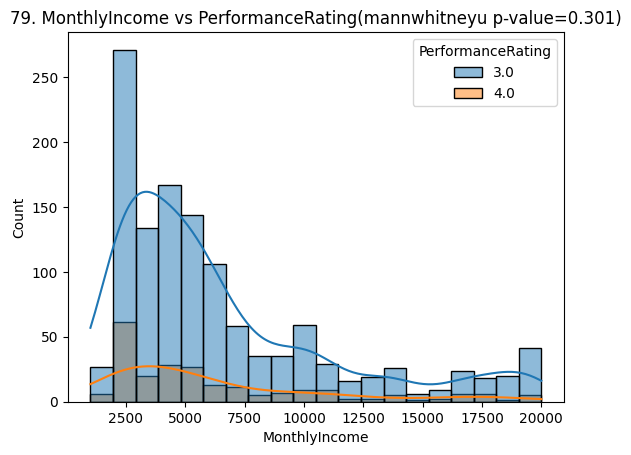

80. MonthlyIncome vs RelationshipSatisfaction (kruskal p-value=0.981)


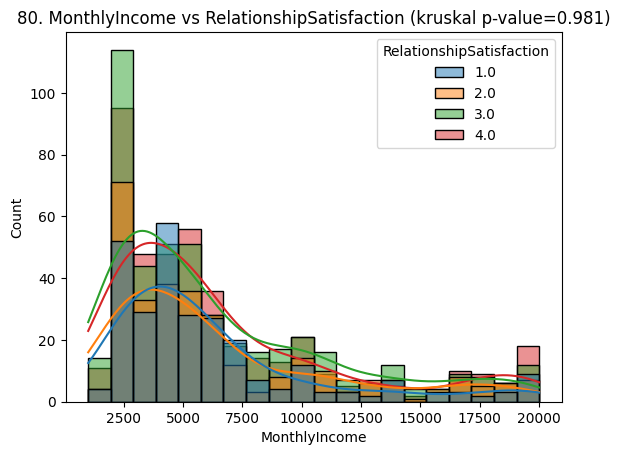

81. MonthlyIncome vs StockOptionLevel (kruskal p-value=0.009)


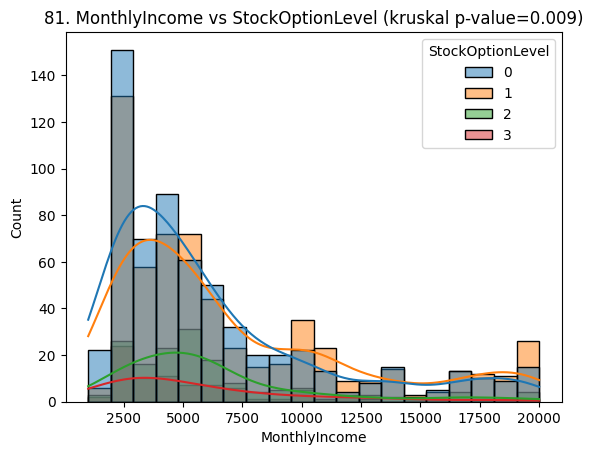

82. MonthlyIncome vs WorkLifeBalance (kruskal p-value=0.567)


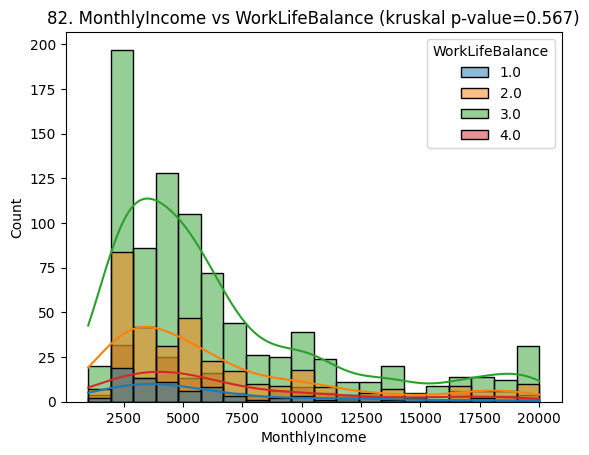

84. MonthlyIncome vs Department (kruskal p-value=0.0)


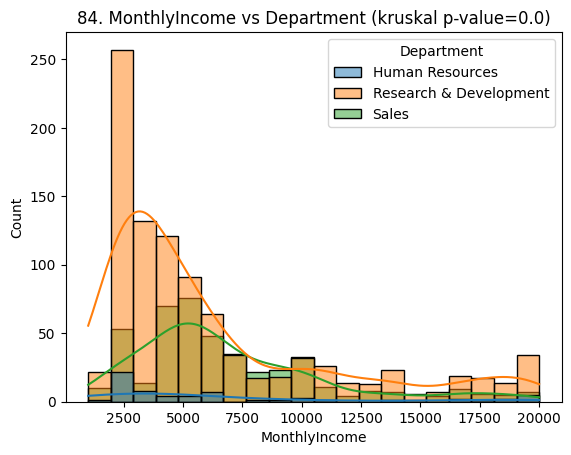

85. MonthlyIncome vs EducationField (kruskal p-value=0.0)


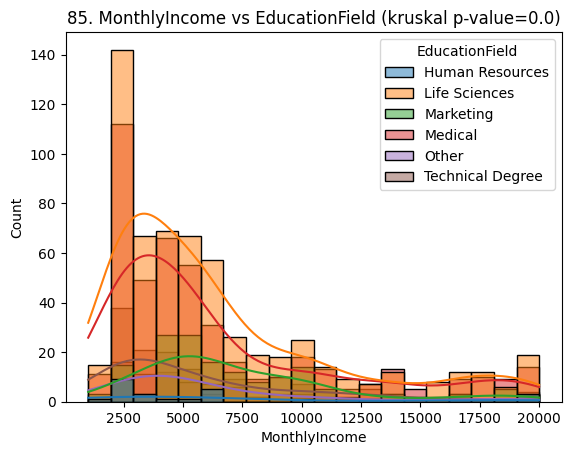

86. MonthlyIncome vs Gender(mannwhitneyu p-value=0.088)


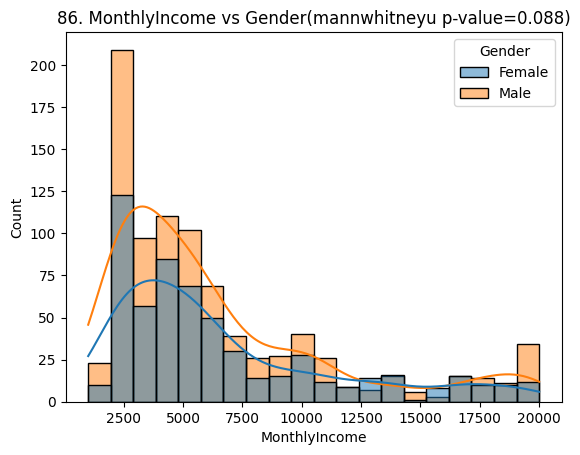

87. MonthlyIncome vs JobRole (kruskal p-value=0.0)


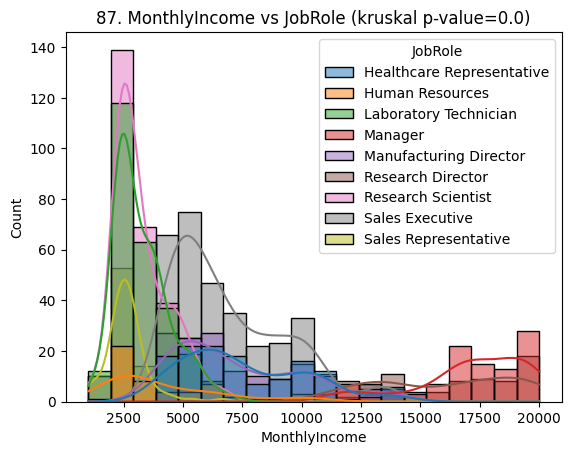

88. MonthlyIncome vs MaritalStatus (kruskal p-value=0.002)


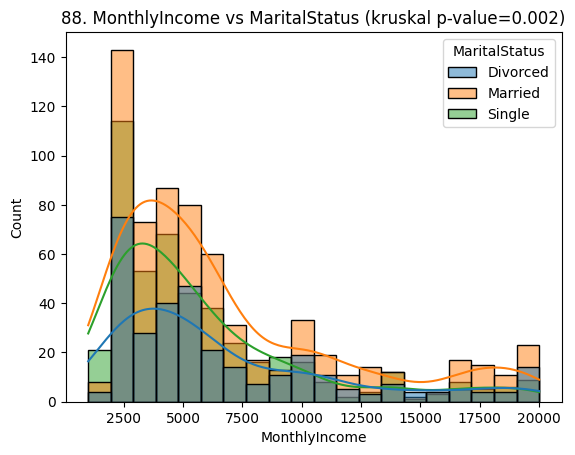

89. MonthlyIncome vs OverTime(mannwhitneyu p-value=0.733)


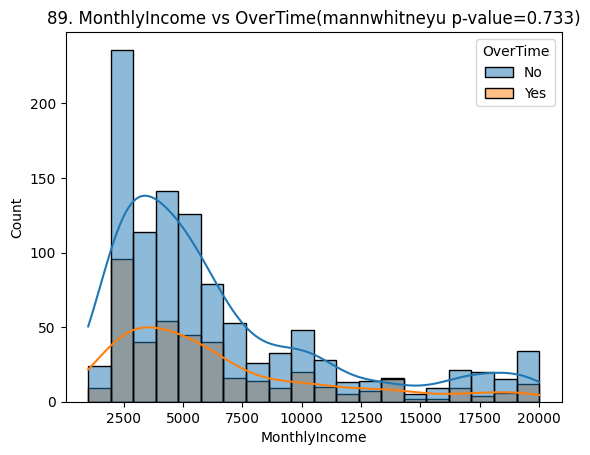

91. MonthlyRate vs BusinessTravel (kruskal p-value=0.837)


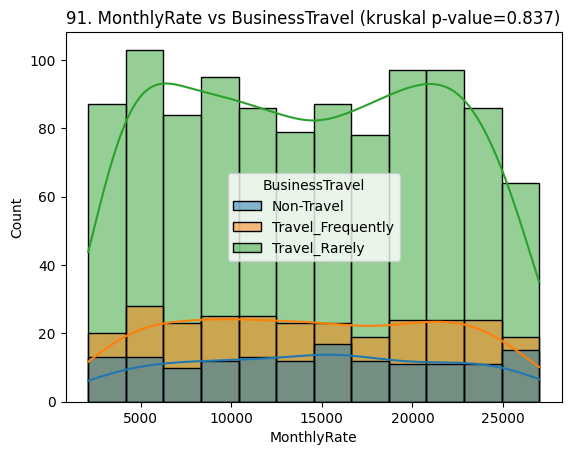

92. MonthlyRate vs Education (kruskal p-value=0.513)


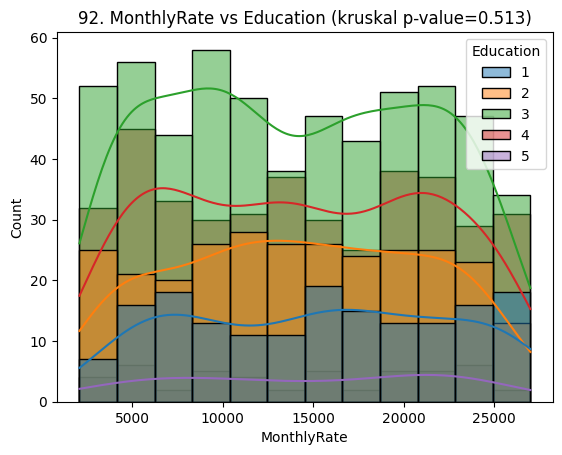

93. MonthlyRate vs EnvironmentSatisfaction (kruskal p-value=0.27)


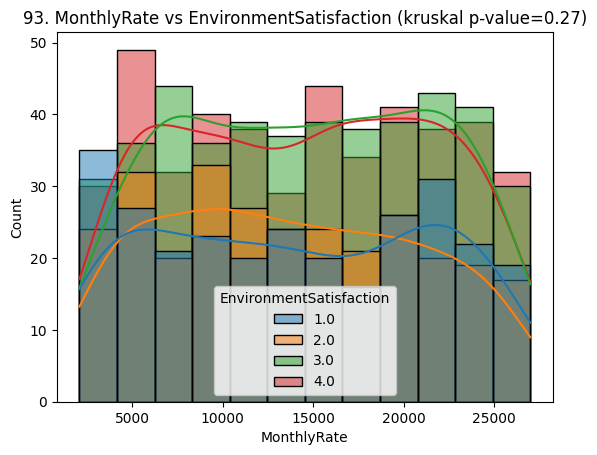

94. MonthlyRate vs JobInvolvement (kruskal p-value=0.599)


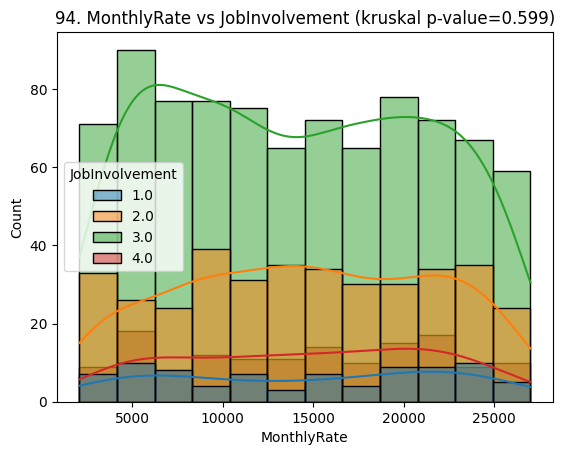

95. MonthlyRate vs JobLevel (kruskal p-value=0.132)


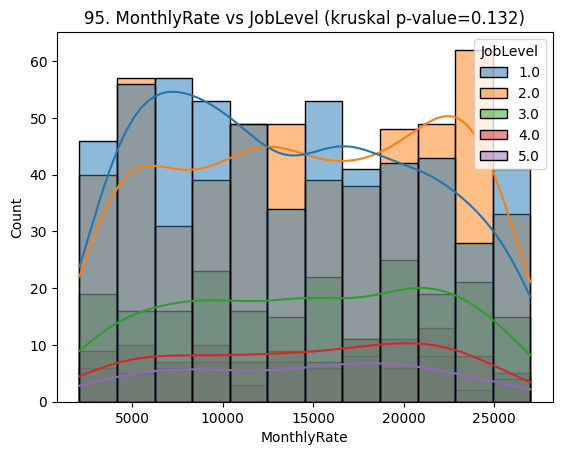

96. MonthlyRate vs JobSatisfaction (kruskal p-value=0.676)


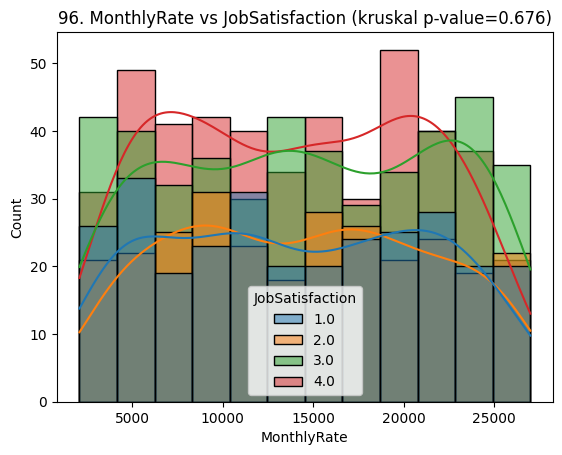

97. MonthlyRate vs PerformanceRating(mannwhitneyu p-value=0.71)


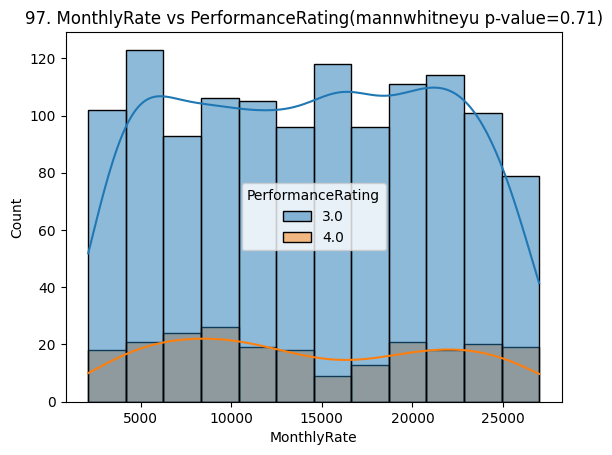

98. MonthlyRate vs RelationshipSatisfaction (kruskal p-value=0.319)


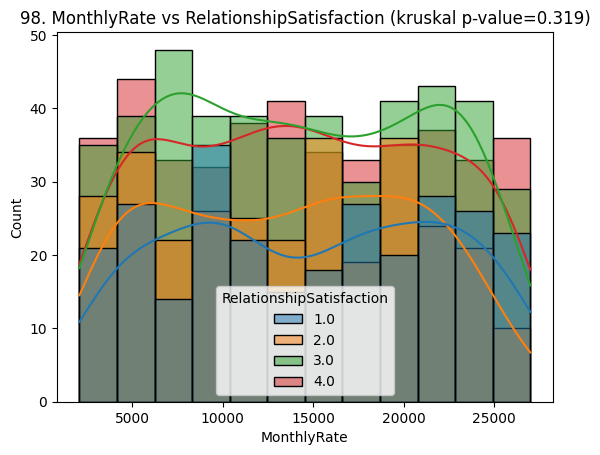

99. MonthlyRate vs StockOptionLevel (kruskal p-value=0.344)


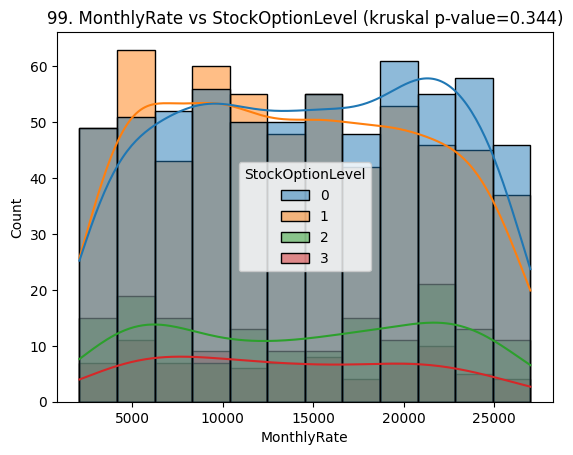

100. MonthlyRate vs WorkLifeBalance (kruskal p-value=0.726)


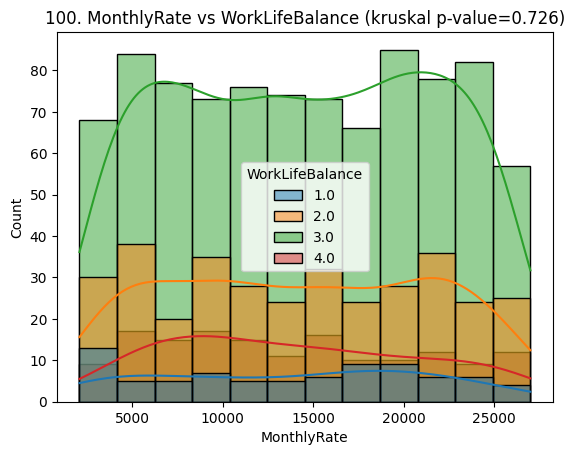

102. MonthlyRate vs Department (kruskal p-value=0.566)


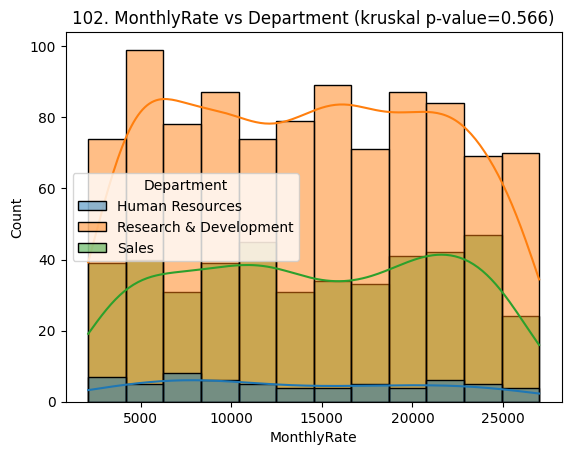

103. MonthlyRate vs EducationField (kruskal p-value=0.766)


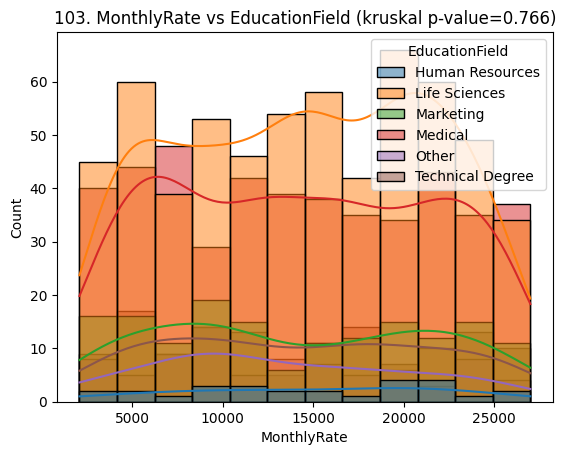

104. MonthlyRate vs Gender(mannwhitneyu p-value=0.109)


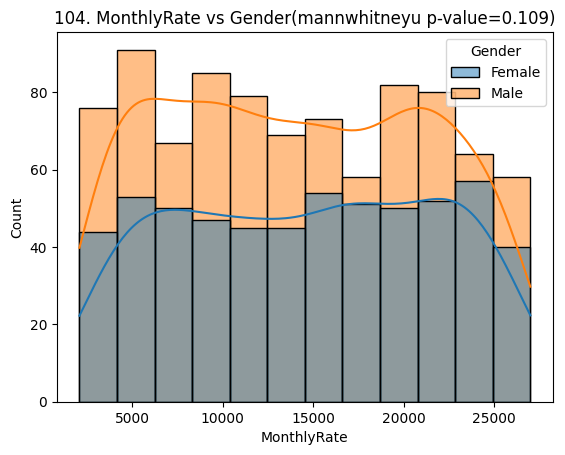

105. MonthlyRate vs JobRole (kruskal p-value=0.786)


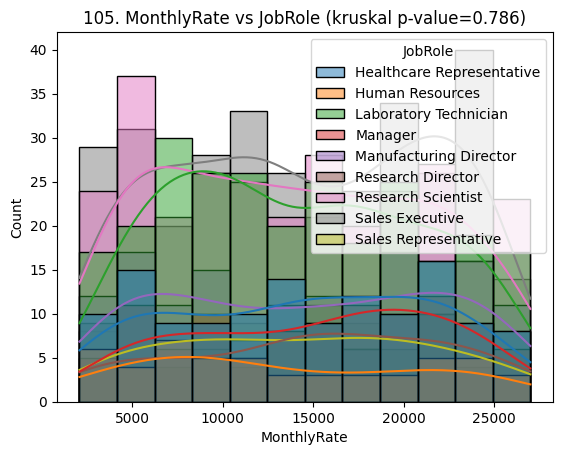

106. MonthlyRate vs MaritalStatus (kruskal p-value=0.308)


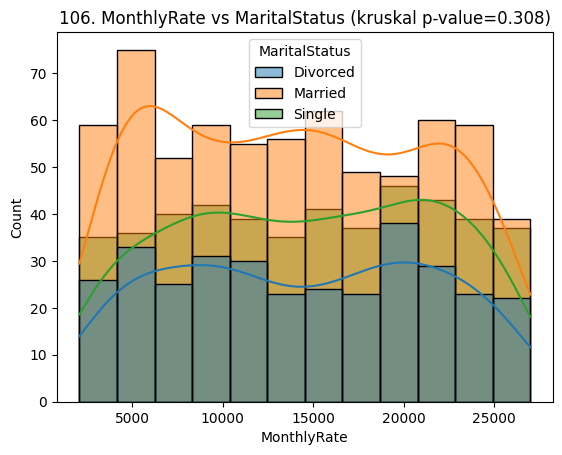

107. MonthlyRate vs OverTime(mannwhitneyu p-value=0.419)


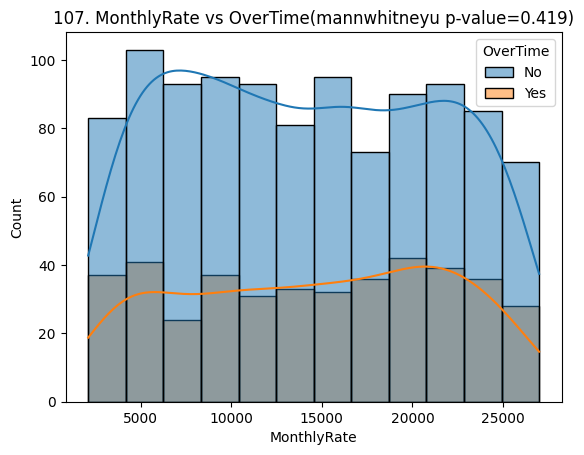

109. NumCompaniesWorked vs BusinessTravel (kruskal p-value=0.203)


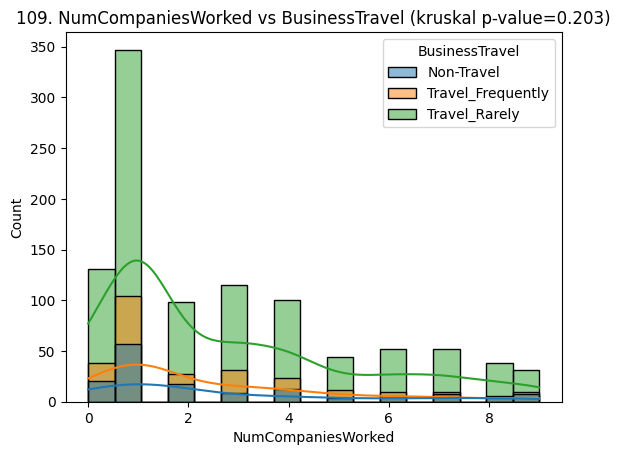

110. NumCompaniesWorked vs Education (kruskal p-value=0.0)


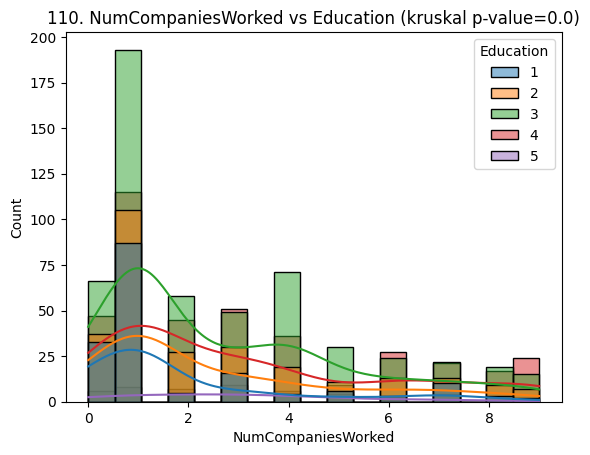

111. NumCompaniesWorked vs EnvironmentSatisfaction (kruskal p-value=0.225)


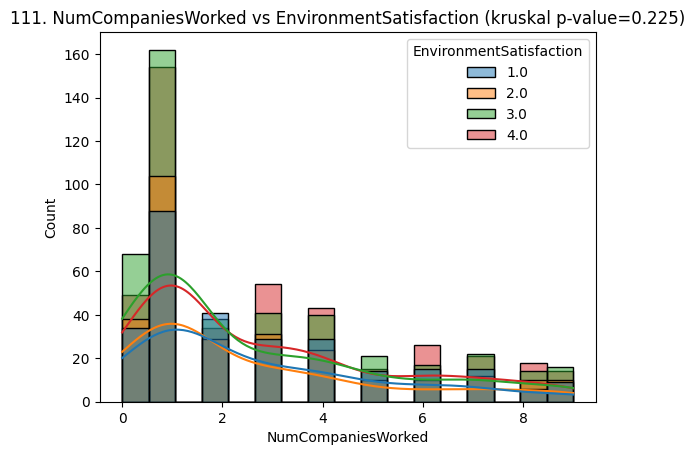

112. NumCompaniesWorked vs JobInvolvement (kruskal p-value=0.514)


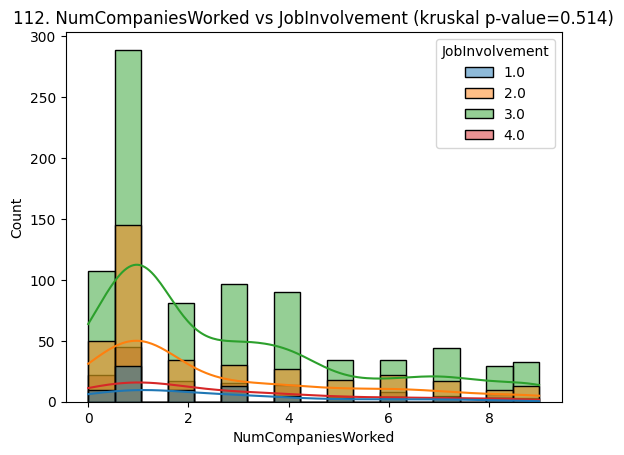

113. NumCompaniesWorked vs JobLevel (kruskal p-value=0.0)


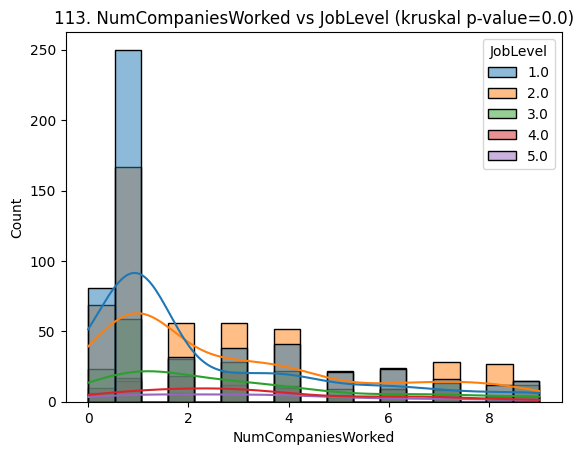

114. NumCompaniesWorked vs JobSatisfaction (kruskal p-value=0.297)


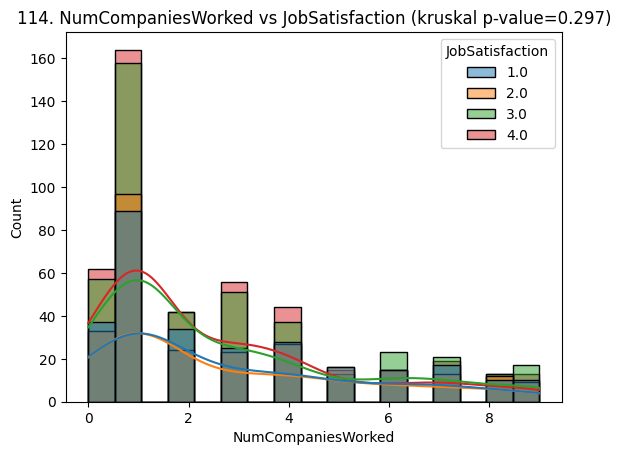

115. NumCompaniesWorked vs PerformanceRating(mannwhitneyu p-value=0.708)


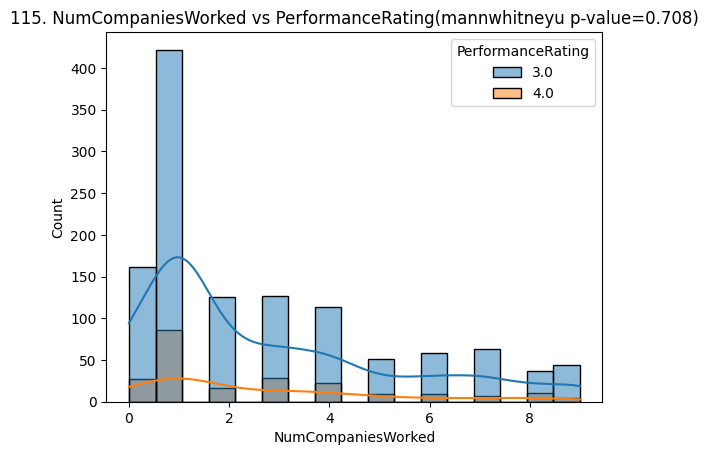

116. NumCompaniesWorked vs RelationshipSatisfaction (kruskal p-value=0.105)


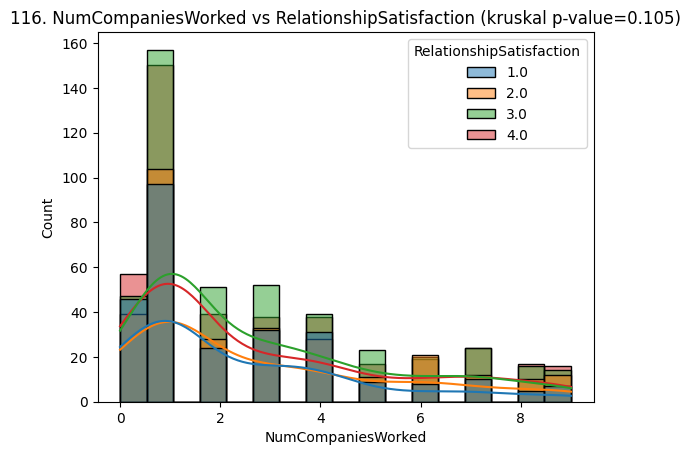

117. NumCompaniesWorked vs StockOptionLevel (kruskal p-value=0.579)


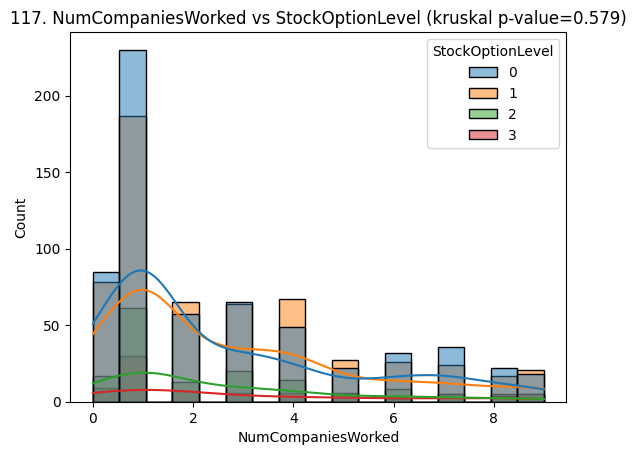

118. NumCompaniesWorked vs WorkLifeBalance (kruskal p-value=0.173)


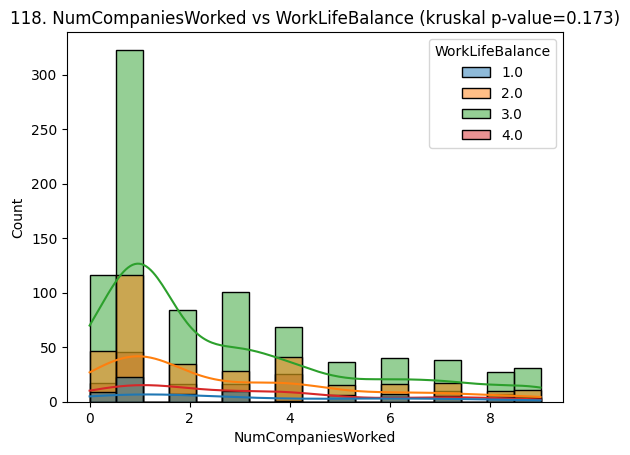

120. NumCompaniesWorked vs Department (kruskal p-value=0.372)


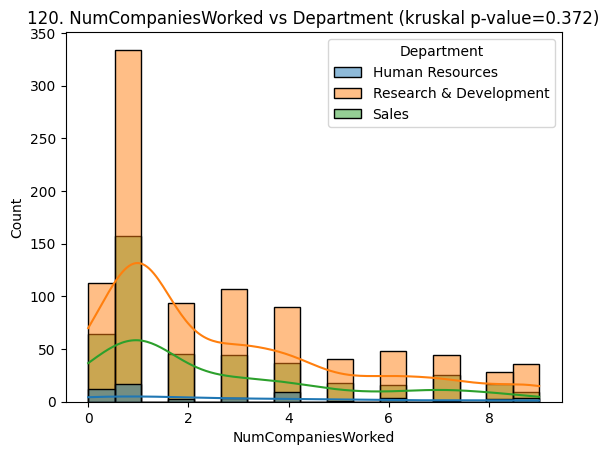

121. NumCompaniesWorked vs EducationField (kruskal p-value=0.852)


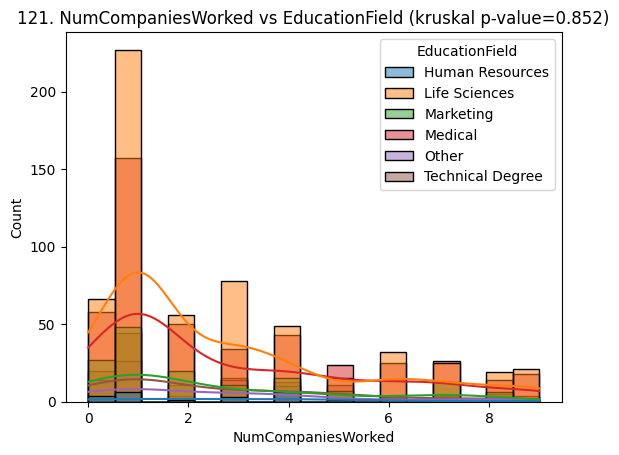

122. NumCompaniesWorked vs Gender(mannwhitneyu p-value=0.129)


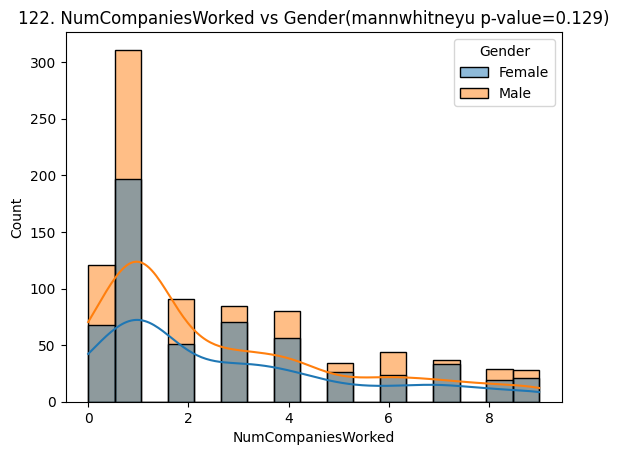

123. NumCompaniesWorked vs JobRole (kruskal p-value=0.0)


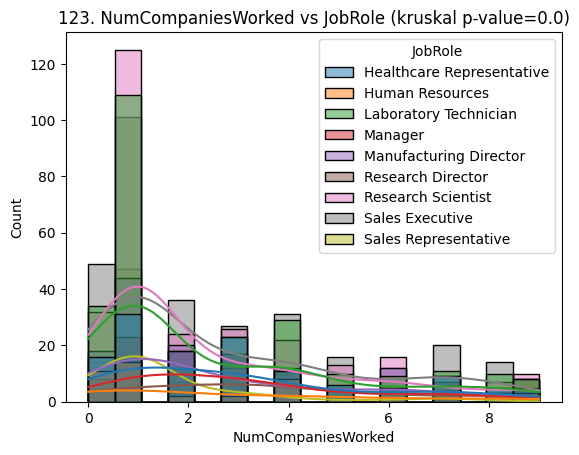

124. NumCompaniesWorked vs MaritalStatus (kruskal p-value=0.151)


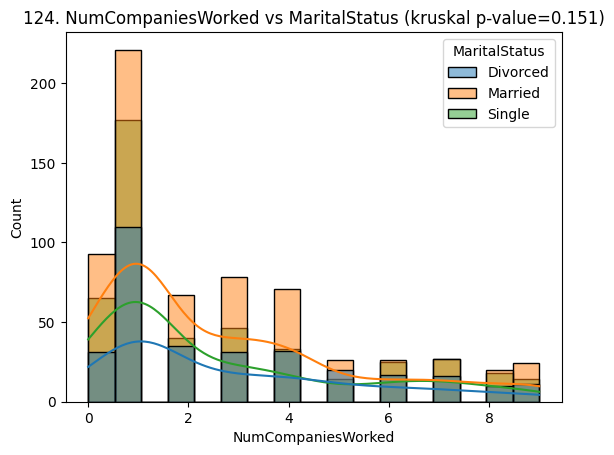

125. NumCompaniesWorked vs OverTime(mannwhitneyu p-value=0.733)


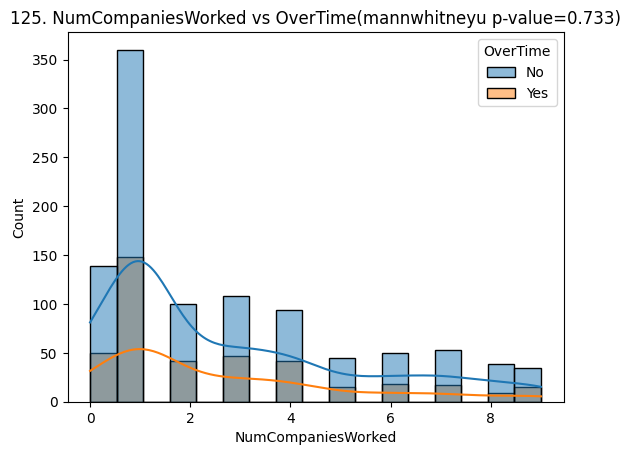

127. PercentSalaryHike vs BusinessTravel (kruskal p-value=0.168)


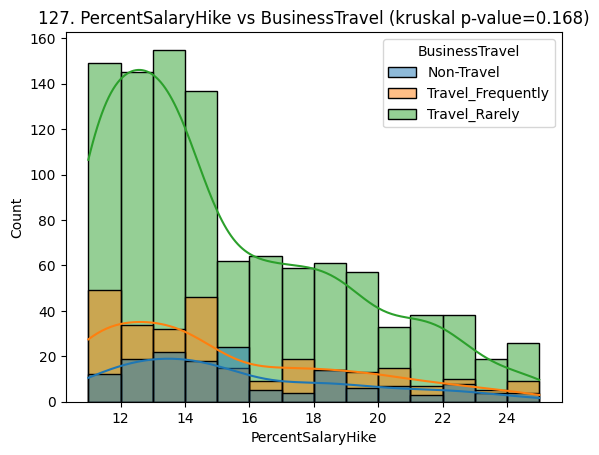

128. PercentSalaryHike vs Education (kruskal p-value=0.791)


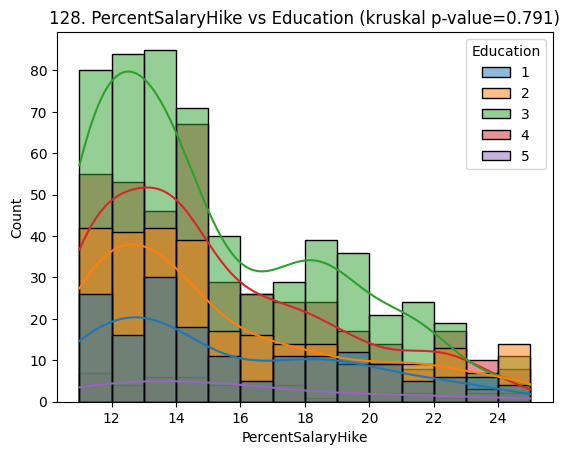

129. PercentSalaryHike vs EnvironmentSatisfaction (kruskal p-value=0.582)


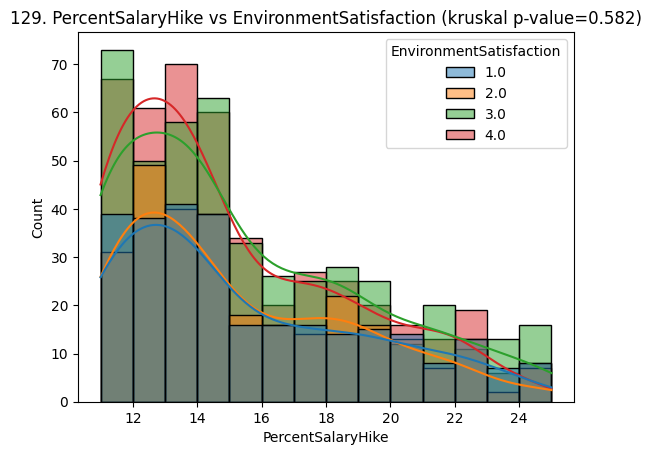

130. PercentSalaryHike vs JobInvolvement (kruskal p-value=0.274)


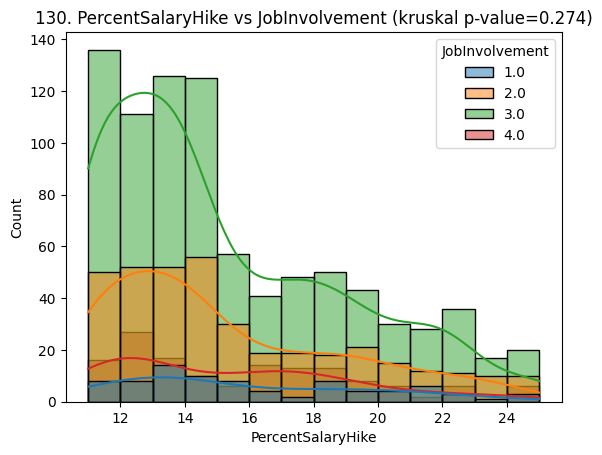

131. PercentSalaryHike vs JobLevel (kruskal p-value=0.418)


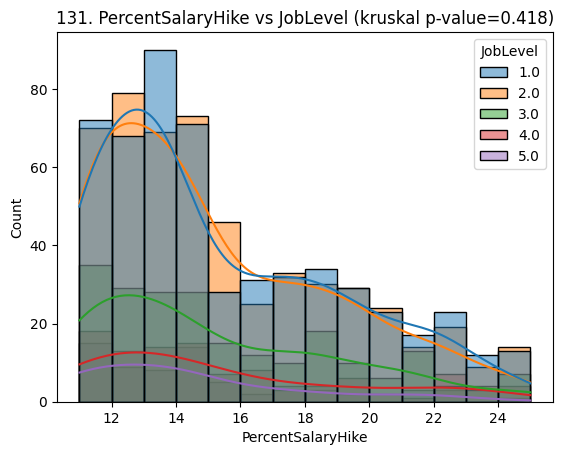

132. PercentSalaryHike vs JobSatisfaction (kruskal p-value=0.427)


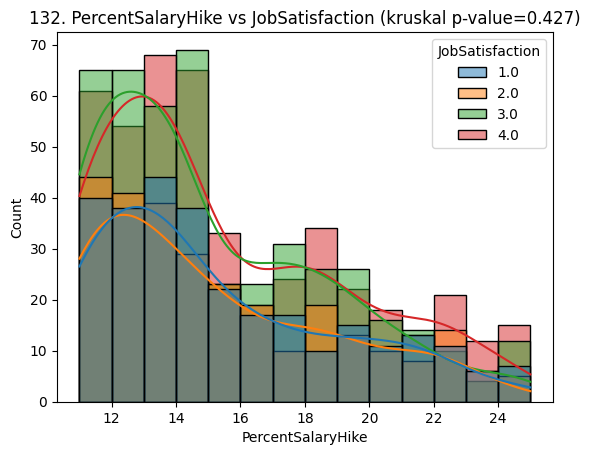

133. PercentSalaryHike vs PerformanceRating(mannwhitneyu p-value=0.0)


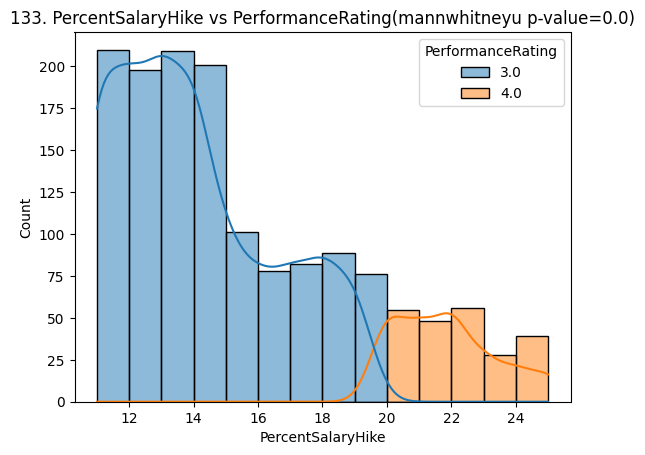

134. PercentSalaryHike vs RelationshipSatisfaction (kruskal p-value=0.234)


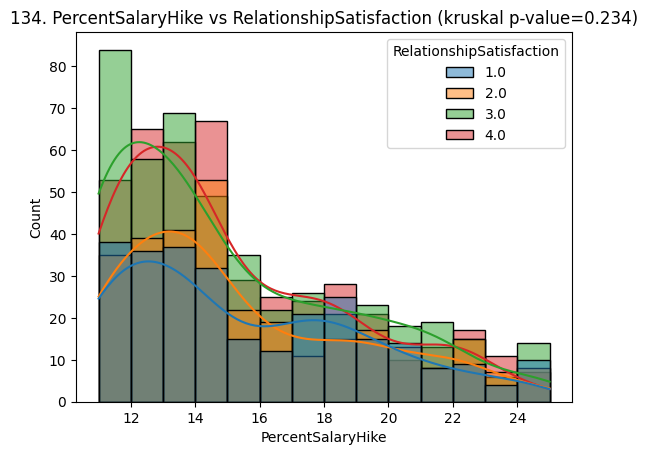

135. PercentSalaryHike vs StockOptionLevel (kruskal p-value=0.393)


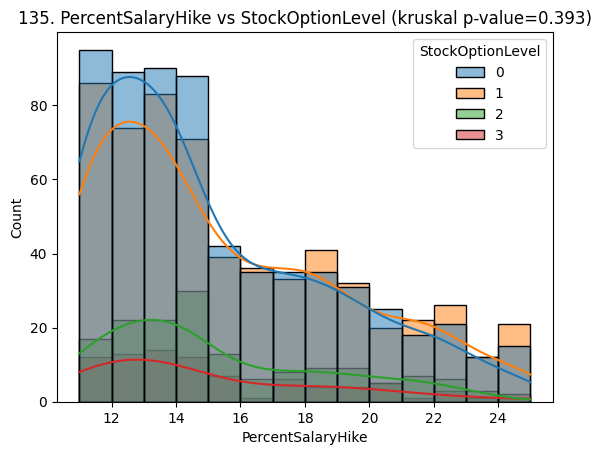

136. PercentSalaryHike vs WorkLifeBalance (kruskal p-value=0.362)


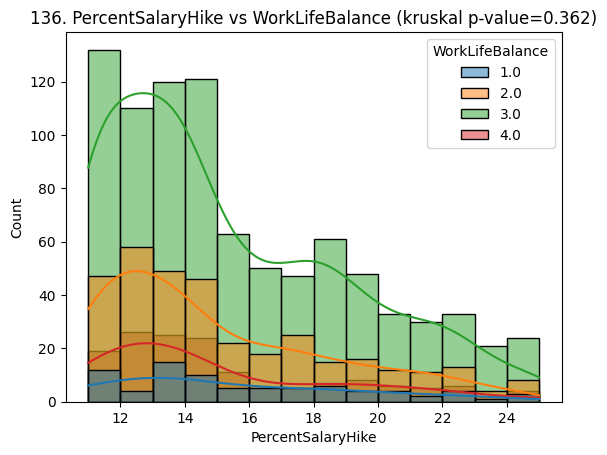

138. PercentSalaryHike vs Department (kruskal p-value=0.355)


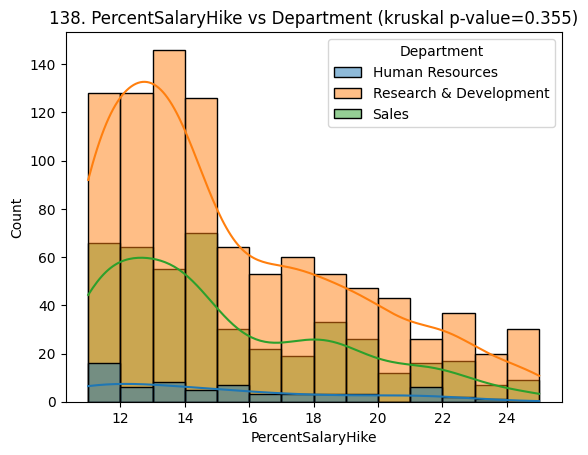

139. PercentSalaryHike vs EducationField (kruskal p-value=0.361)


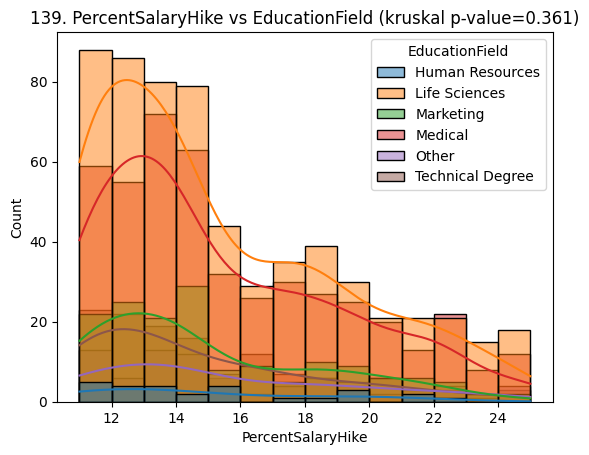

140. PercentSalaryHike vs Gender(mannwhitneyu p-value=0.704)


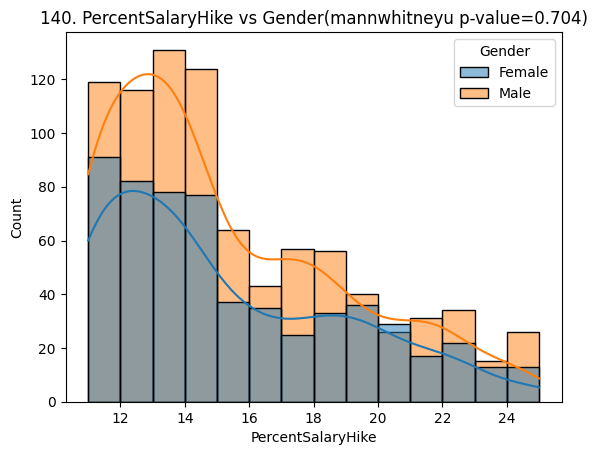

141. PercentSalaryHike vs JobRole (kruskal p-value=0.26)


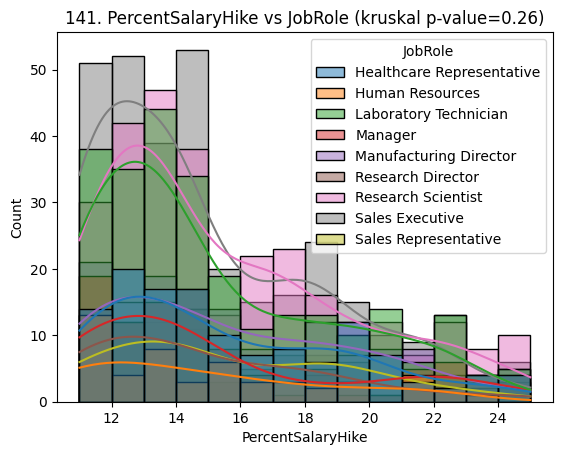

142. PercentSalaryHike vs MaritalStatus (kruskal p-value=0.643)


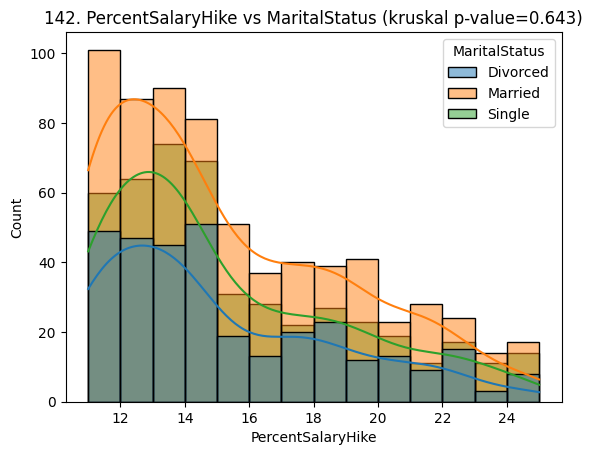

143. PercentSalaryHike vs OverTime(mannwhitneyu p-value=0.561)


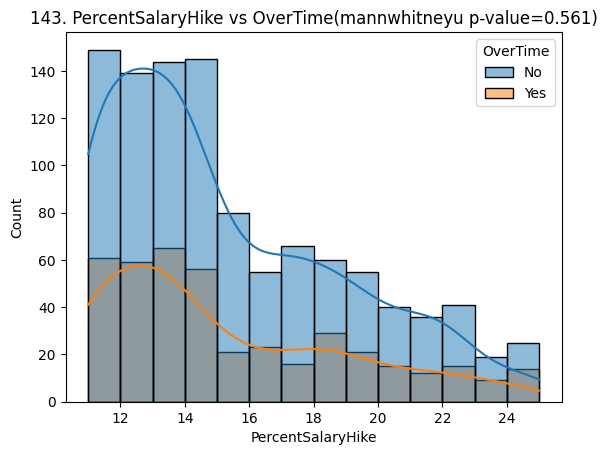

145. TotalWorkingYears vs BusinessTravel (kruskal p-value=0.603)


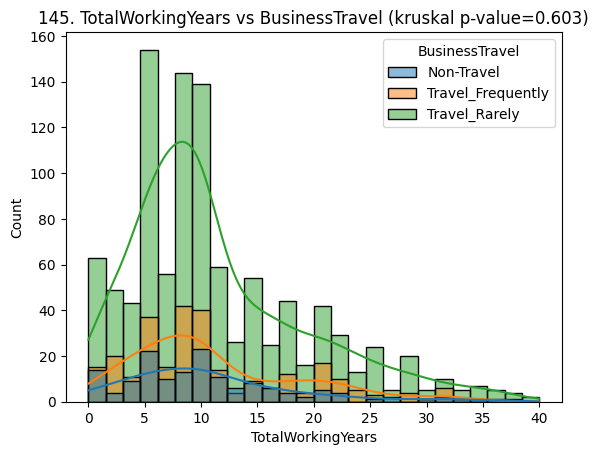

146. TotalWorkingYears vs Education (kruskal p-value=0.0)


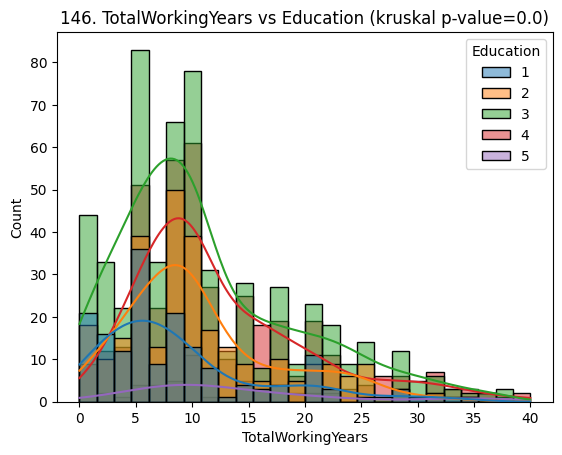

147. TotalWorkingYears vs EnvironmentSatisfaction (kruskal p-value=0.875)


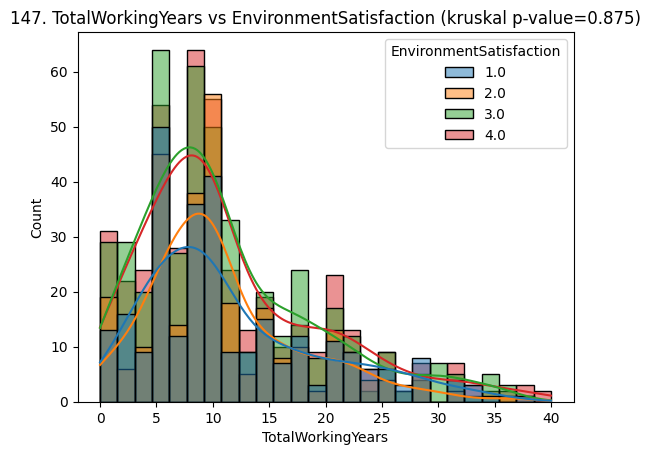

148. TotalWorkingYears vs JobInvolvement (kruskal p-value=0.937)


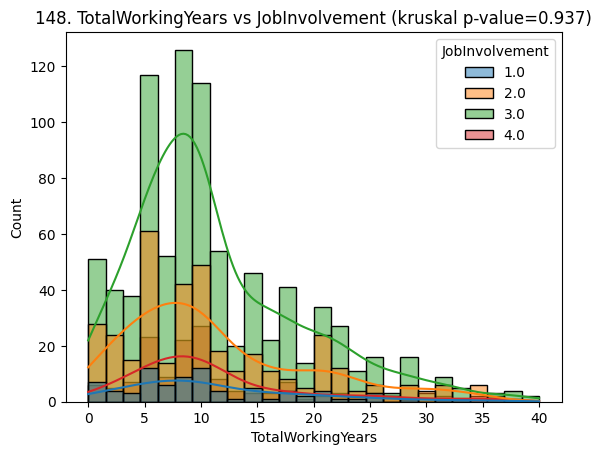

149. TotalWorkingYears vs JobLevel (kruskal p-value=0.0)


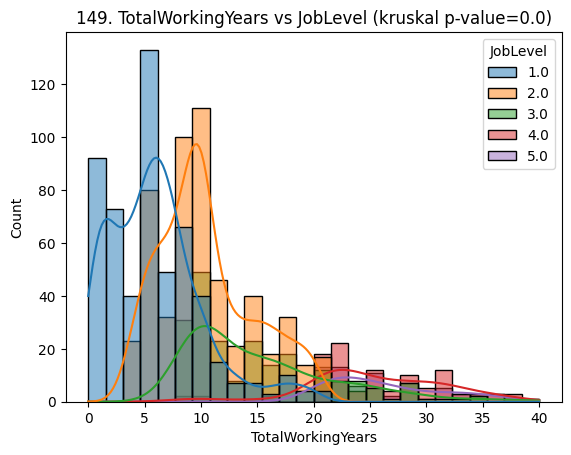

150. TotalWorkingYears vs JobSatisfaction (kruskal p-value=0.657)


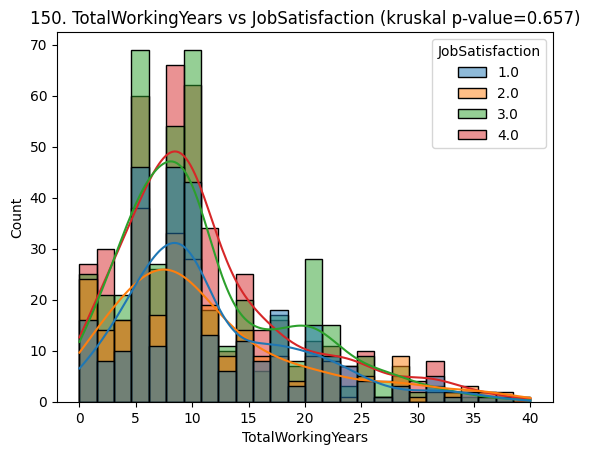

151. TotalWorkingYears vs PerformanceRating(mannwhitneyu p-value=0.655)


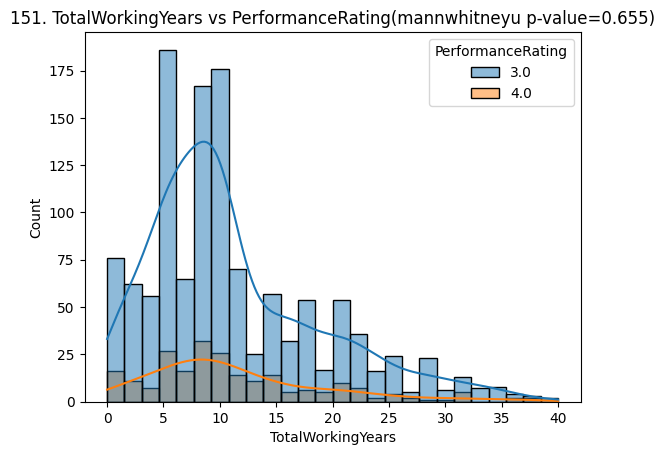

152. TotalWorkingYears vs RelationshipSatisfaction (kruskal p-value=0.972)


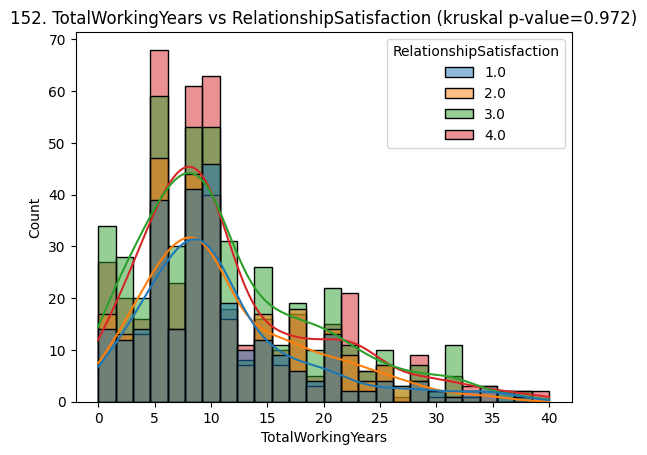

153. TotalWorkingYears vs StockOptionLevel (kruskal p-value=0.003)


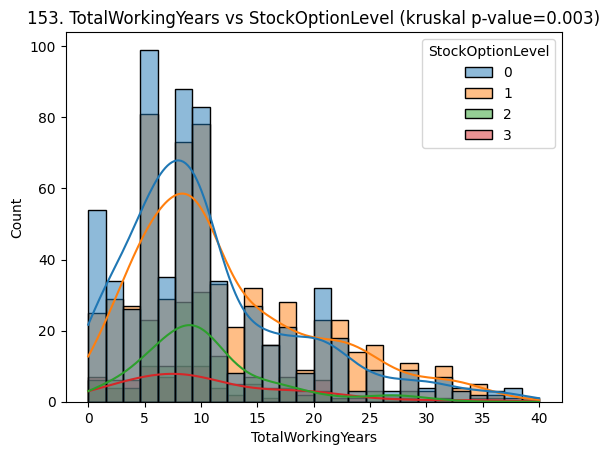

154. TotalWorkingYears vs WorkLifeBalance (kruskal p-value=0.896)


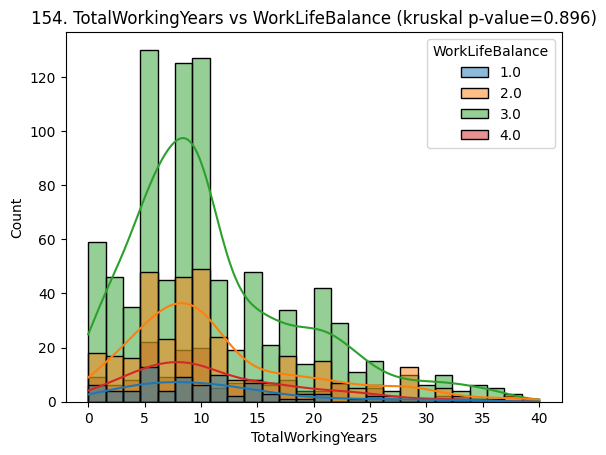

156. TotalWorkingYears vs Department (kruskal p-value=0.931)


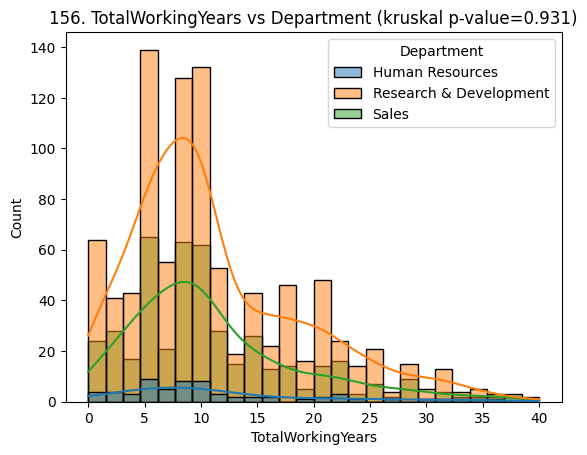

157. TotalWorkingYears vs EducationField (kruskal p-value=0.567)


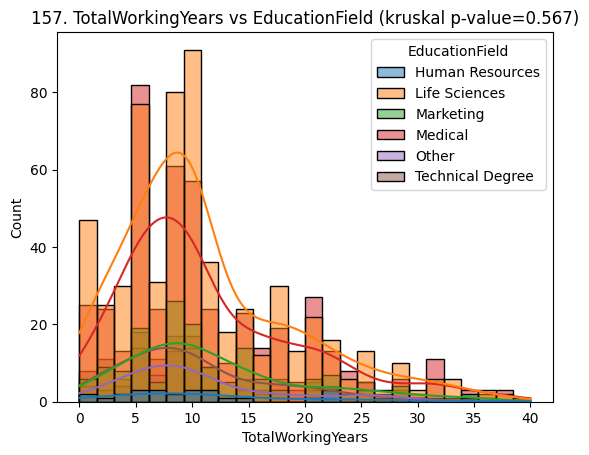

158. TotalWorkingYears vs Gender(mannwhitneyu p-value=0.059)


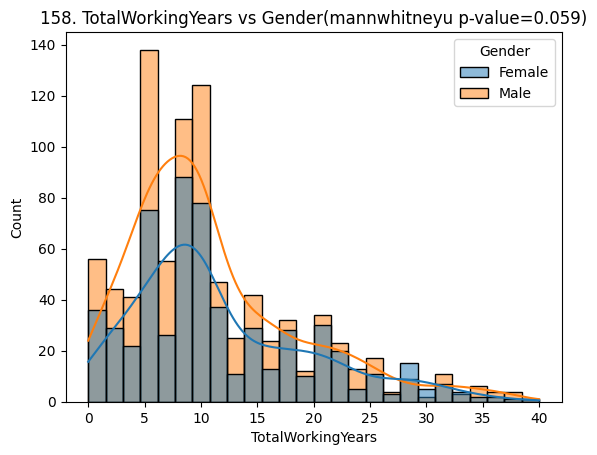

159. TotalWorkingYears vs JobRole (kruskal p-value=0.0)


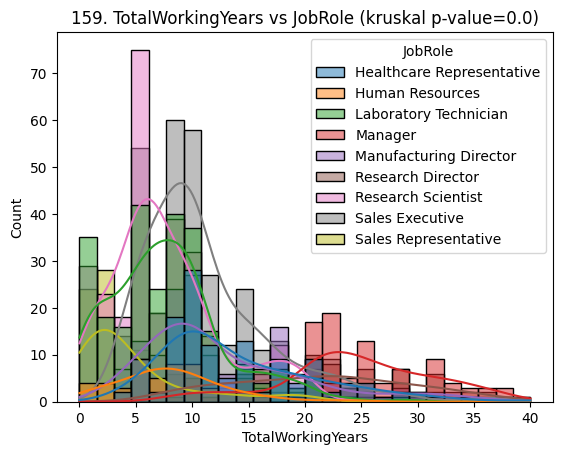

160. TotalWorkingYears vs MaritalStatus (kruskal p-value=0.001)


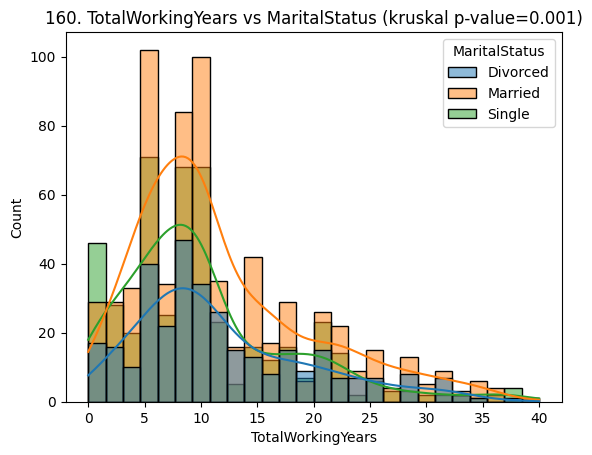

161. TotalWorkingYears vs OverTime(mannwhitneyu p-value=0.992)


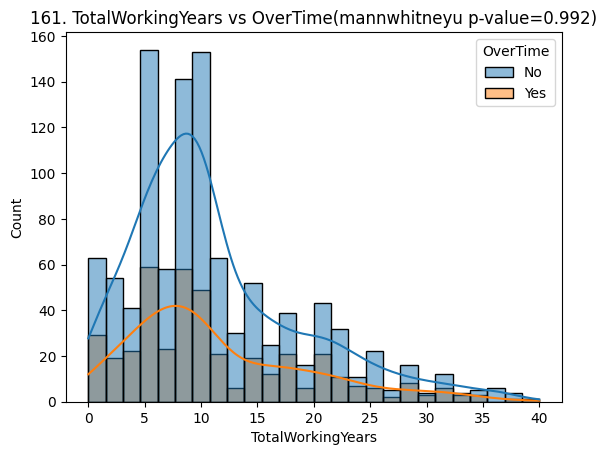

163. YearsAtCompany vs BusinessTravel (kruskal p-value=0.695)


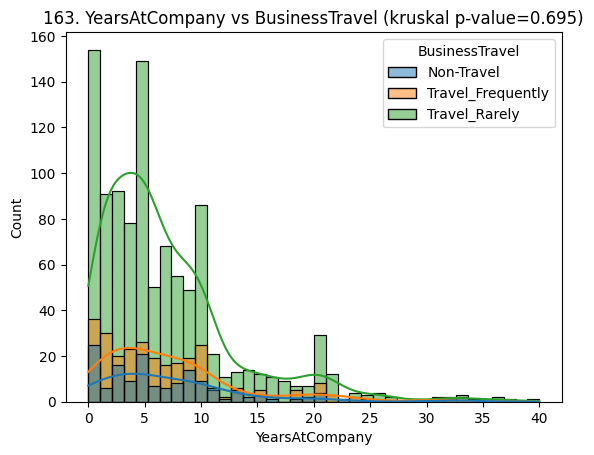

164. YearsAtCompany vs Education (kruskal p-value=0.116)


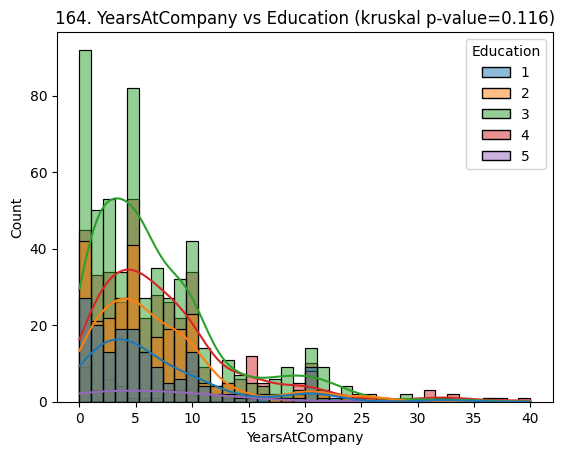

165. YearsAtCompany vs EnvironmentSatisfaction (kruskal p-value=0.42)


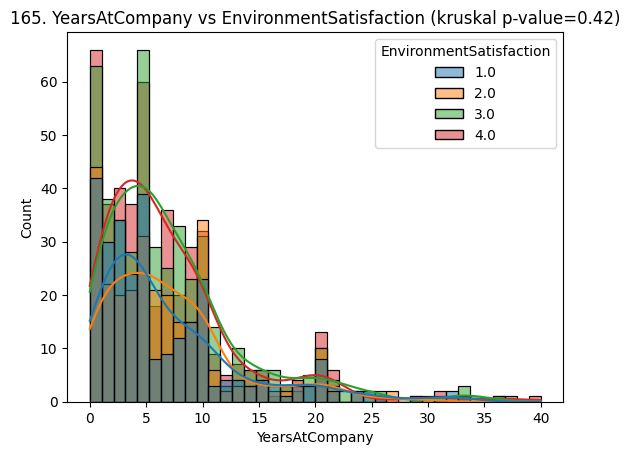

166. YearsAtCompany vs JobInvolvement (kruskal p-value=0.901)


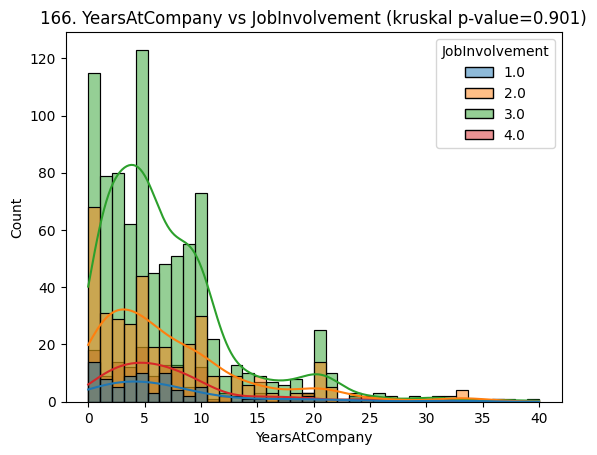

167. YearsAtCompany vs JobLevel (kruskal p-value=0.0)


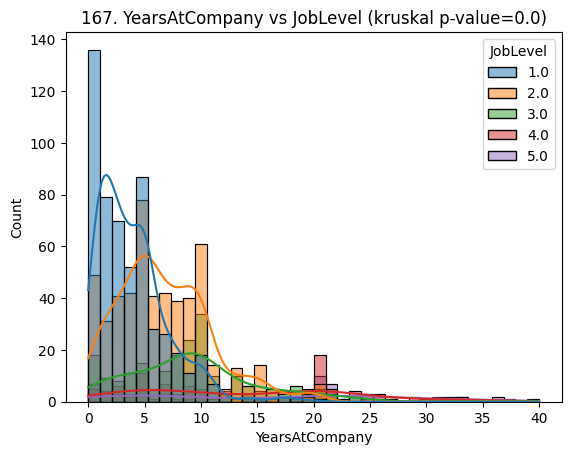

168. YearsAtCompany vs JobSatisfaction (kruskal p-value=0.931)


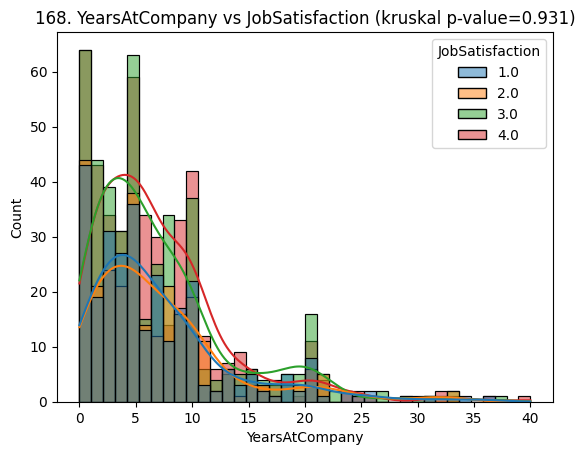

169. YearsAtCompany vs PerformanceRating(mannwhitneyu p-value=0.509)


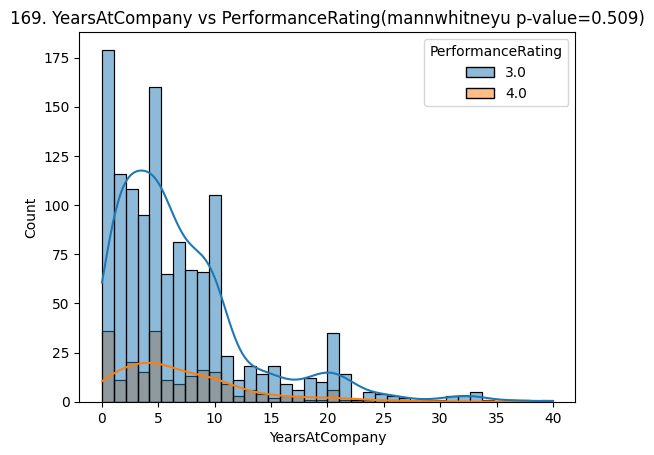

170. YearsAtCompany vs RelationshipSatisfaction (kruskal p-value=0.249)


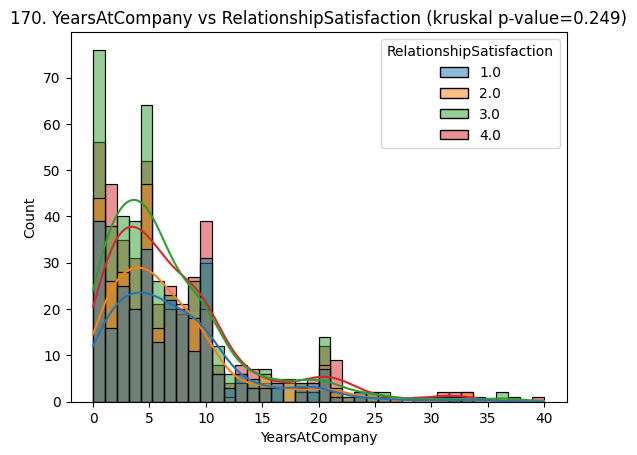

171. YearsAtCompany vs StockOptionLevel (kruskal p-value=0.005)


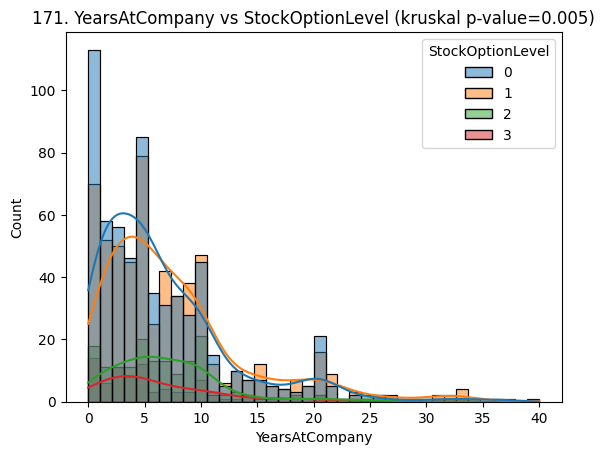

172. YearsAtCompany vs WorkLifeBalance (kruskal p-value=0.611)


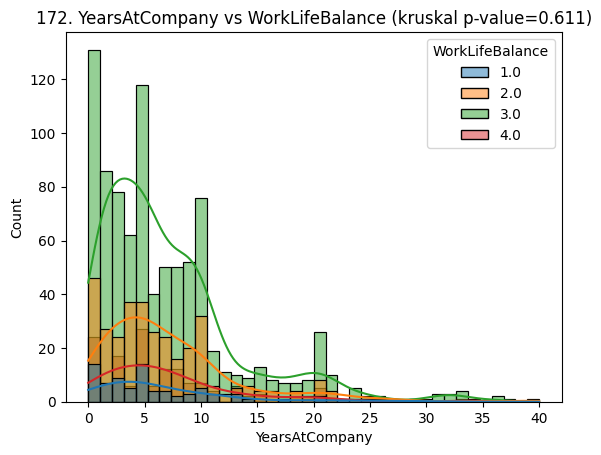

174. YearsAtCompany vs Department (kruskal p-value=0.361)


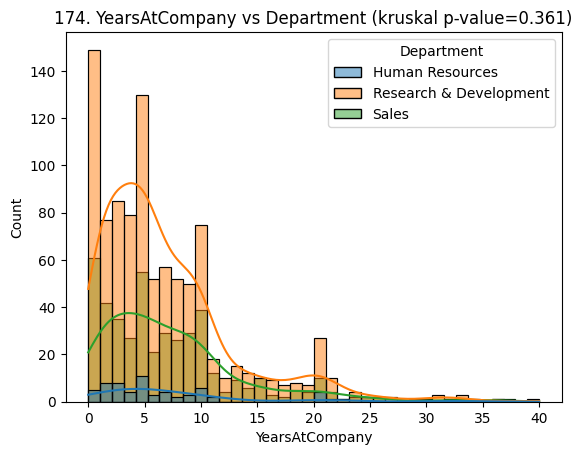

175. YearsAtCompany vs EducationField (kruskal p-value=0.847)


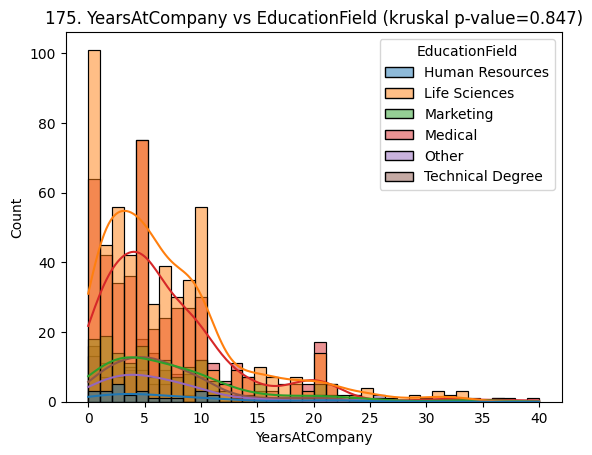

176. YearsAtCompany vs Gender(mannwhitneyu p-value=0.106)


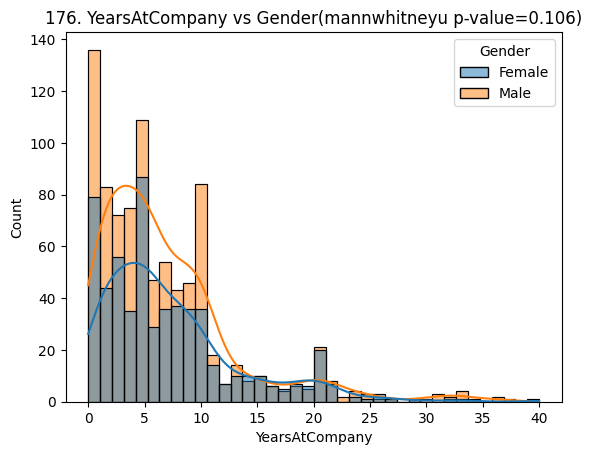

177. YearsAtCompany vs JobRole (kruskal p-value=0.0)


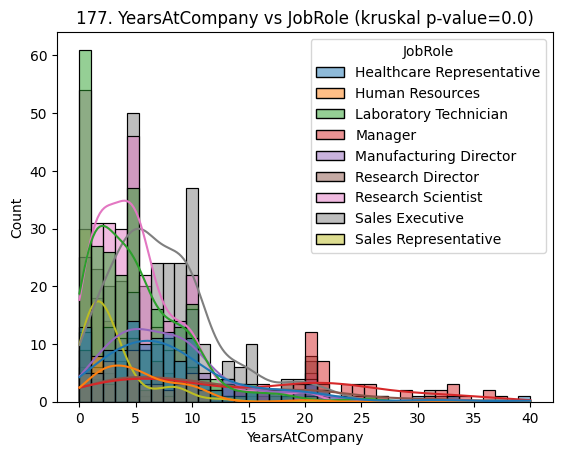

178. YearsAtCompany vs MaritalStatus (kruskal p-value=0.005)


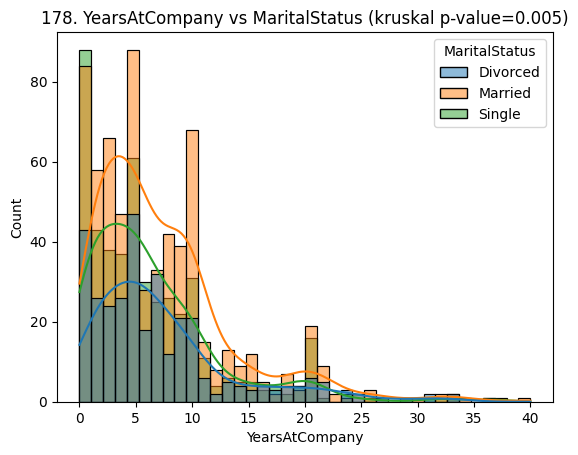

179. YearsAtCompany vs OverTime(mannwhitneyu p-value=0.164)


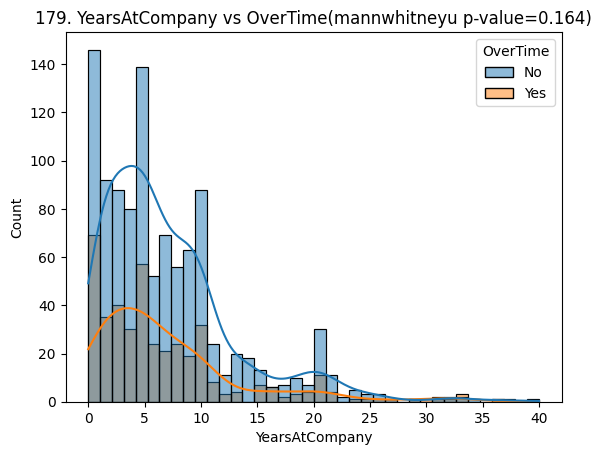

181. YearsInCurrentRole vs BusinessTravel (kruskal p-value=0.635)


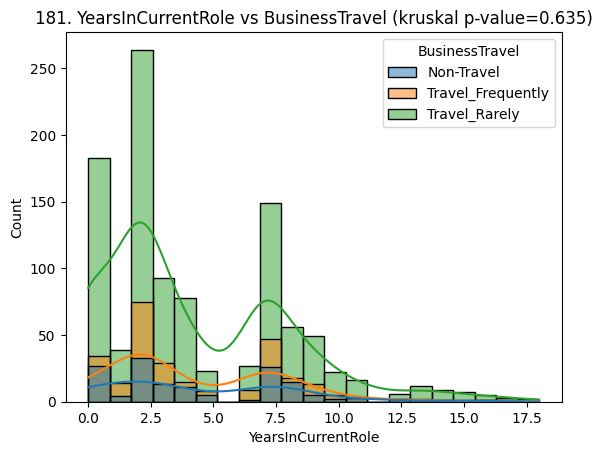

182. YearsInCurrentRole vs Education (kruskal p-value=0.336)


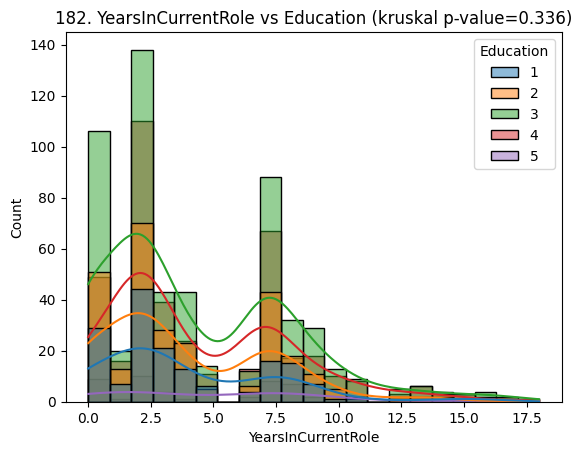

183. YearsInCurrentRole vs EnvironmentSatisfaction (kruskal p-value=0.467)


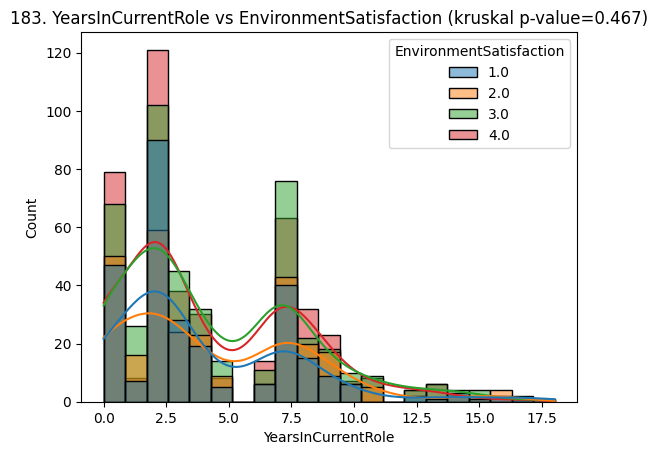

184. YearsInCurrentRole vs JobInvolvement (kruskal p-value=0.941)


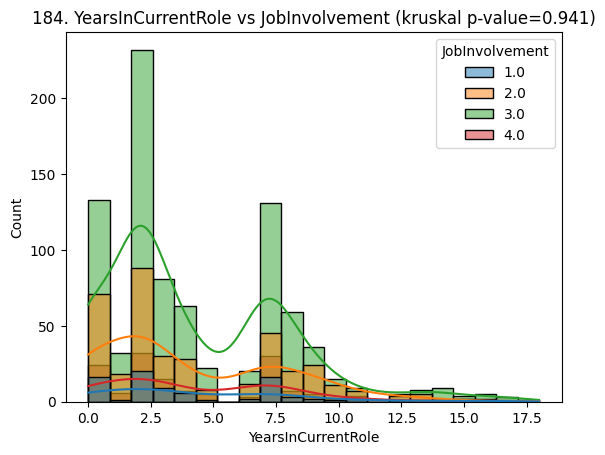

185. YearsInCurrentRole vs JobLevel (kruskal p-value=0.0)


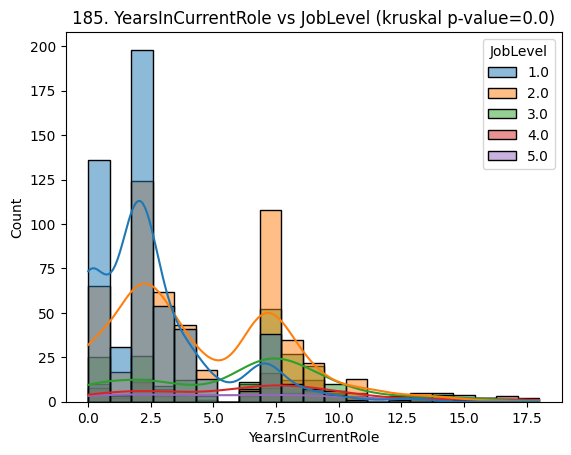

186. YearsInCurrentRole vs JobSatisfaction (kruskal p-value=0.995)


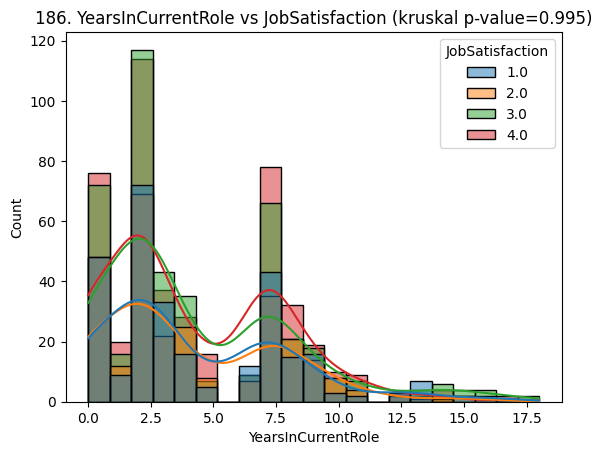

187. YearsInCurrentRole vs PerformanceRating(mannwhitneyu p-value=0.21)


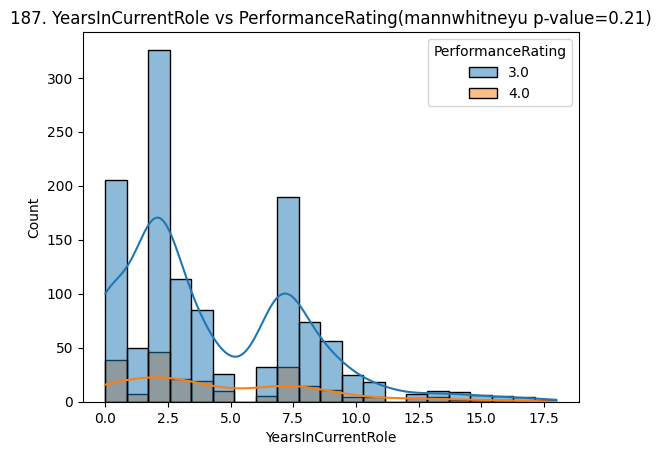

188. YearsInCurrentRole vs RelationshipSatisfaction (kruskal p-value=0.165)


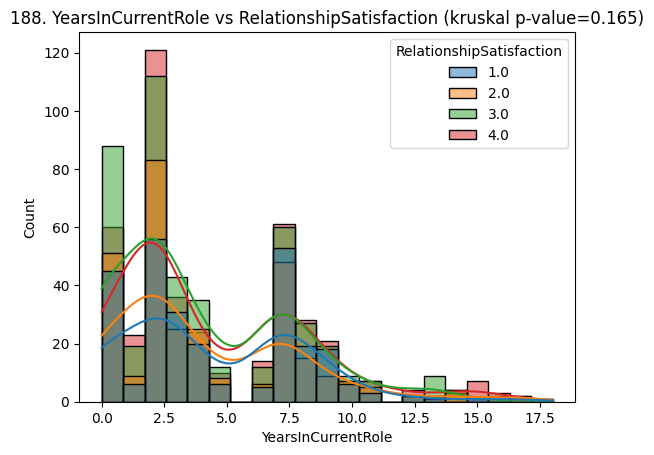

189. YearsInCurrentRole vs StockOptionLevel (kruskal p-value=0.016)


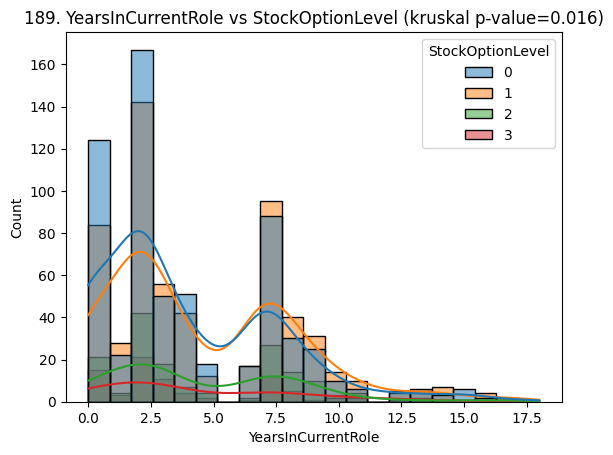

190. YearsInCurrentRole vs WorkLifeBalance (kruskal p-value=0.544)


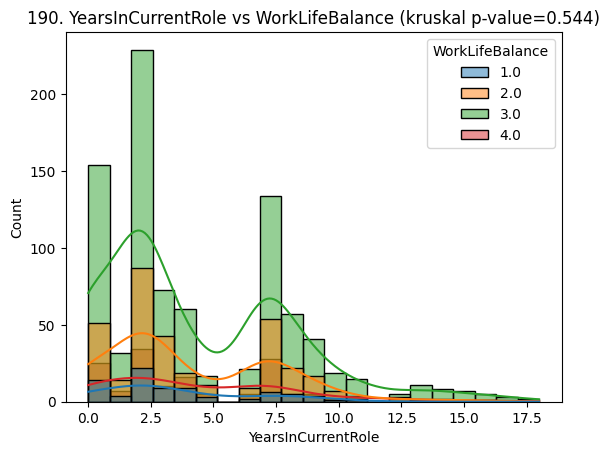

192. YearsInCurrentRole vs Department (kruskal p-value=0.096)


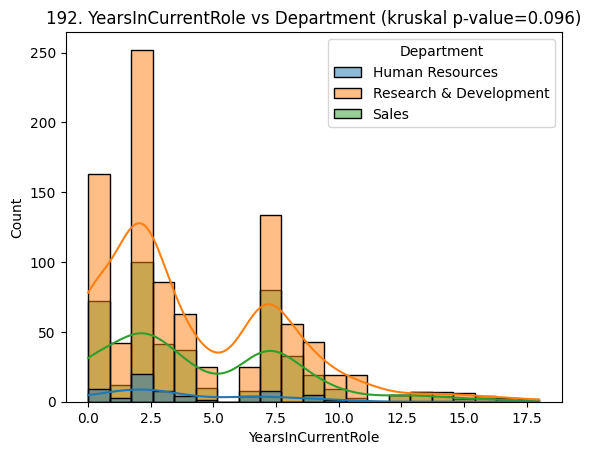

193. YearsInCurrentRole vs EducationField (kruskal p-value=0.786)


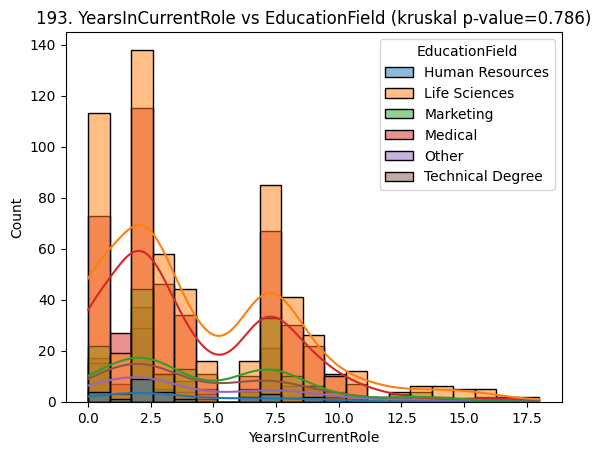

194. YearsInCurrentRole vs Gender(mannwhitneyu p-value=0.245)


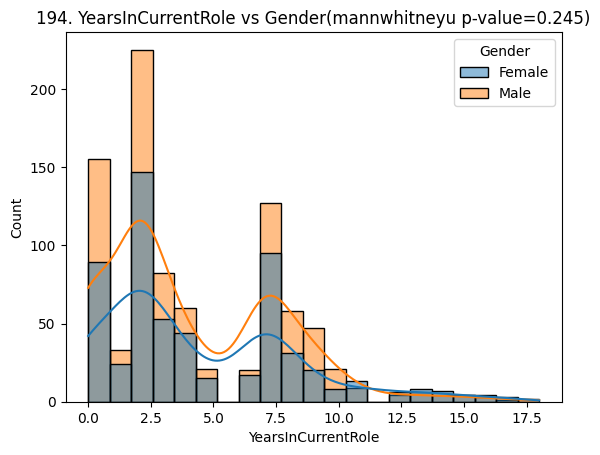

195. YearsInCurrentRole vs JobRole (kruskal p-value=0.0)


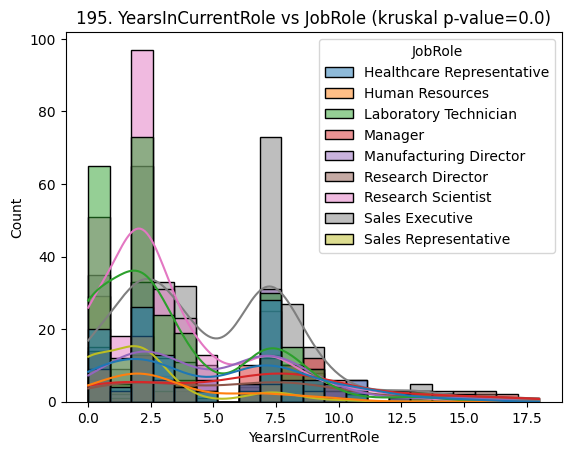

196. YearsInCurrentRole vs MaritalStatus (kruskal p-value=0.005)


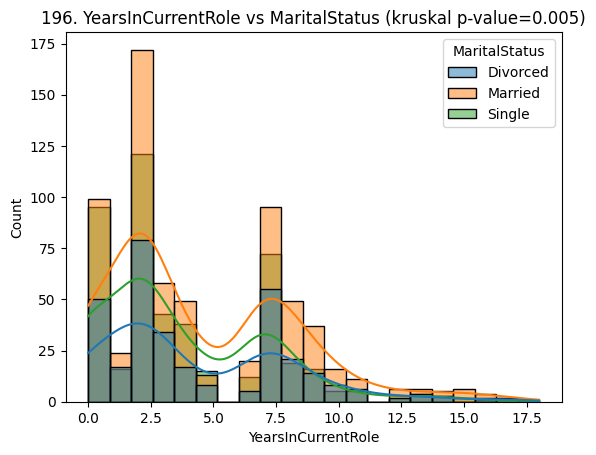

197. YearsInCurrentRole vs OverTime(mannwhitneyu p-value=0.164)


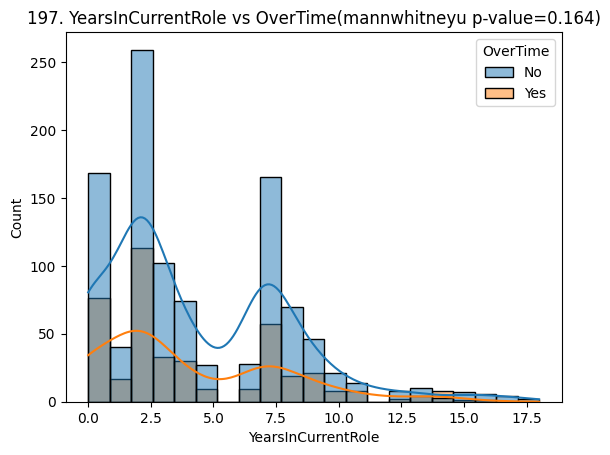

199. YearsSinceLastPromotion vs BusinessTravel (kruskal p-value=0.238)


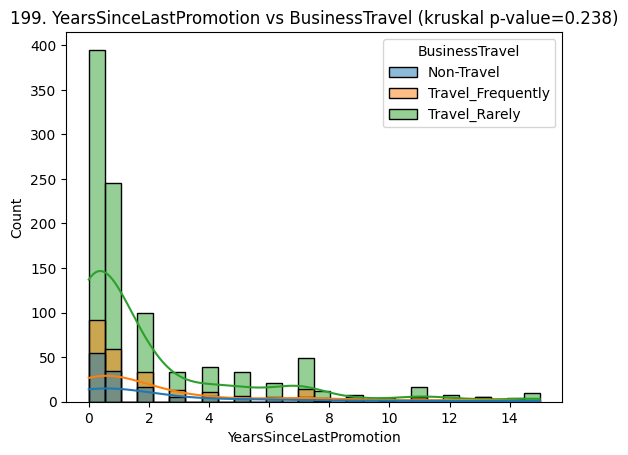

200. YearsSinceLastPromotion vs Education (kruskal p-value=0.951)


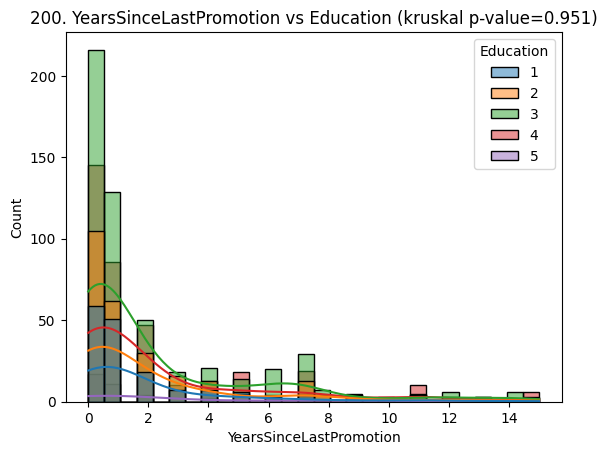

201. YearsSinceLastPromotion vs EnvironmentSatisfaction (kruskal p-value=0.262)


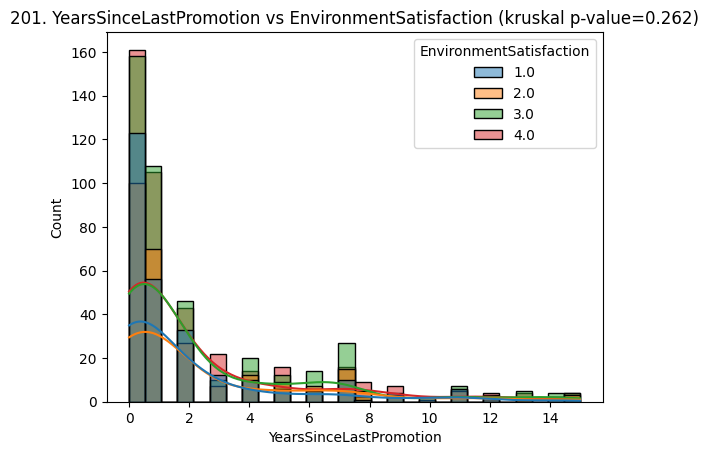

202. YearsSinceLastPromotion vs JobInvolvement (kruskal p-value=0.81)


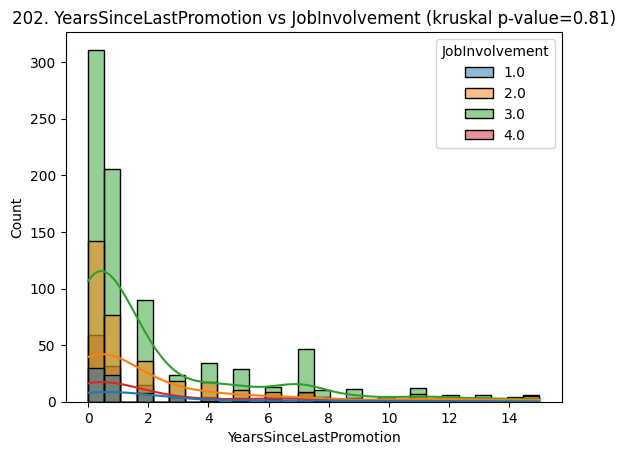

203. YearsSinceLastPromotion vs JobLevel (kruskal p-value=0.0)


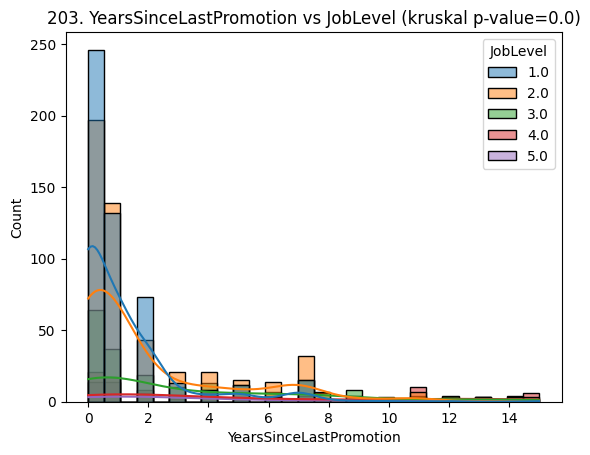

204. YearsSinceLastPromotion vs JobSatisfaction (kruskal p-value=0.913)


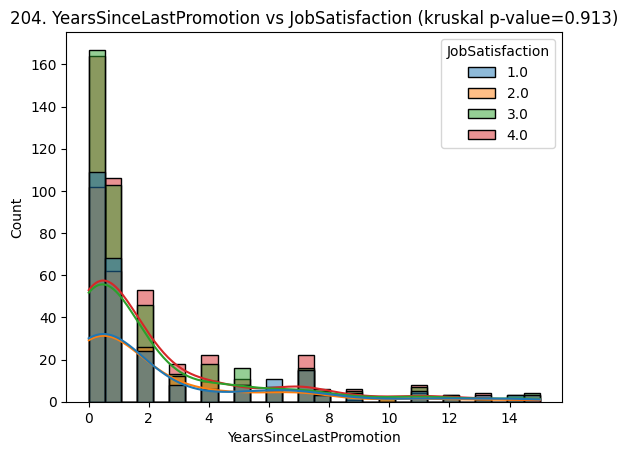

205. YearsSinceLastPromotion vs PerformanceRating(mannwhitneyu p-value=0.535)


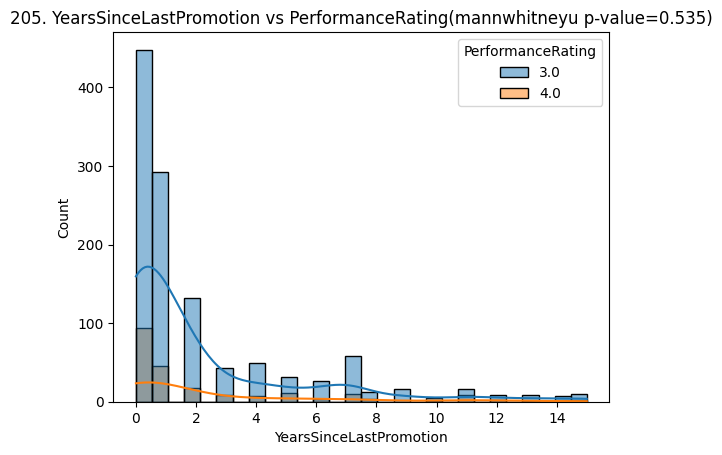

206. YearsSinceLastPromotion vs RelationshipSatisfaction (kruskal p-value=0.003)


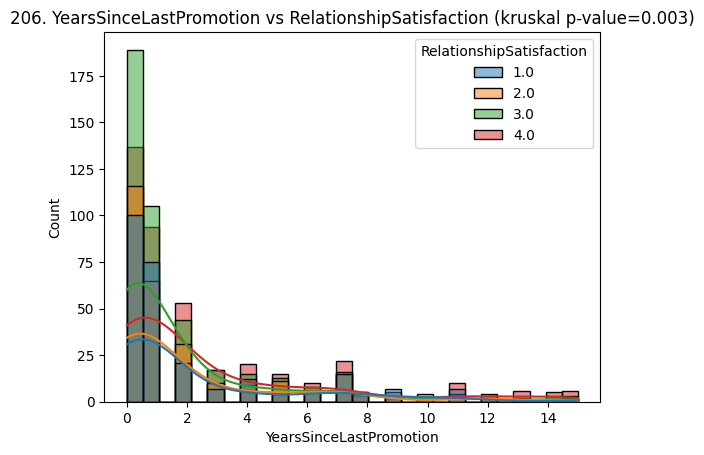

207. YearsSinceLastPromotion vs StockOptionLevel (kruskal p-value=0.286)


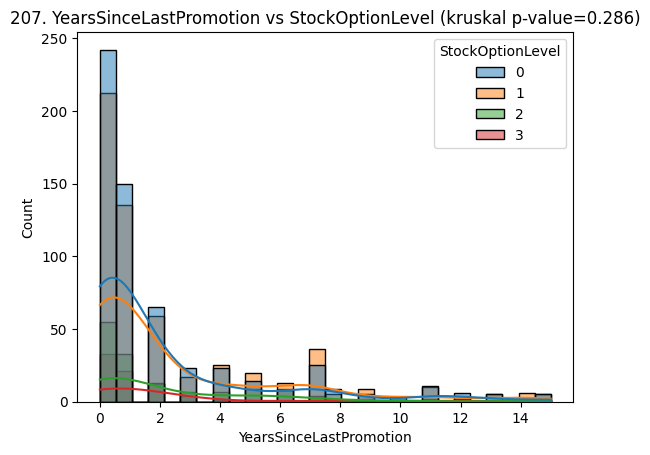

208. YearsSinceLastPromotion vs WorkLifeBalance (kruskal p-value=0.318)


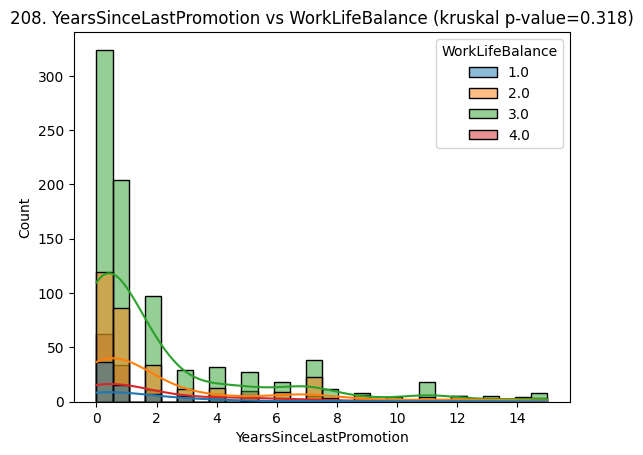

210. YearsSinceLastPromotion vs Department (kruskal p-value=0.677)


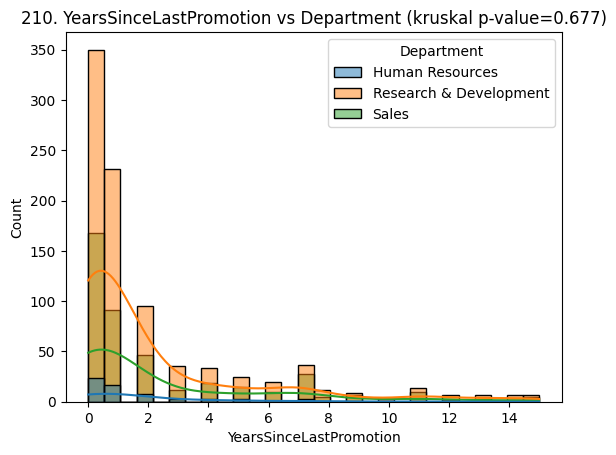

211. YearsSinceLastPromotion vs EducationField (kruskal p-value=0.257)


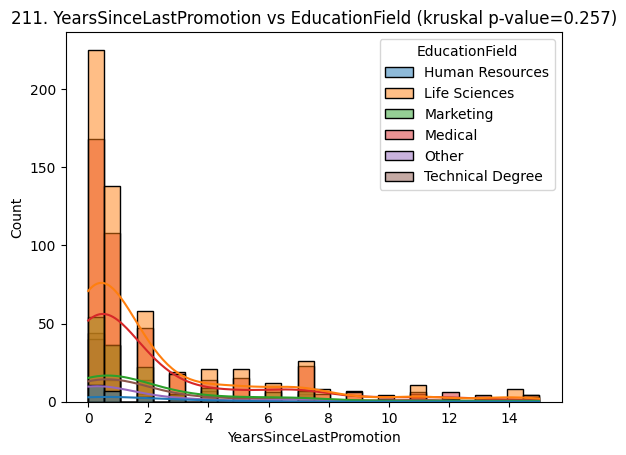

212. YearsSinceLastPromotion vs Gender(mannwhitneyu p-value=0.274)


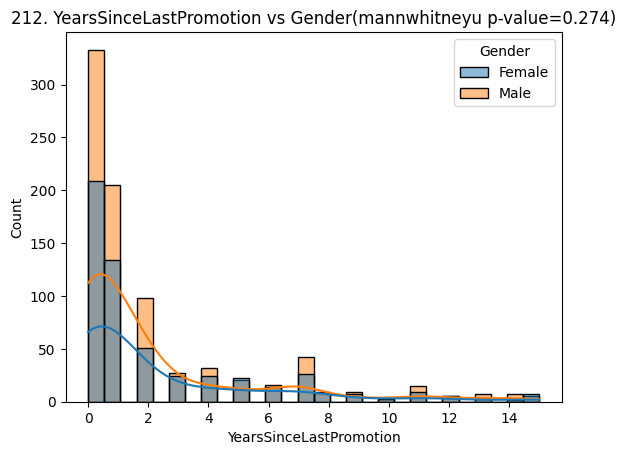

213. YearsSinceLastPromotion vs JobRole (kruskal p-value=0.0)


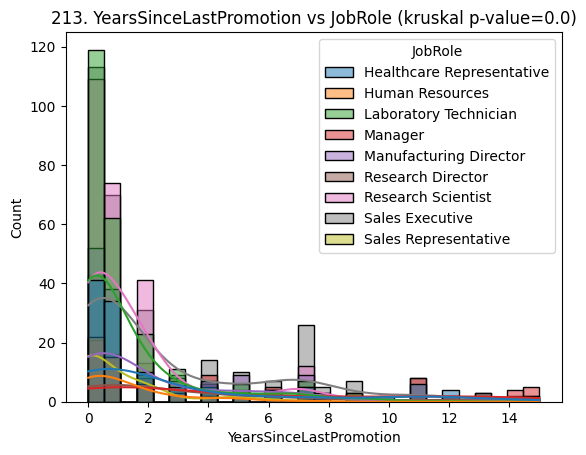

214. YearsSinceLastPromotion vs MaritalStatus (kruskal p-value=0.012)


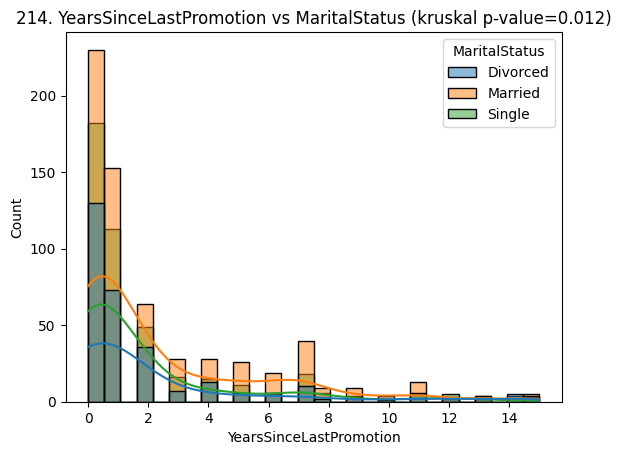

215. YearsSinceLastPromotion vs OverTime(mannwhitneyu p-value=0.421)


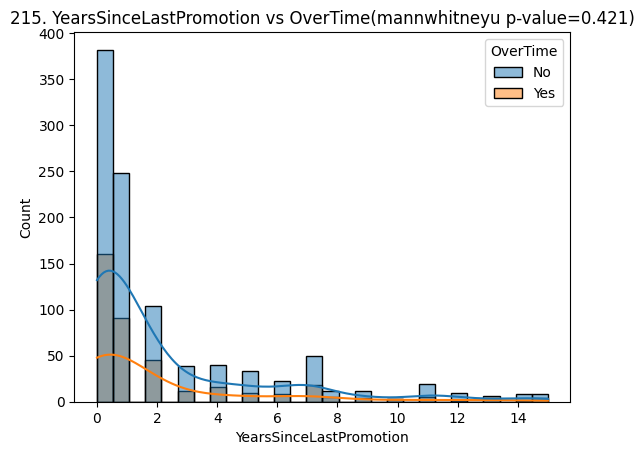

217. YearsWithCurrManager vs BusinessTravel (kruskal p-value=0.647)


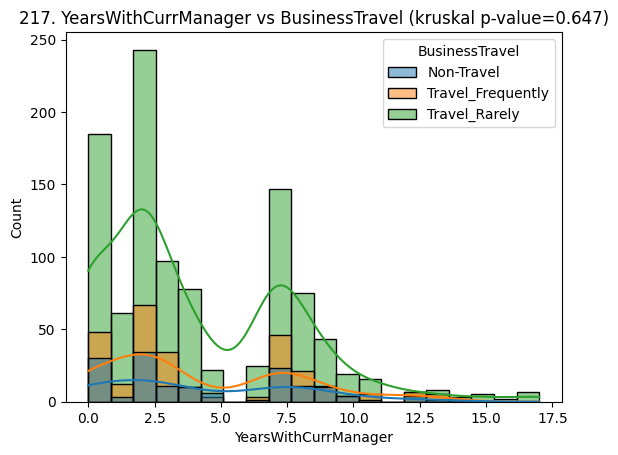

218. YearsWithCurrManager vs Education (kruskal p-value=0.308)


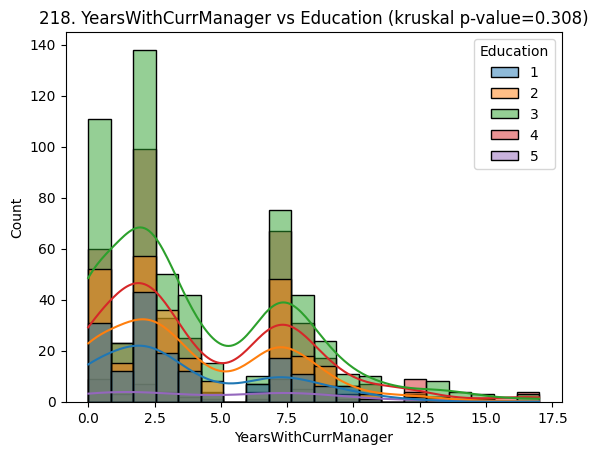

219. YearsWithCurrManager vs EnvironmentSatisfaction (kruskal p-value=0.947)


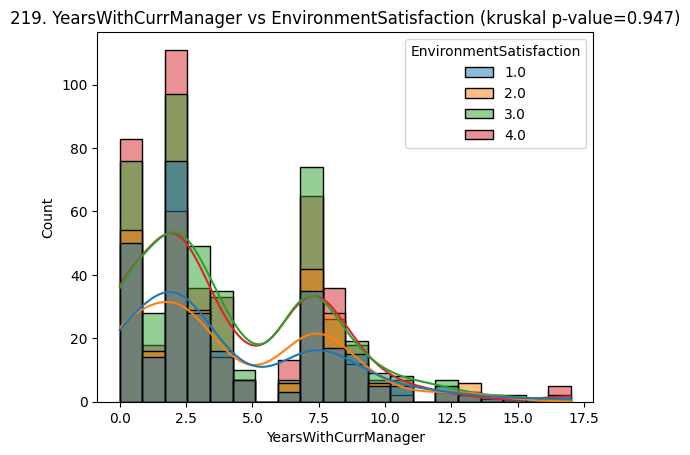

220. YearsWithCurrManager vs JobInvolvement (kruskal p-value=0.411)


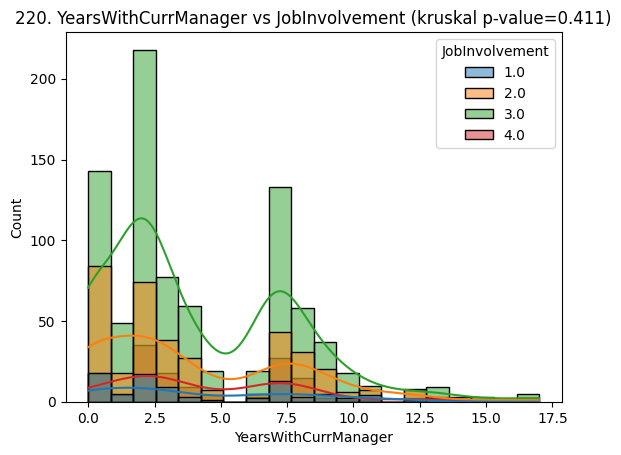

221. YearsWithCurrManager vs JobLevel (kruskal p-value=0.0)


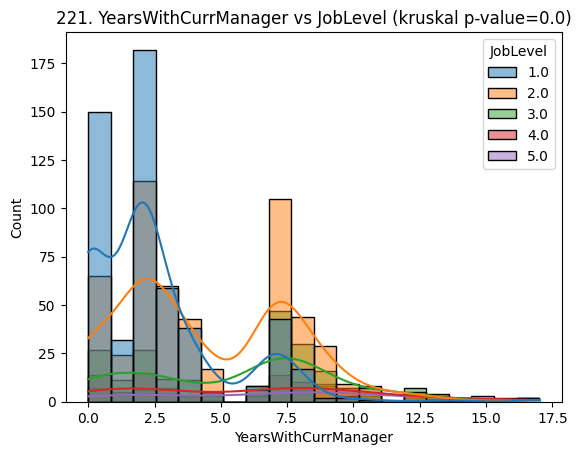

222. YearsWithCurrManager vs JobSatisfaction (kruskal p-value=0.728)


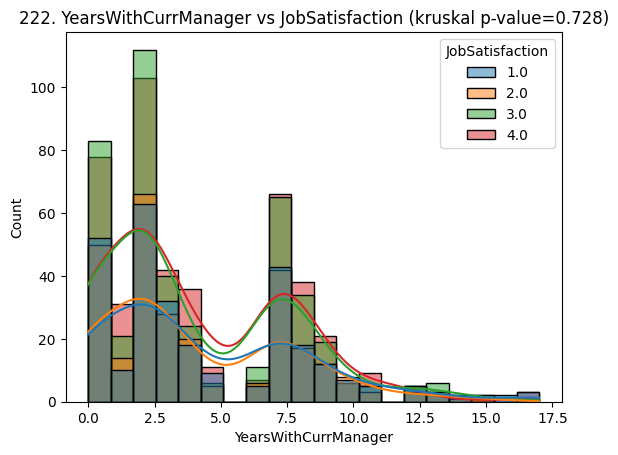

223. YearsWithCurrManager vs PerformanceRating(mannwhitneyu p-value=0.327)


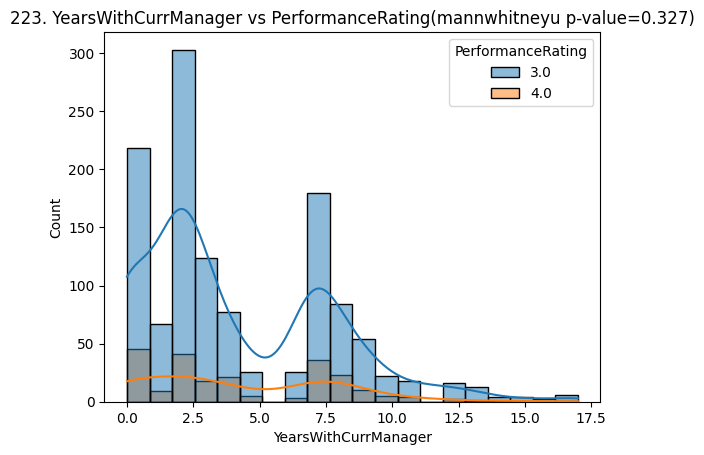

224. YearsWithCurrManager vs RelationshipSatisfaction (kruskal p-value=0.121)


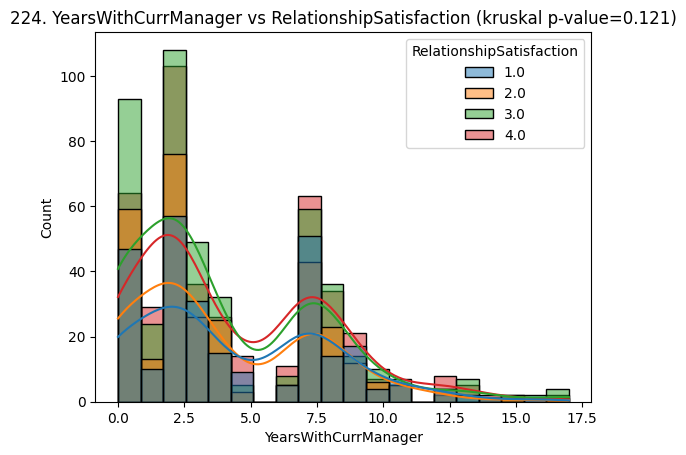

225. YearsWithCurrManager vs StockOptionLevel (kruskal p-value=0.058)


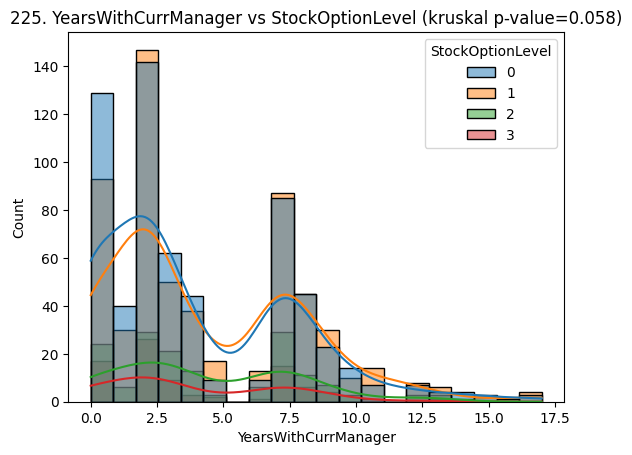

226. YearsWithCurrManager vs WorkLifeBalance (kruskal p-value=0.909)


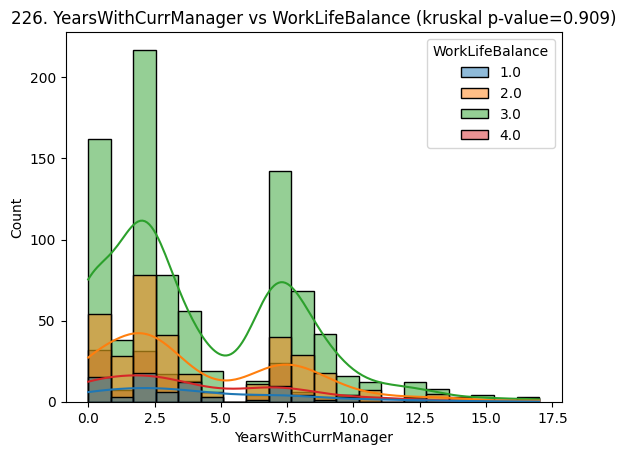

228. YearsWithCurrManager vs Department (kruskal p-value=0.638)


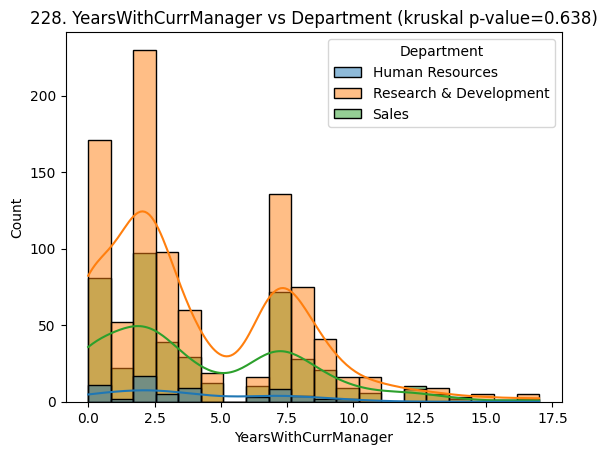

229. YearsWithCurrManager vs EducationField (kruskal p-value=0.827)


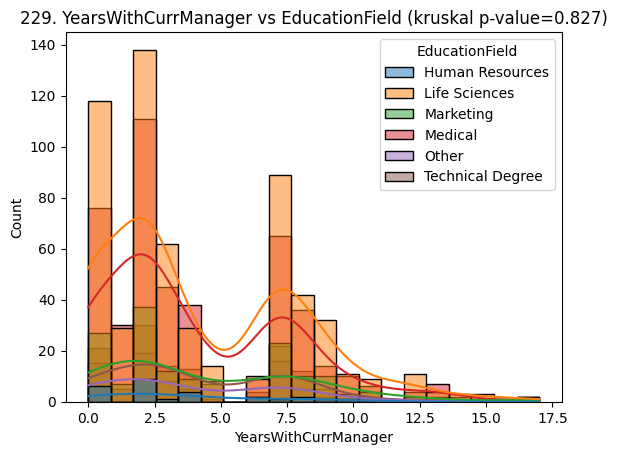

230. YearsWithCurrManager vs Gender(mannwhitneyu p-value=0.307)


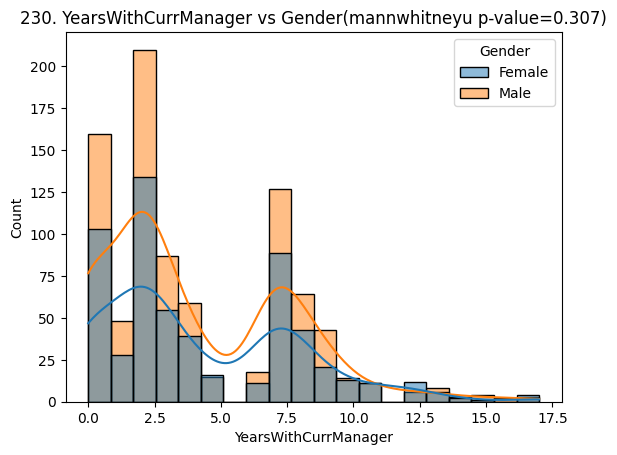

231. YearsWithCurrManager vs JobRole (kruskal p-value=0.0)


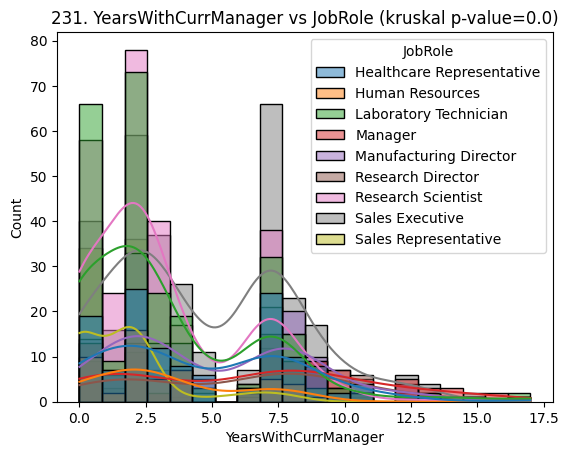

232. YearsWithCurrManager vs MaritalStatus (kruskal p-value=0.117)


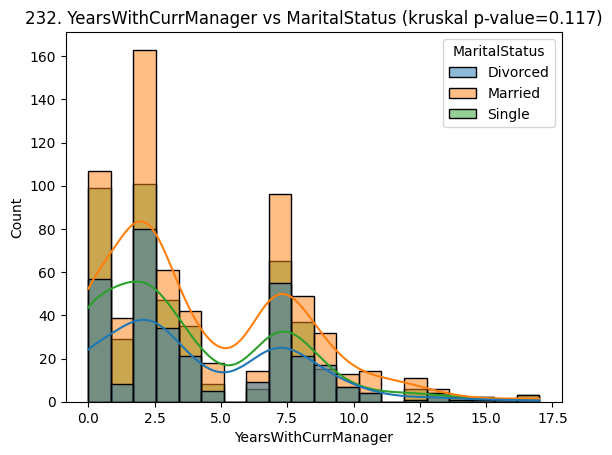

233. YearsWithCurrManager vs OverTime(mannwhitneyu p-value=0.122)


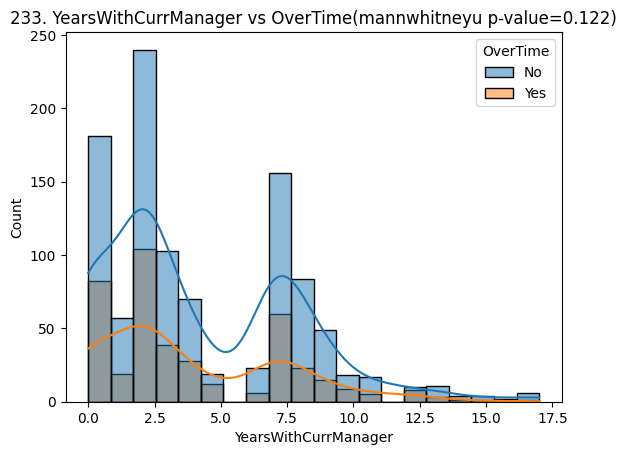

235. SalaryAddition vs BusinessTravel (kruskal p-value=0.775)


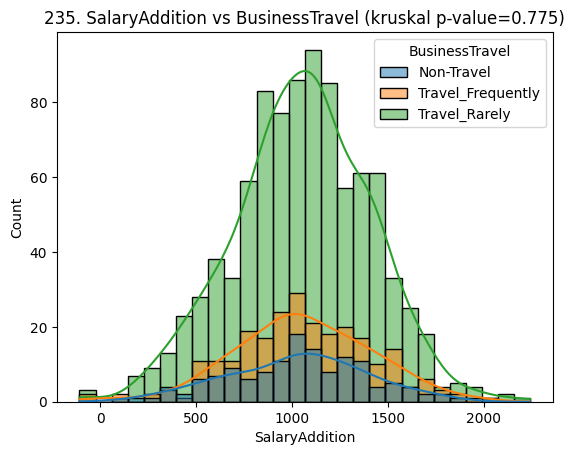

236. SalaryAddition vs Education (kruskal p-value=0.215)


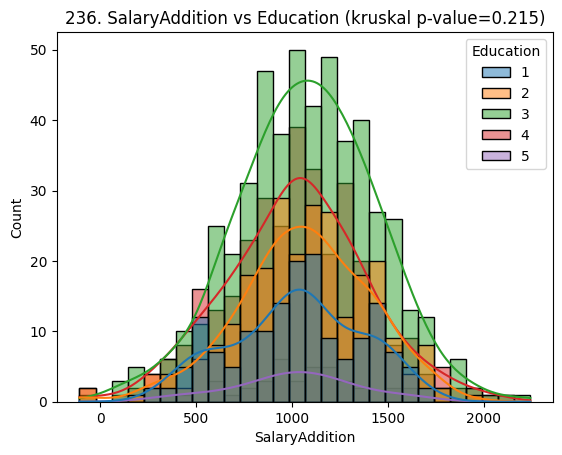

237. SalaryAddition vs EnvironmentSatisfaction (kruskal p-value=0.216)


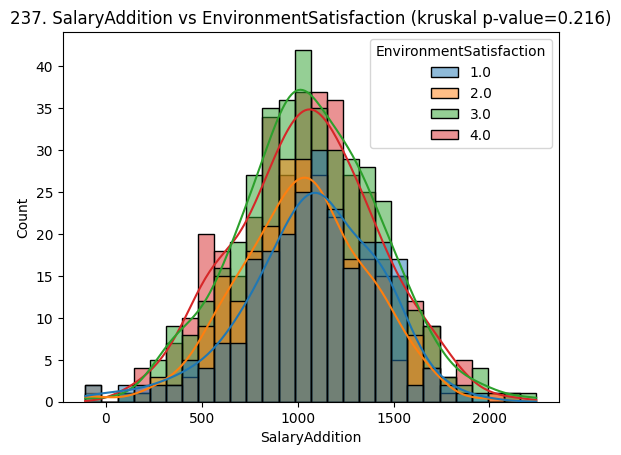

238. SalaryAddition vs JobInvolvement (kruskal p-value=0.72)


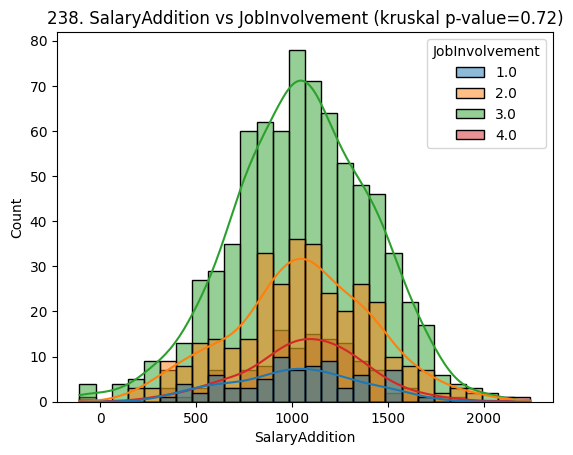

239. SalaryAddition vs JobLevel (kruskal p-value=0.83)


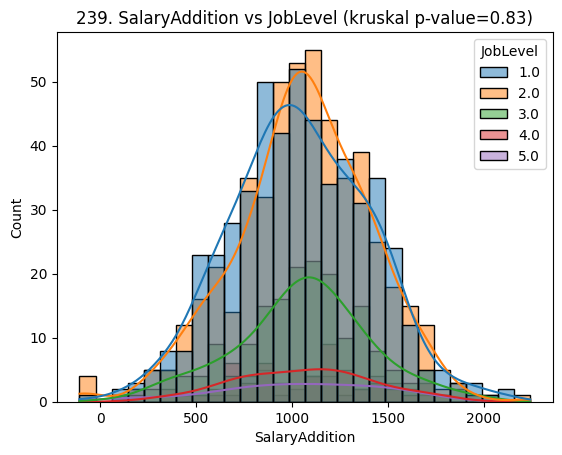

240. SalaryAddition vs JobSatisfaction (kruskal p-value=0.701)


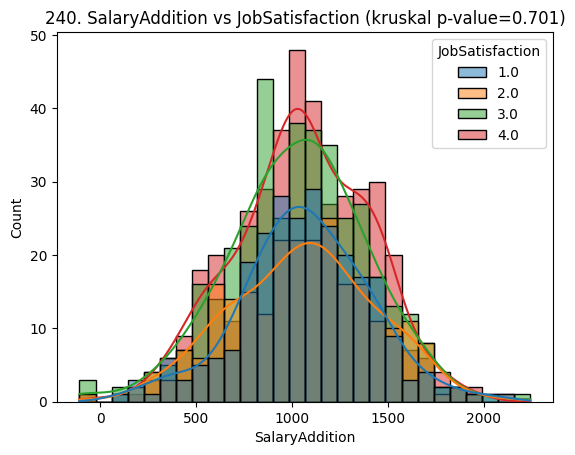

241. SalaryAddition vs PerformanceRating(mannwhitneyu p-value=0.033)


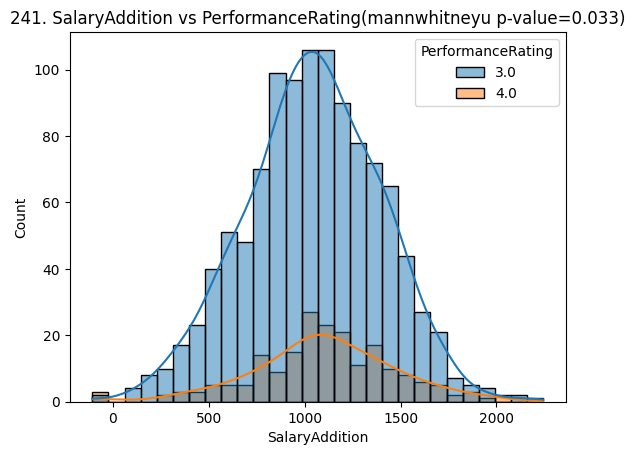

242. SalaryAddition vs RelationshipSatisfaction (kruskal p-value=0.011)


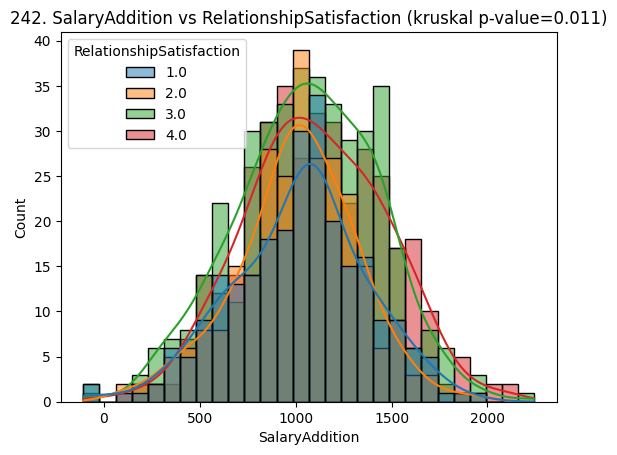

243. SalaryAddition vs StockOptionLevel (kruskal p-value=0.527)


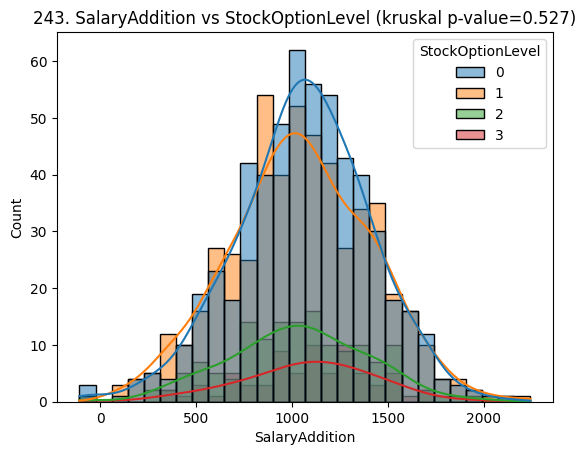

244. SalaryAddition vs WorkLifeBalance (kruskal p-value=0.679)


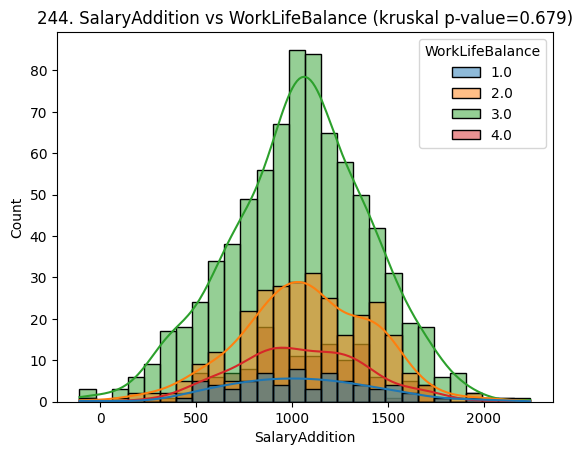

246. SalaryAddition vs Department (kruskal p-value=0.045)


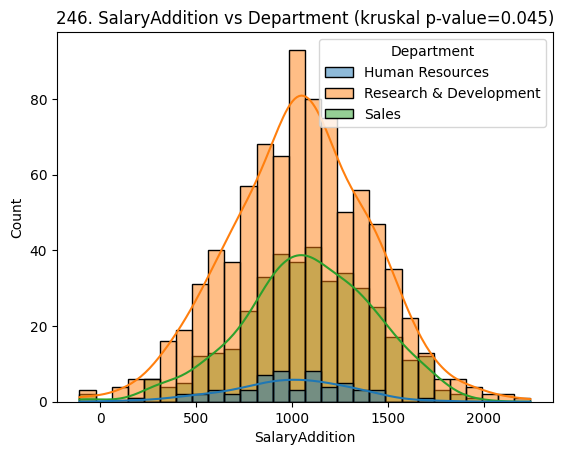

247. SalaryAddition vs EducationField (kruskal p-value=0.061)


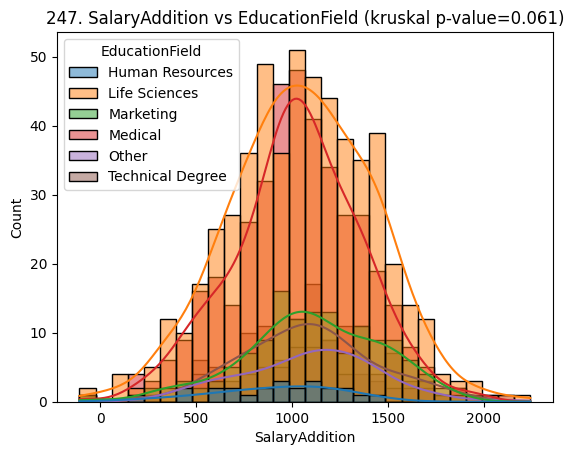

248. SalaryAddition vs Gender(mannwhitneyu p-value=0.891)


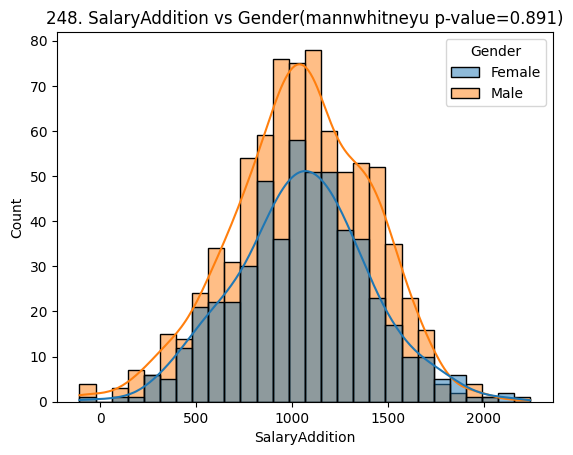

249. SalaryAddition vs JobRole (kruskal p-value=0.24)


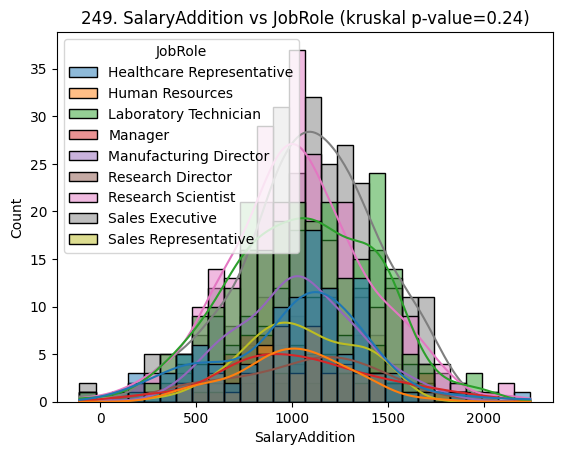

250. SalaryAddition vs MaritalStatus (kruskal p-value=0.176)


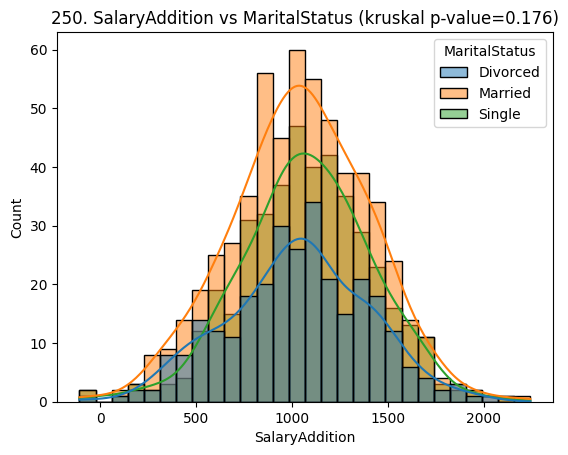

251. SalaryAddition vs OverTime(mannwhitneyu p-value=0.554)


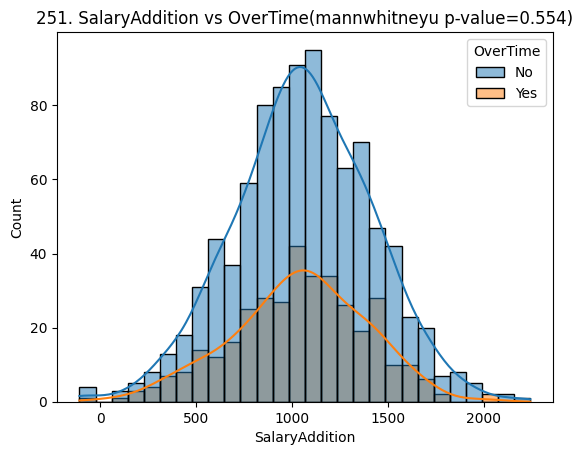

253. YearlyHollidayDays vs BusinessTravel (kruskal p-value=0.151)


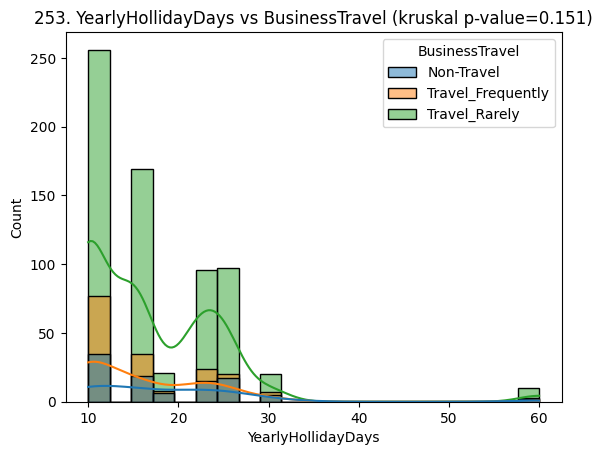

254. YearlyHollidayDays vs Education (kruskal p-value=0.892)


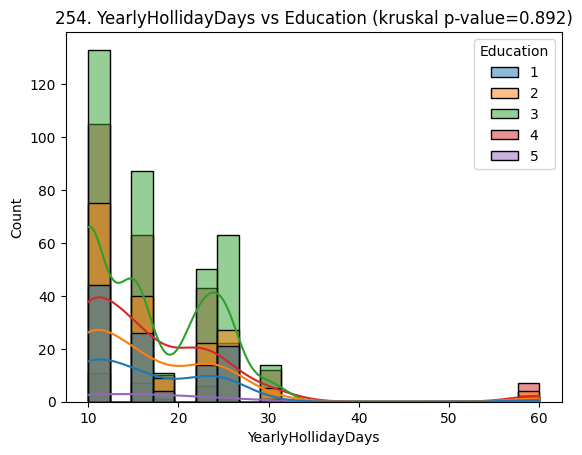

255. YearlyHollidayDays vs EnvironmentSatisfaction (kruskal p-value=0.808)


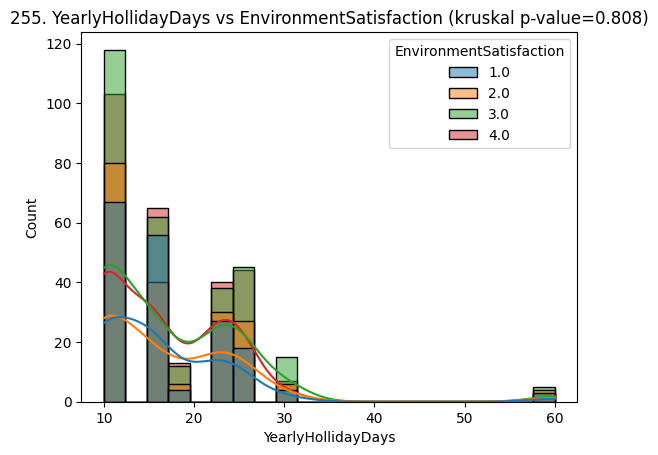

256. YearlyHollidayDays vs JobInvolvement (kruskal p-value=0.148)


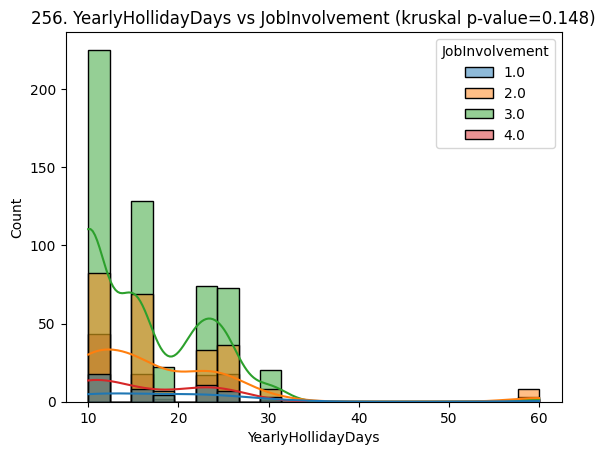

257. YearlyHollidayDays vs JobLevel (kruskal p-value=0.334)


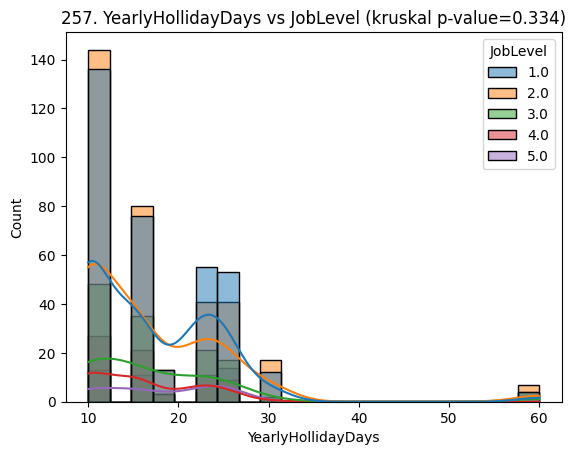

258. YearlyHollidayDays vs JobSatisfaction (kruskal p-value=0.325)


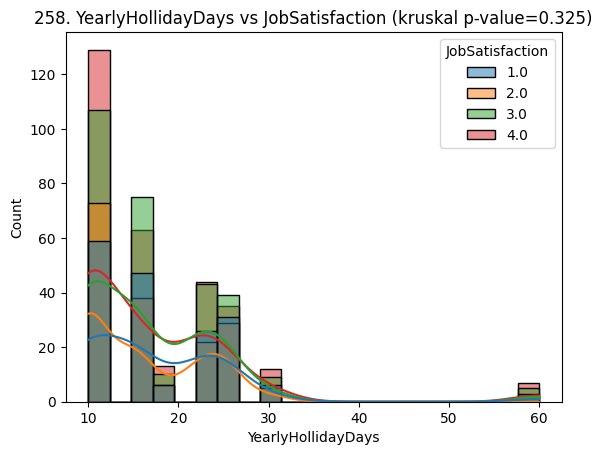

259. YearlyHollidayDays vs PerformanceRating(mannwhitneyu p-value=0.79)


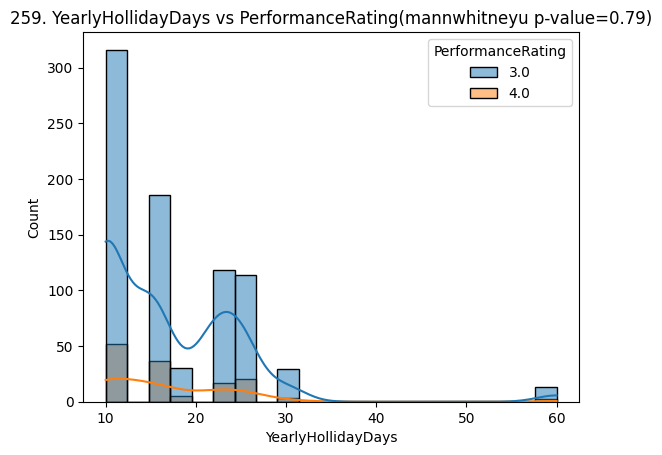

260. YearlyHollidayDays vs RelationshipSatisfaction (kruskal p-value=0.826)


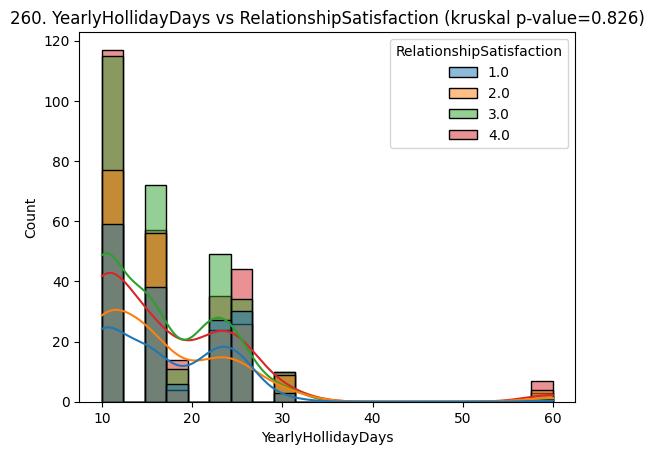

261. YearlyHollidayDays vs StockOptionLevel (kruskal p-value=0.991)


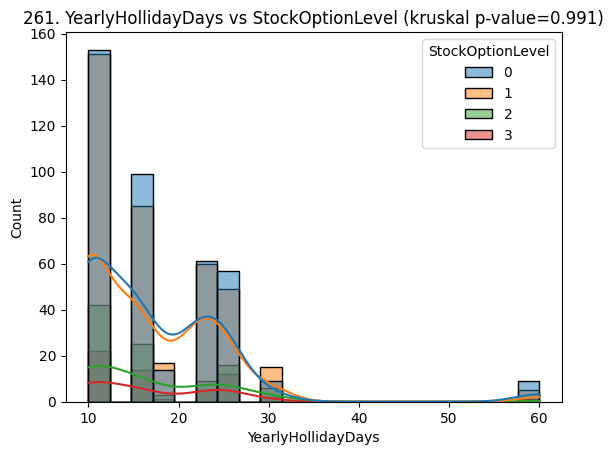

262. YearlyHollidayDays vs WorkLifeBalance (kruskal p-value=0.127)


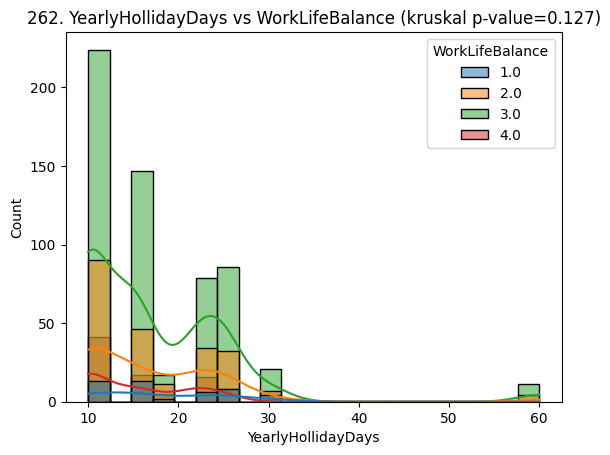

264. YearlyHollidayDays vs Department (kruskal p-value=0.005)


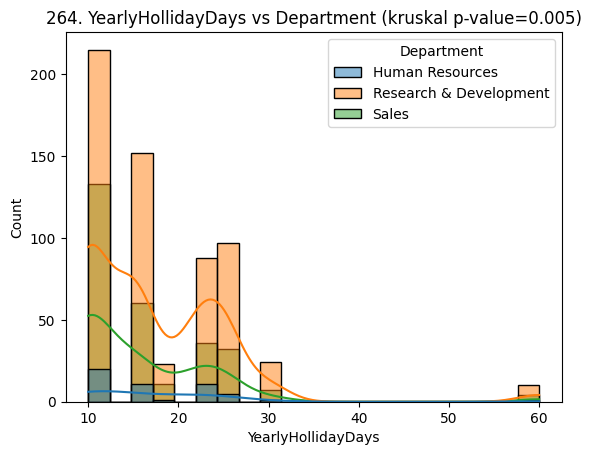

265. YearlyHollidayDays vs EducationField (kruskal p-value=0.145)


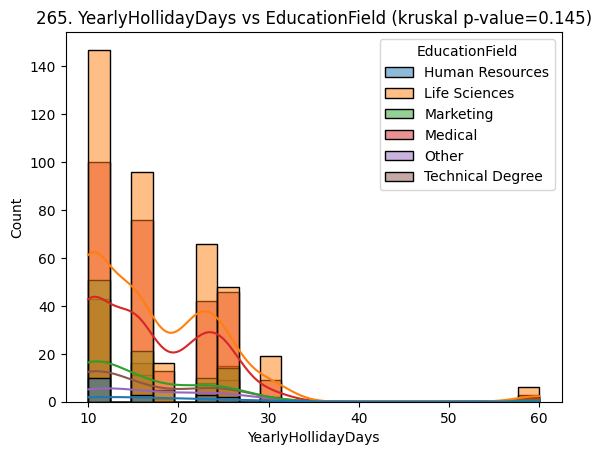

266. YearlyHollidayDays vs Gender(mannwhitneyu p-value=0.929)


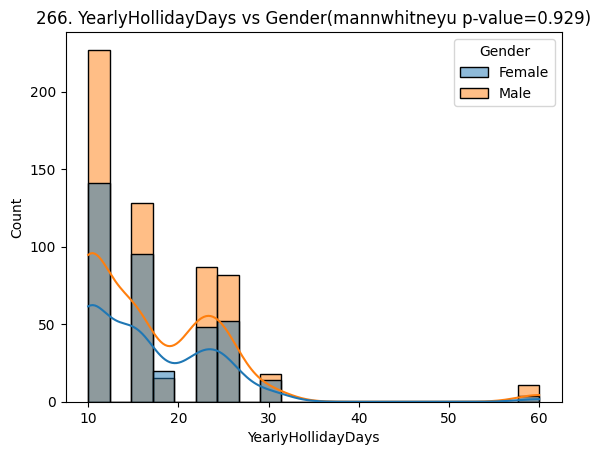

267. YearlyHollidayDays vs JobRole (kruskal p-value=0.049)


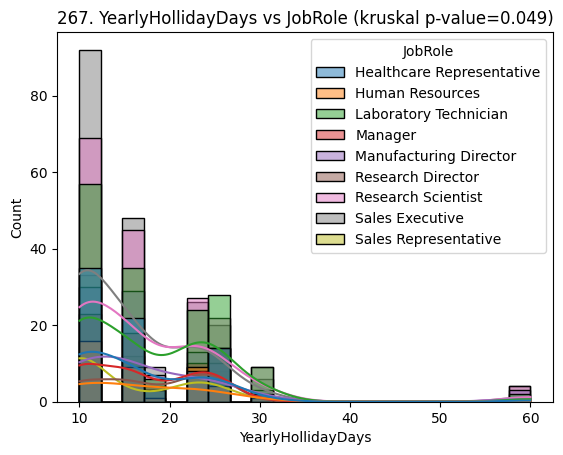

268. YearlyHollidayDays vs MaritalStatus (kruskal p-value=0.948)


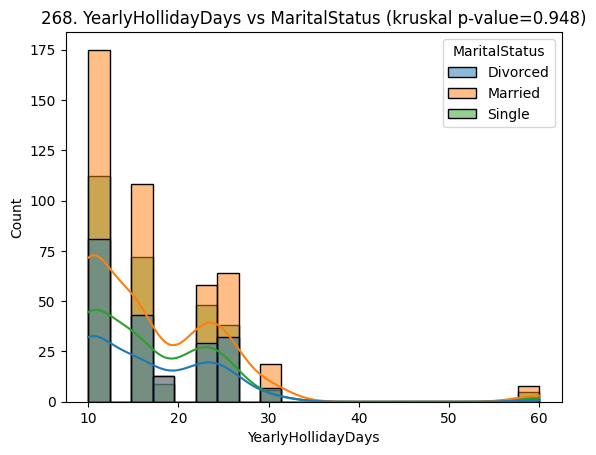

269. YearlyHollidayDays vs OverTime(mannwhitneyu p-value=0.865)


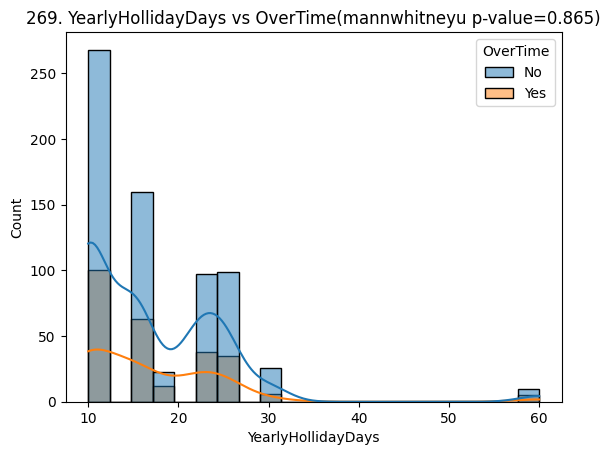

271. TrainingTimesLastYear vs BusinessTravel (kruskal p-value=0.611)


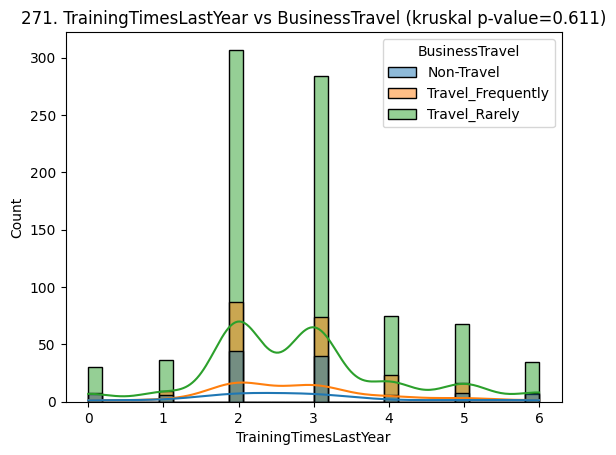

272. TrainingTimesLastYear vs Education (kruskal p-value=0.419)


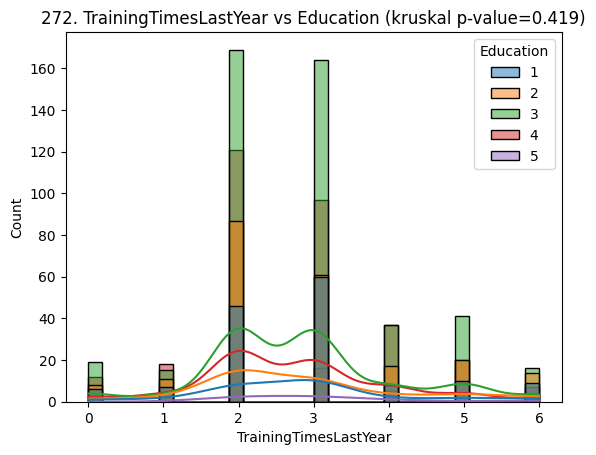

273. TrainingTimesLastYear vs EnvironmentSatisfaction (kruskal p-value=0.892)


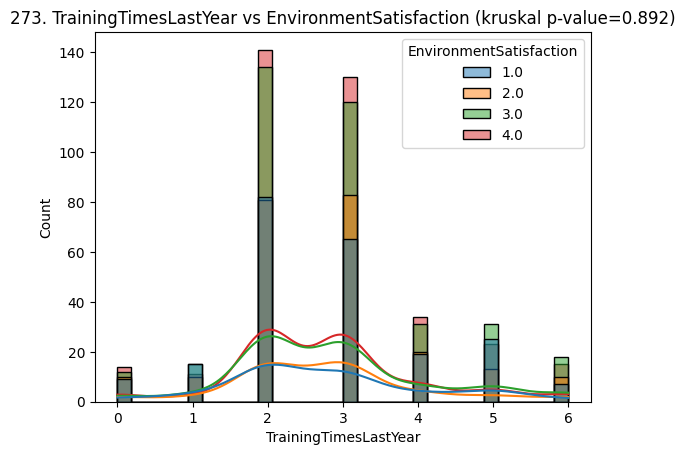

274. TrainingTimesLastYear vs JobInvolvement (kruskal p-value=0.566)


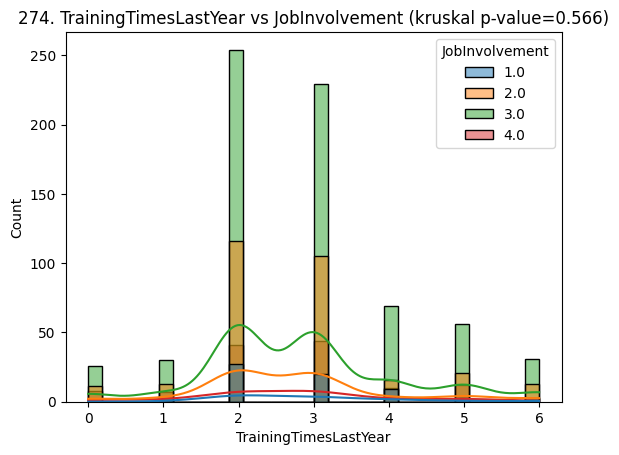

275. TrainingTimesLastYear vs JobLevel (kruskal p-value=0.471)


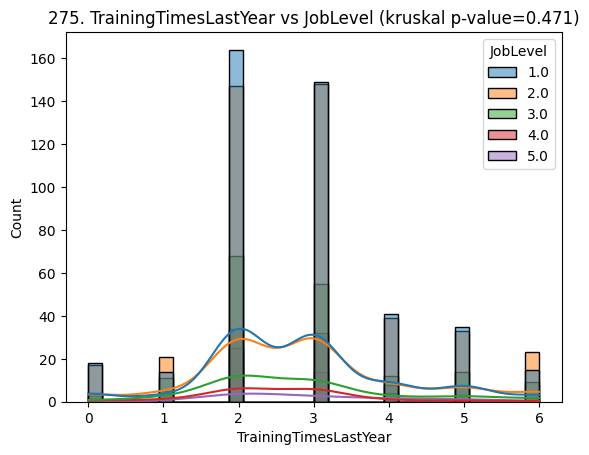

276. TrainingTimesLastYear vs JobSatisfaction (kruskal p-value=0.617)


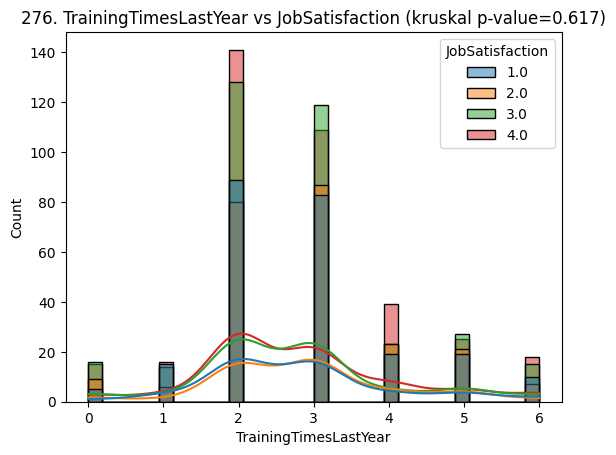

277. TrainingTimesLastYear vs PerformanceRating(mannwhitneyu p-value=0.376)


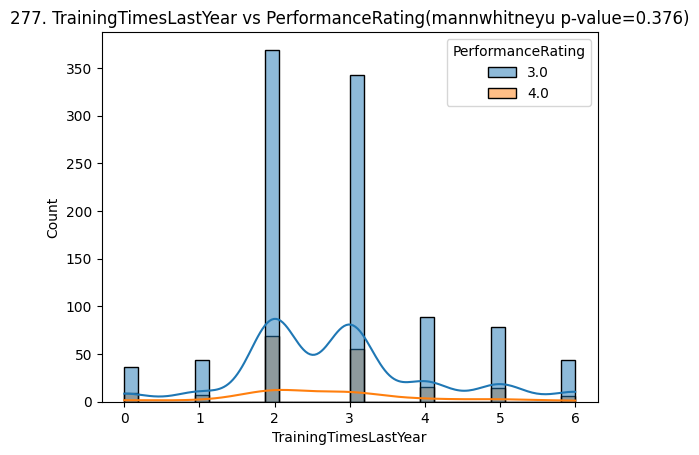

278. TrainingTimesLastYear vs RelationshipSatisfaction (kruskal p-value=0.899)


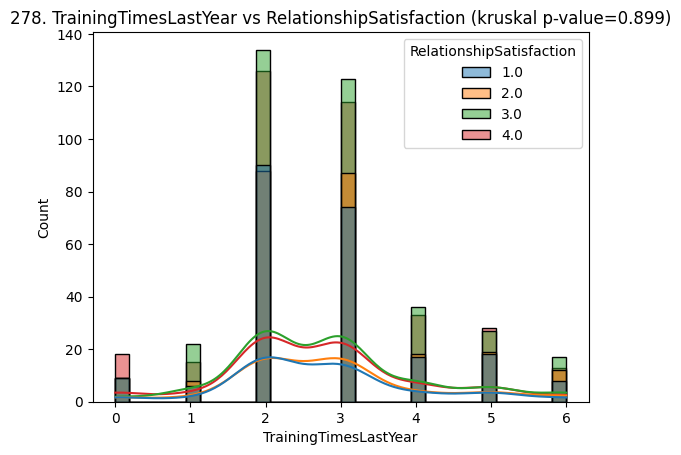

279. TrainingTimesLastYear vs StockOptionLevel (kruskal p-value=0.49)


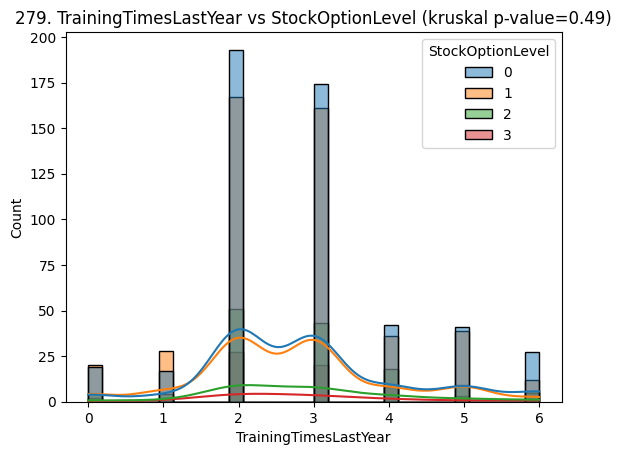

280. TrainingTimesLastYear vs WorkLifeBalance (kruskal p-value=0.7)


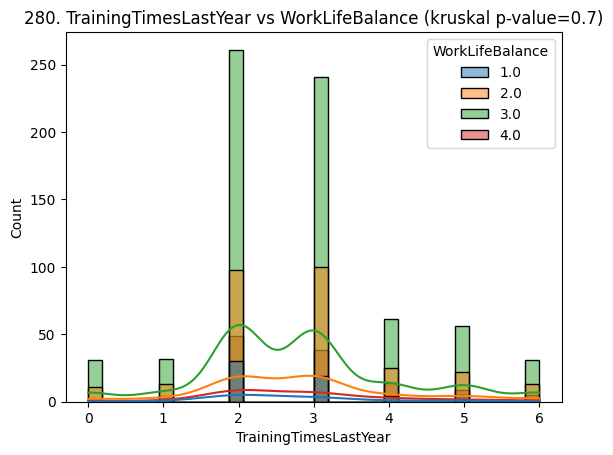

282. TrainingTimesLastYear vs Department (kruskal p-value=0.575)


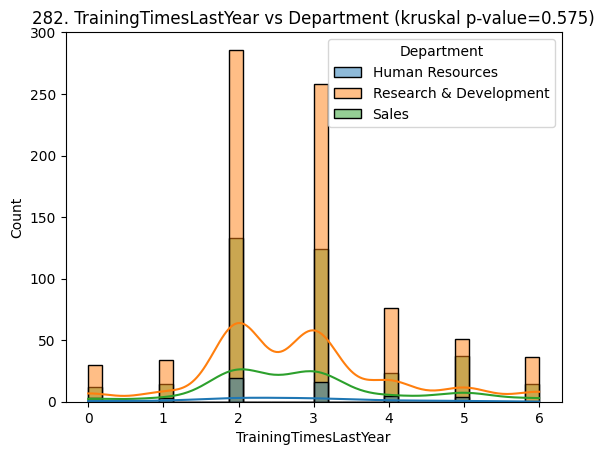

283. TrainingTimesLastYear vs EducationField (kruskal p-value=0.566)


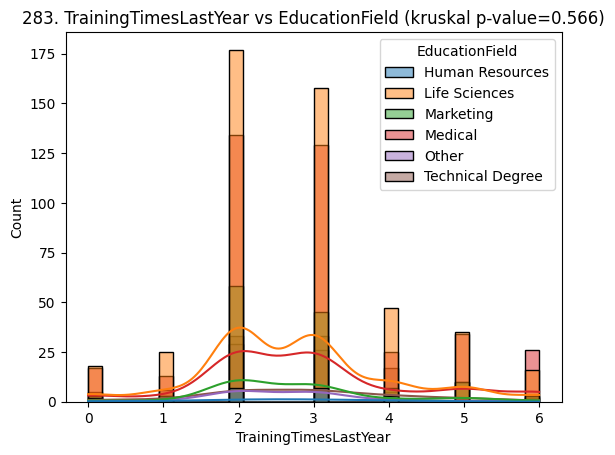

284. TrainingTimesLastYear vs Gender(mannwhitneyu p-value=0.199)


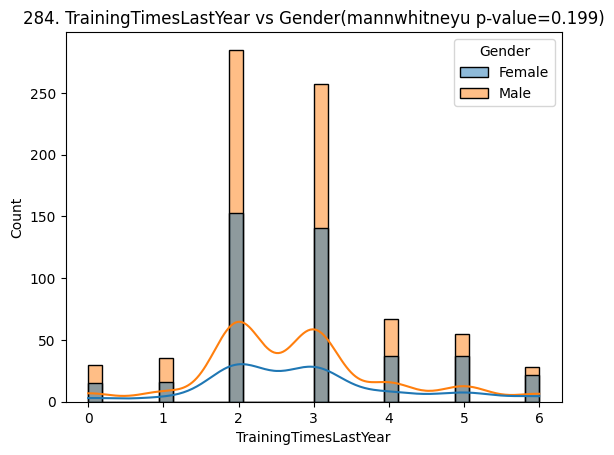

285. TrainingTimesLastYear vs JobRole (kruskal p-value=0.445)


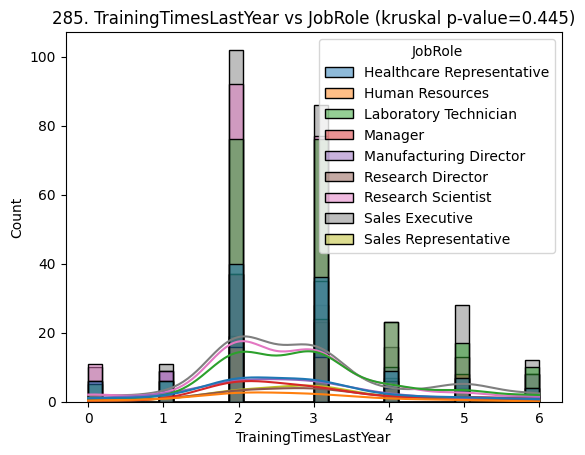

286. TrainingTimesLastYear vs MaritalStatus (kruskal p-value=0.584)


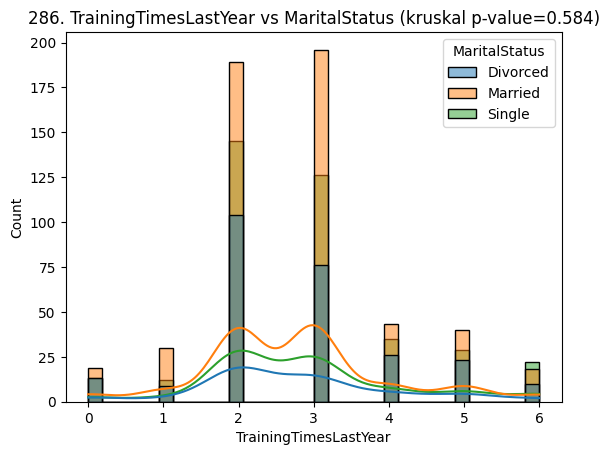

287. TrainingTimesLastYear vs OverTime(mannwhitneyu p-value=0.006)


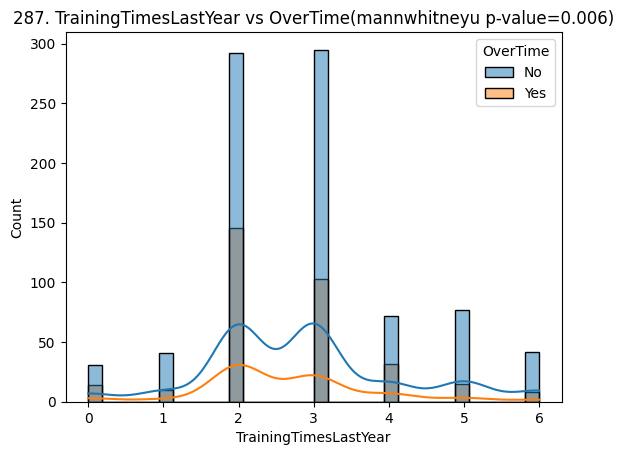

289. DrivingKilometers vs BusinessTravel (kruskal p-value=0.873)


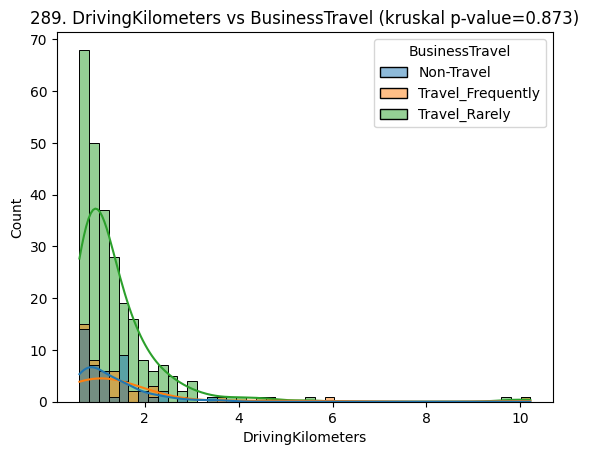

290. DrivingKilometers vs Education (kruskal p-value=0.693)


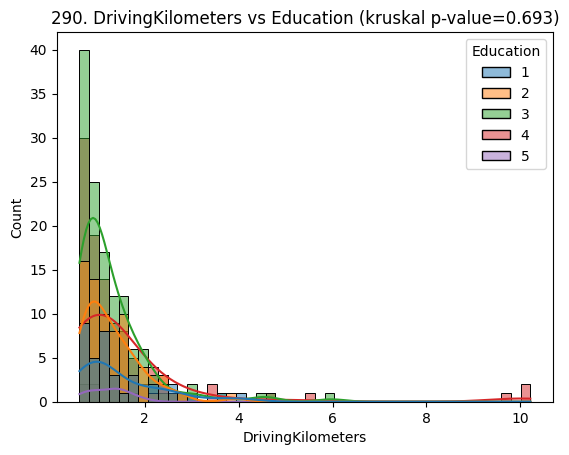

291. DrivingKilometers vs EnvironmentSatisfaction (kruskal p-value=0.681)


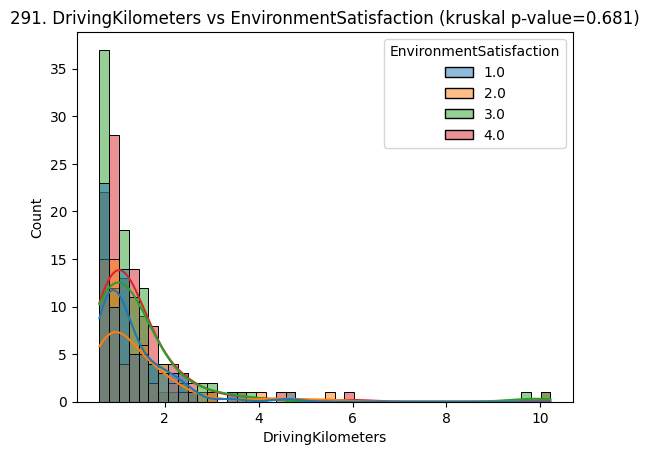

292. DrivingKilometers vs JobInvolvement (kruskal p-value=0.834)


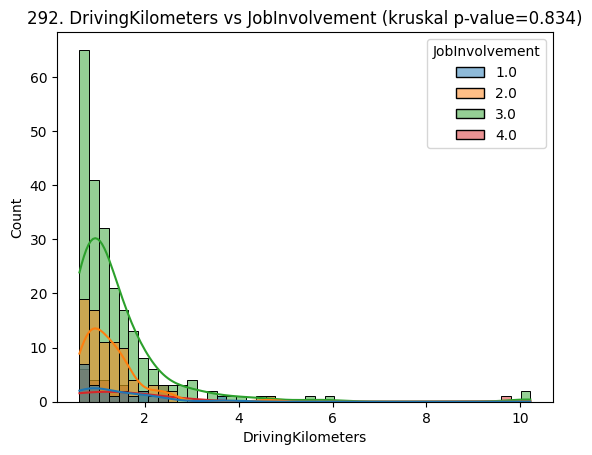

293. DrivingKilometers vs JobLevel (kruskal p-value=0.162)


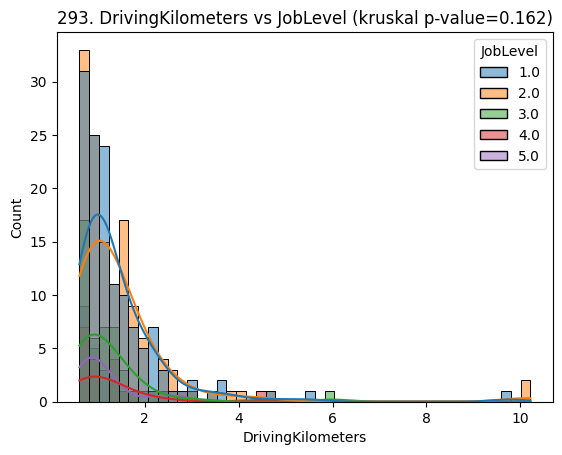

294. DrivingKilometers vs JobSatisfaction (kruskal p-value=0.445)


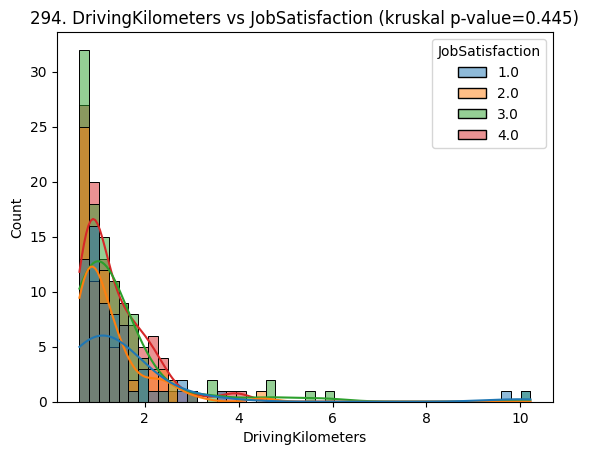

295. DrivingKilometers vs PerformanceRating(mannwhitneyu p-value=0.999)


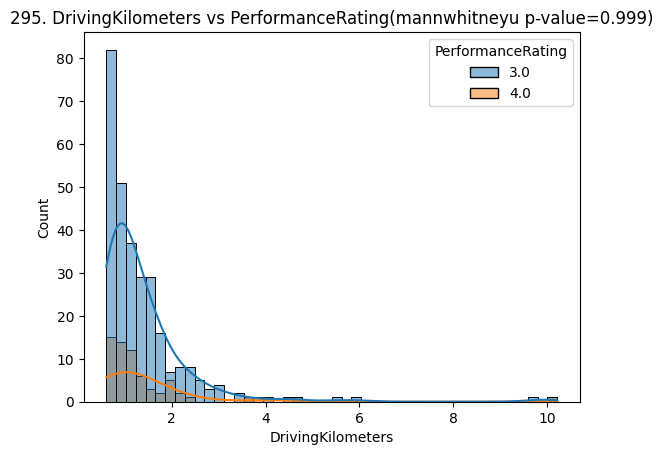

296. DrivingKilometers vs RelationshipSatisfaction (kruskal p-value=0.47)


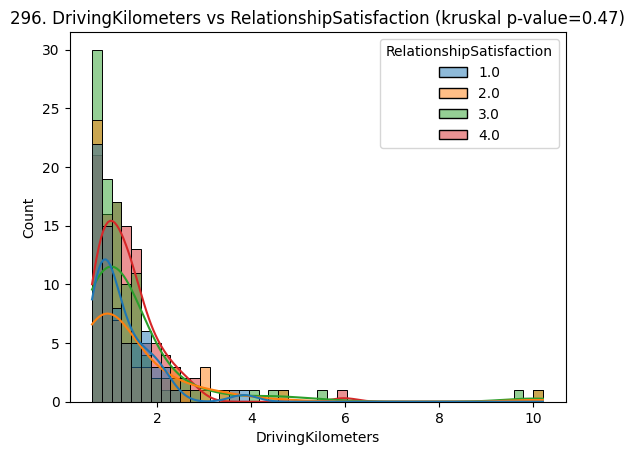

297. DrivingKilometers vs StockOptionLevel (kruskal p-value=0.806)


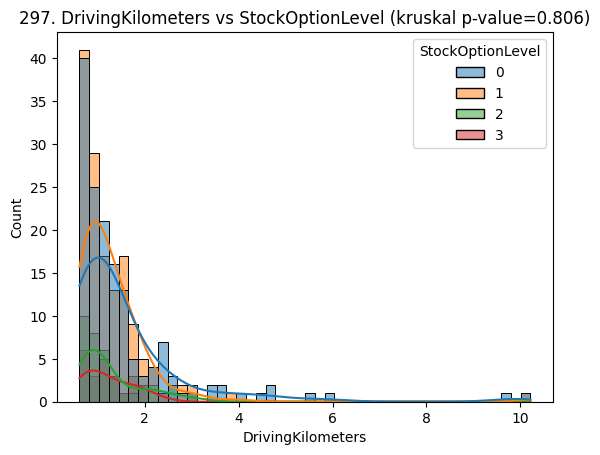

298. DrivingKilometers vs WorkLifeBalance (kruskal p-value=0.661)


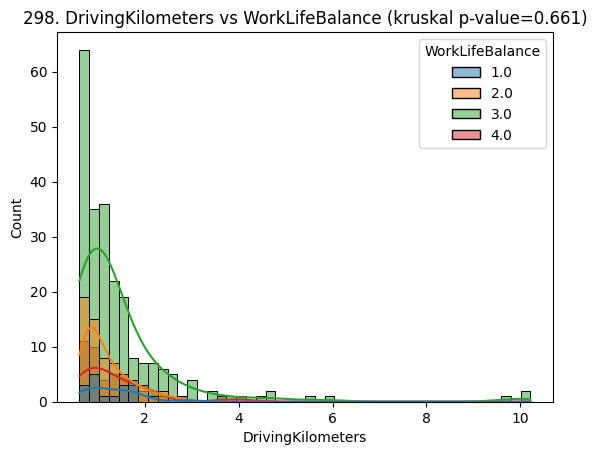

300. DrivingKilometers vs Department (kruskal p-value=0.795)


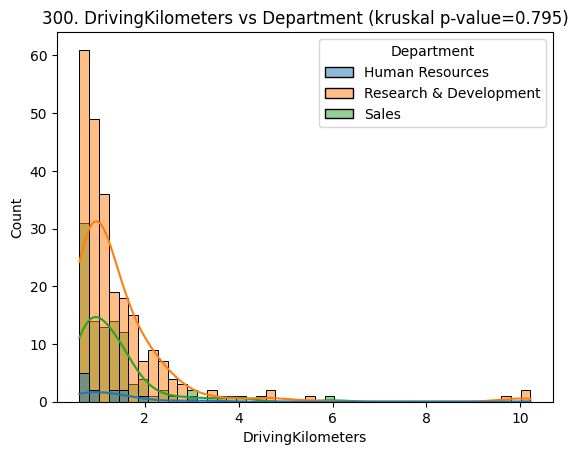

301. DrivingKilometers vs EducationField (kruskal p-value=0.961)


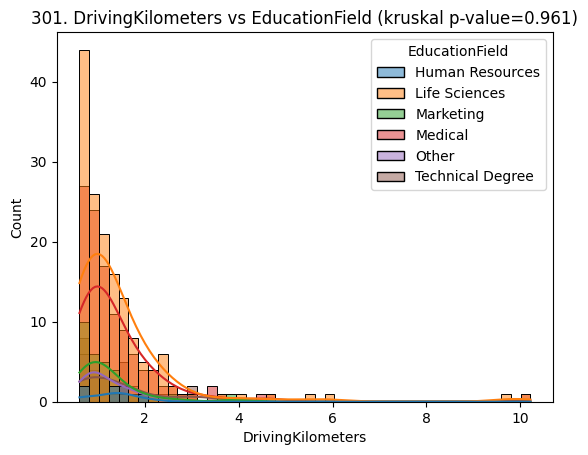

302. DrivingKilometers vs Gender(mannwhitneyu p-value=0.064)


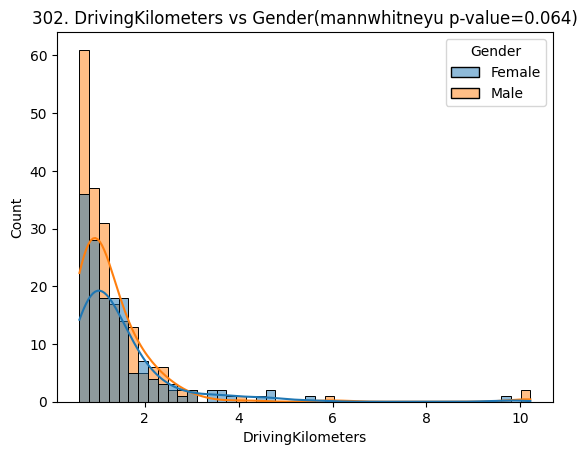

303. DrivingKilometers vs JobRole (kruskal p-value=0.834)


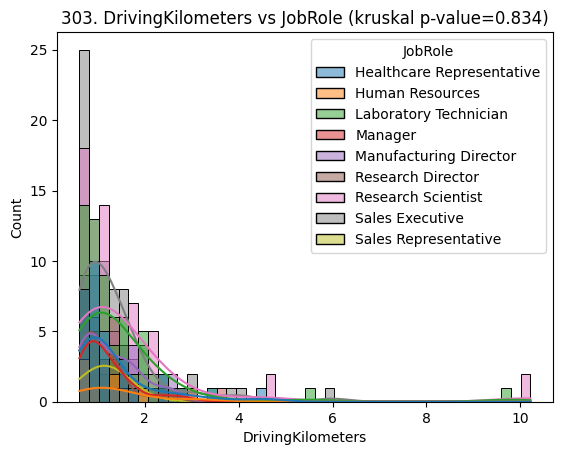

304. DrivingKilometers vs MaritalStatus (kruskal p-value=0.398)


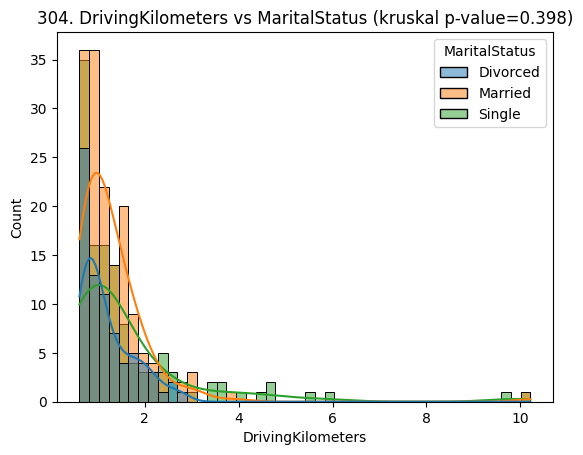

305. DrivingKilometers vs OverTime(mannwhitneyu p-value=0.738)


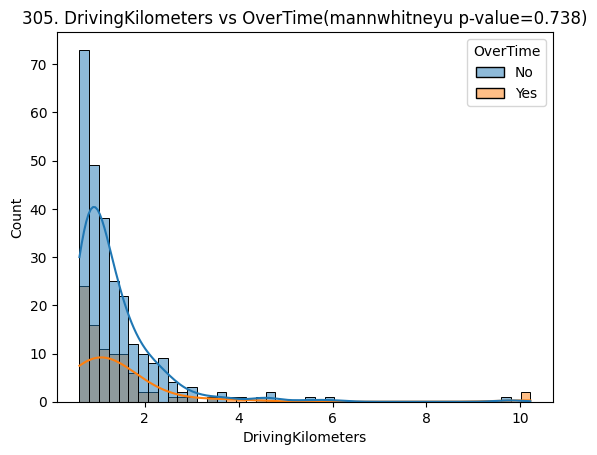

In [ ]:
from scipy.stats import kruskal, mannwhitneyu

total_idx = 0

for i in range(0,len(numvar)):
    for j in range(0,len(catvar)):
        total_idx = total_idx + 1
        title = numvar[i]," vs ", catvar[j]
        df1 = df[[numvar[i],catvar[j]]].dropna()
        catgrp = []
        for c in df1[catvar[j]].cat.categories:
            catgrp.append(np.array(list(df1.loc[df1[catvar[j]]==c,numvar[i]])))

        if (len(catgrp)==1):
            # this is constant
            continue
        elif (len(catgrp)==2):
            mu = mannwhitneyu(*catgrp)
            cl = ['red' if mu[1] < 0.05 else 'green']
            bg = ['Yellow' if mu[1] < 0.05 else 'white']
            title = str(total_idx) + ". " + numvar[i] + ' vs ' + catvar[j] + '(mannwhitneyu p-value=' + str(round(mu[1],3)) + ')'
        else:
            mu = kruskal(*catgrp)
            cl = ['red' if mu[1] < 0.05 else 'green']
            bg = ['Yellow' if mu[1] < 0.05 else 'white']
            title = str(total_idx) + ". " + numvar[i] + ' vs ' + catvar[j] +  ' (kruskal p-value=' + str(round(mu[1],3)) + ')'

        print(title)
        sns.histplot(x=df1[numvar[i]], hue=df1[catvar[j]], kde=True).set_title(title)
        plt.show()

In [ ]:
# To make it more consice: next graph prints only the signifcatnly different distributions according to the category

1. Age vs Education (kruskal p-value=0.0)


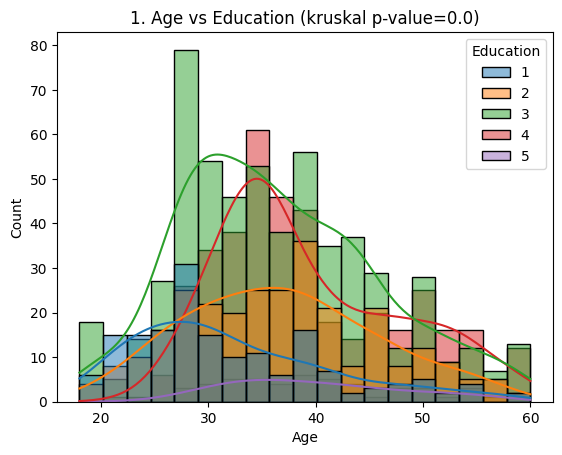

2. Age vs JobLevel (kruskal p-value=0.0)


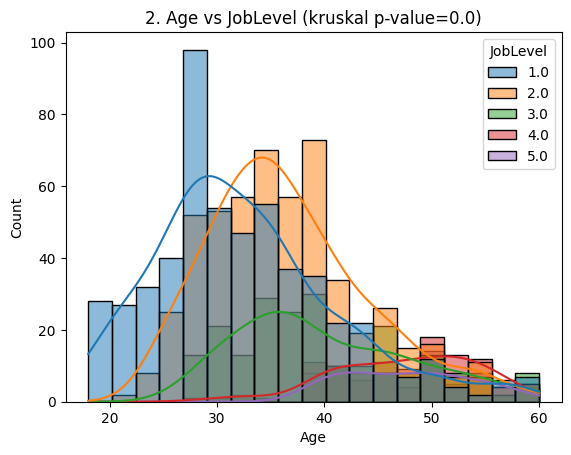

3. Age vs StockOptionLevel (kruskal p-value=0.001)


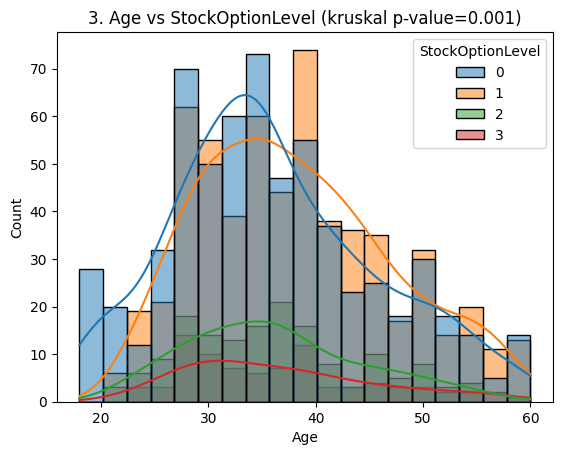

4. Age vs JobRole (kruskal p-value=0.0)


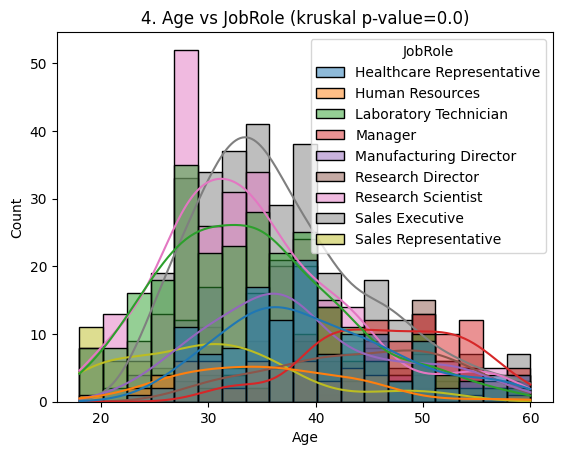

5. Age vs MaritalStatus (kruskal p-value=0.0)


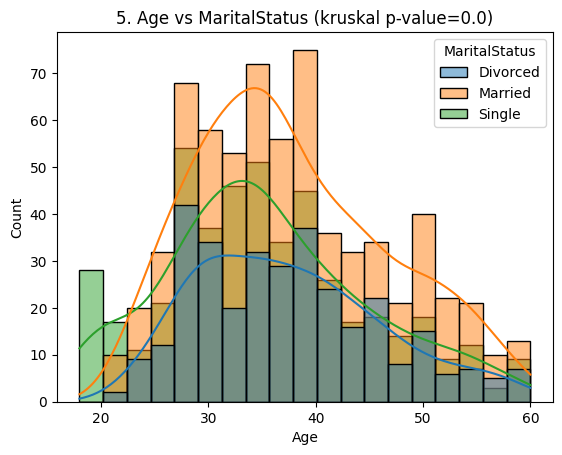

6. DailyRate vs MaritalStatus (kruskal p-value=0.013)


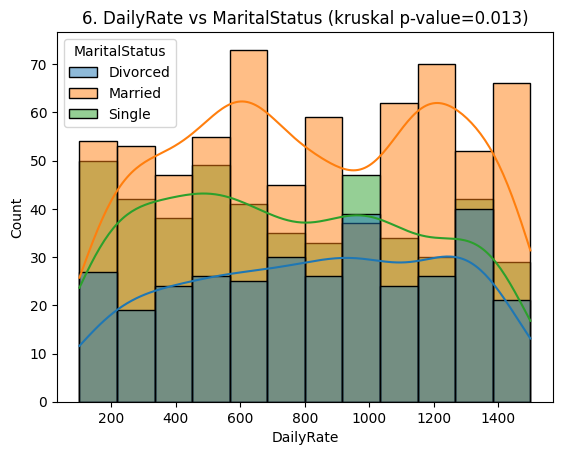

7. DistanceFromHome vs JobLevel (kruskal p-value=0.016)


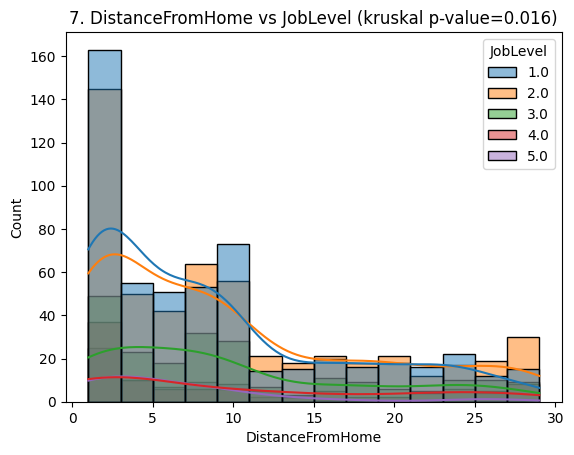

8. DistanceFromHome vs StockOptionLevel (kruskal p-value=0.043)


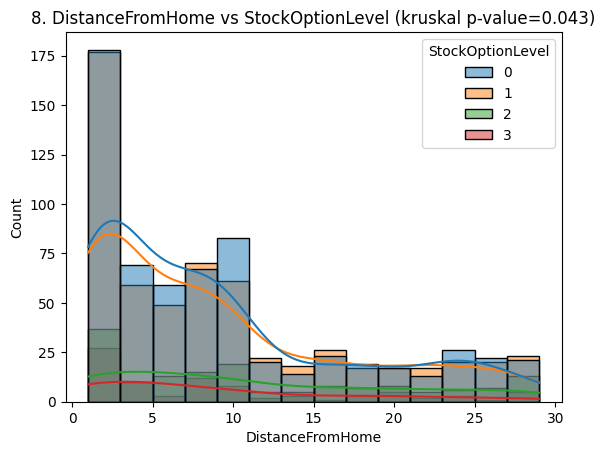

9. HourlyRate vs JobSatisfaction (kruskal p-value=0.04)


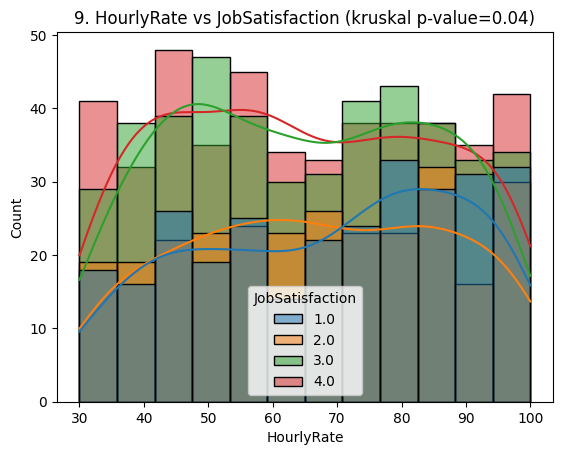

10. MonthlyIncome vs Education (kruskal p-value=0.0)


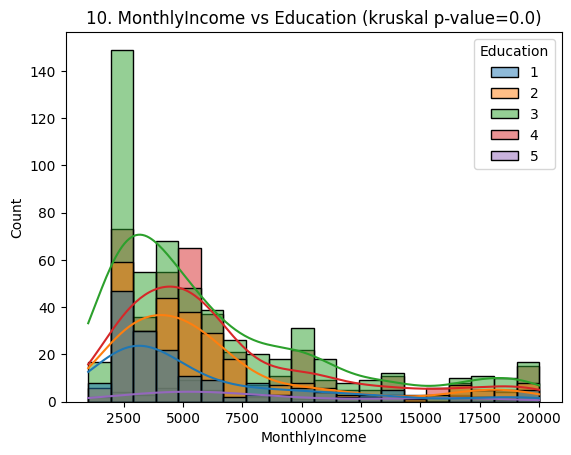

11. MonthlyIncome vs JobLevel (kruskal p-value=0.0)


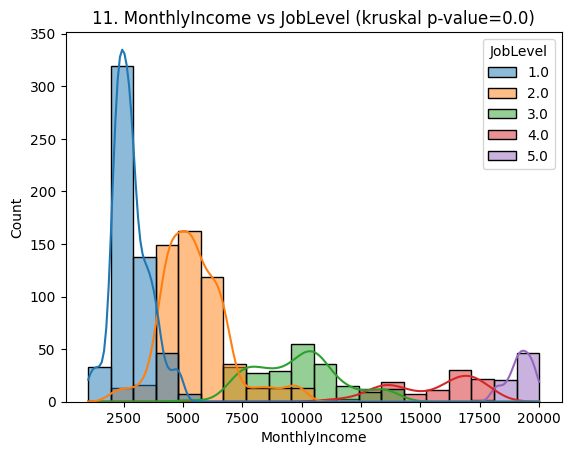

12. MonthlyIncome vs StockOptionLevel (kruskal p-value=0.009)


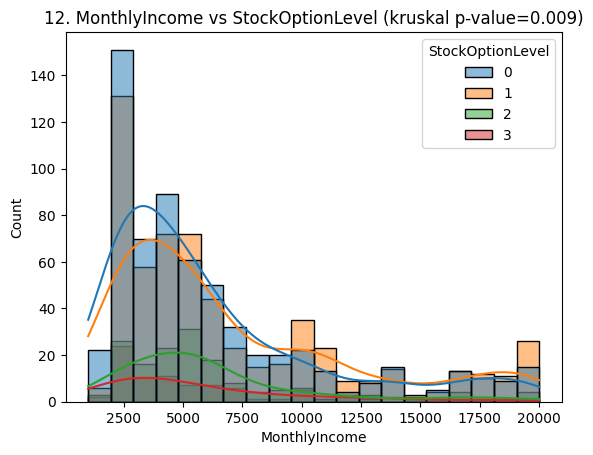

13. MonthlyIncome vs Department (kruskal p-value=0.0)


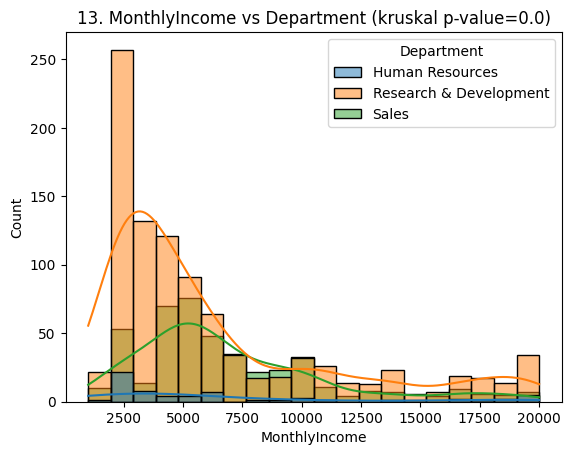

14. MonthlyIncome vs EducationField (kruskal p-value=0.0)


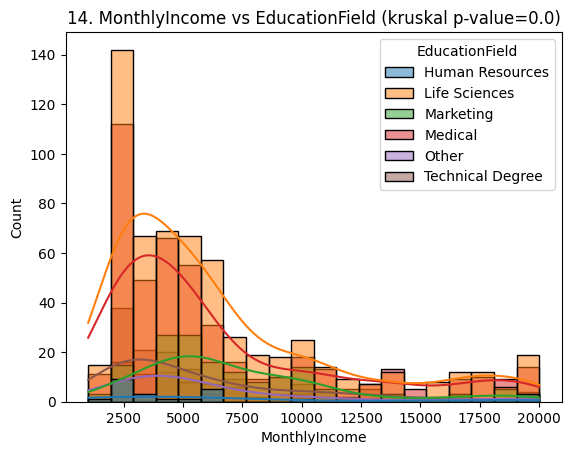

15. MonthlyIncome vs JobRole (kruskal p-value=0.0)


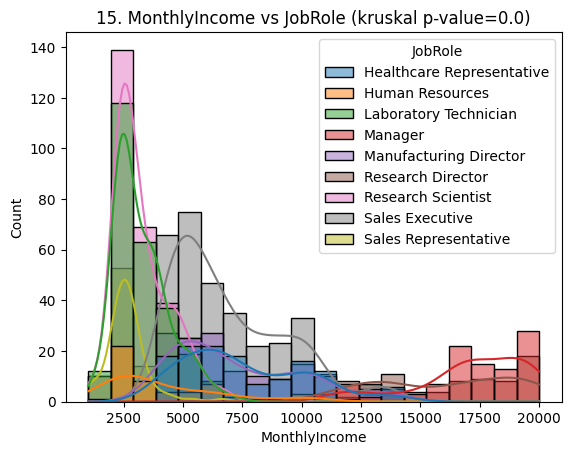

16. MonthlyIncome vs MaritalStatus (kruskal p-value=0.002)


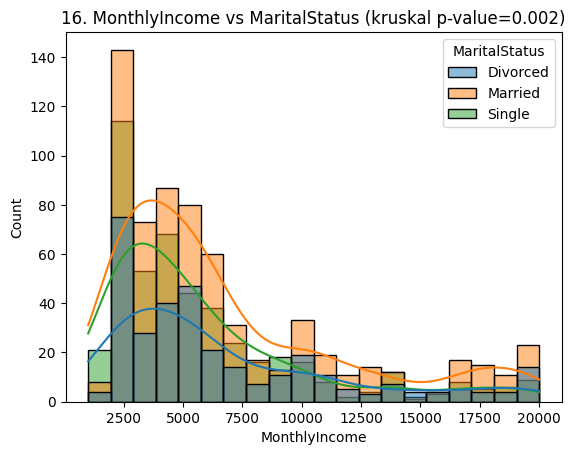

17. NumCompaniesWorked vs Education (kruskal p-value=0.0)


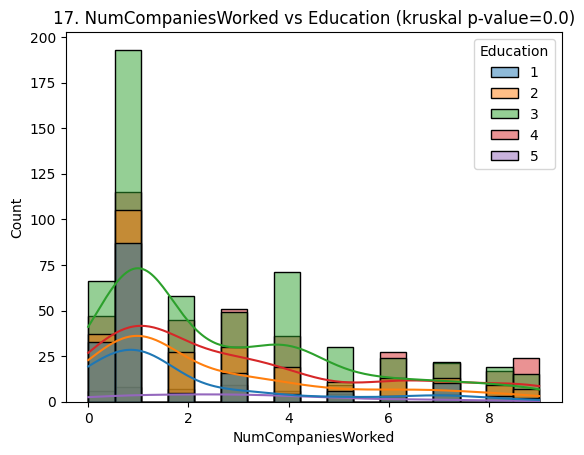

18. NumCompaniesWorked vs JobLevel (kruskal p-value=0.0)


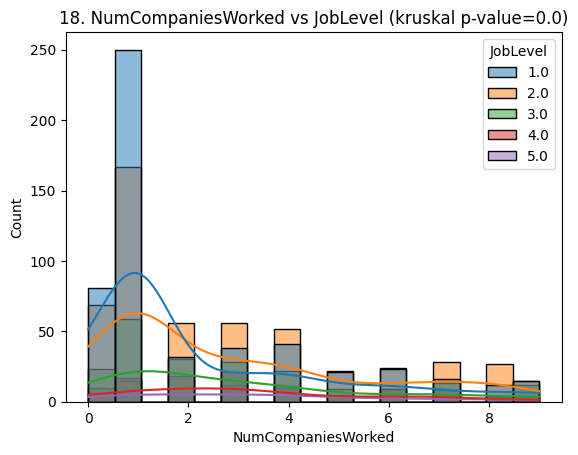

19. NumCompaniesWorked vs JobRole (kruskal p-value=0.0)


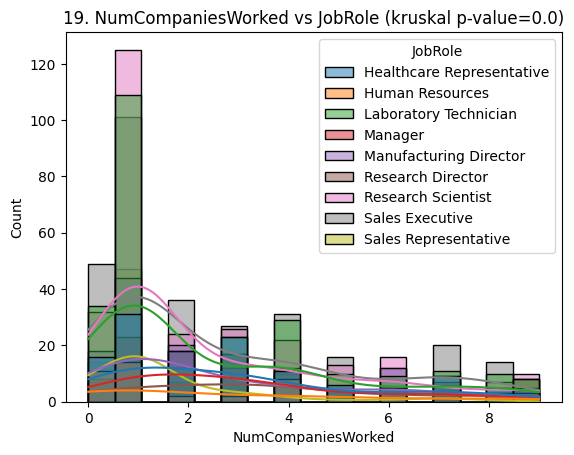

20. PercentSalaryHike vs PerformanceRating(mannwhitneyu p-value=0.0)


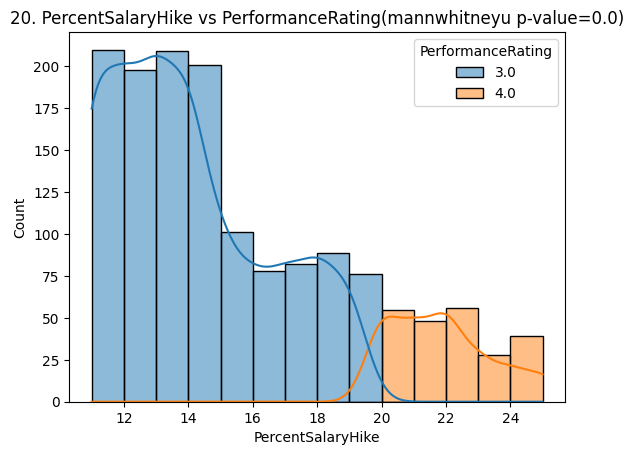

21. TotalWorkingYears vs Education (kruskal p-value=0.0)


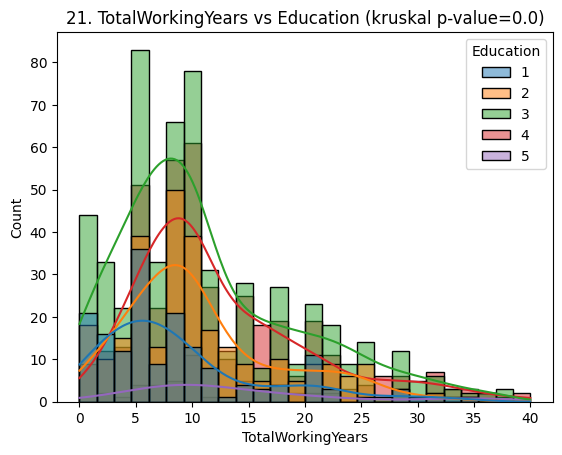

22. TotalWorkingYears vs JobLevel (kruskal p-value=0.0)


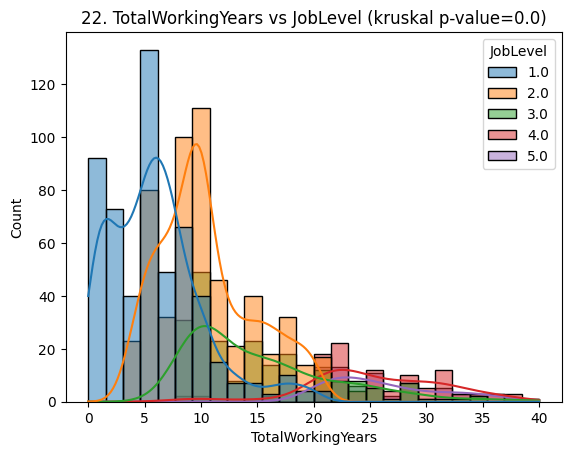

23. TotalWorkingYears vs StockOptionLevel (kruskal p-value=0.003)


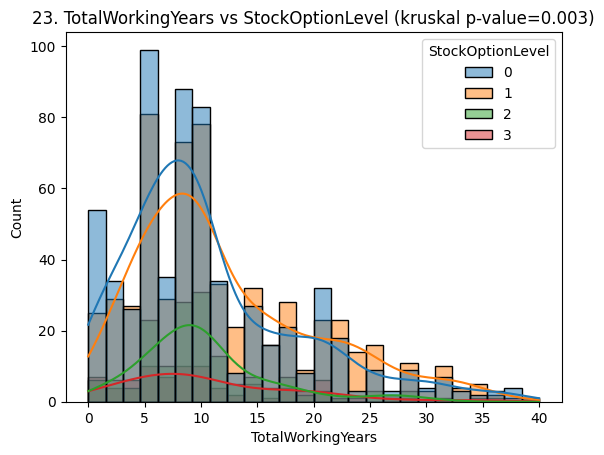

24. TotalWorkingYears vs JobRole (kruskal p-value=0.0)


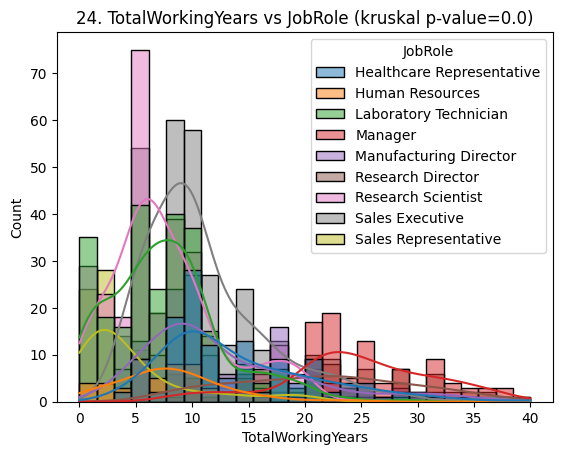

25. TotalWorkingYears vs MaritalStatus (kruskal p-value=0.001)


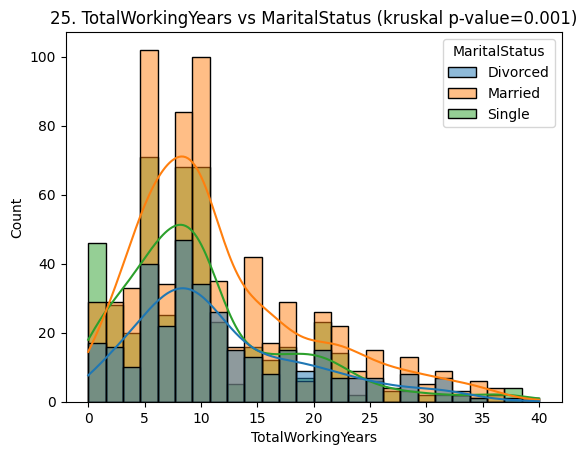

26. YearsAtCompany vs JobLevel (kruskal p-value=0.0)


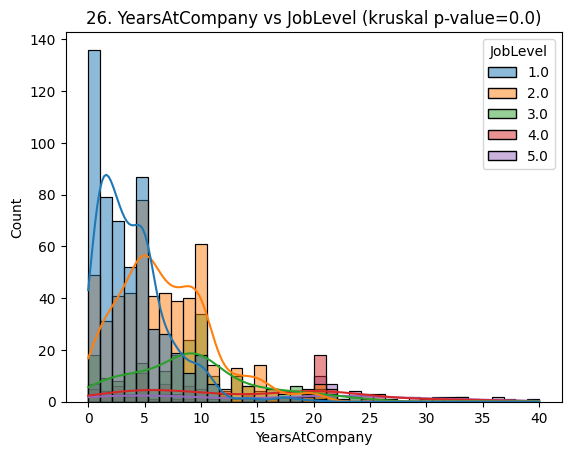

27. YearsAtCompany vs StockOptionLevel (kruskal p-value=0.005)


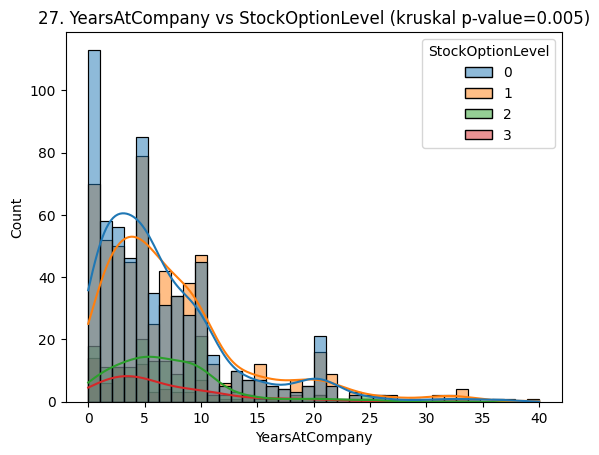

28. YearsAtCompany vs JobRole (kruskal p-value=0.0)


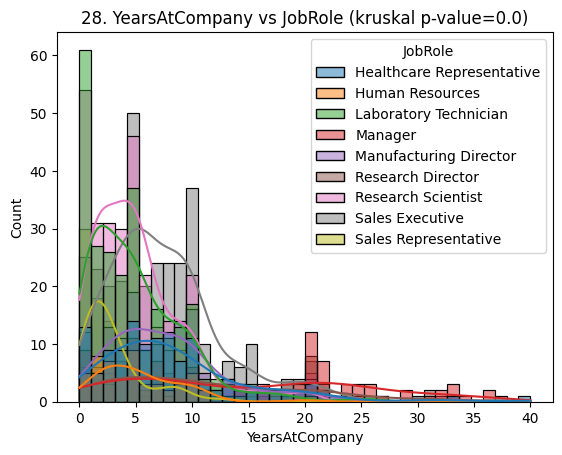

29. YearsAtCompany vs MaritalStatus (kruskal p-value=0.005)


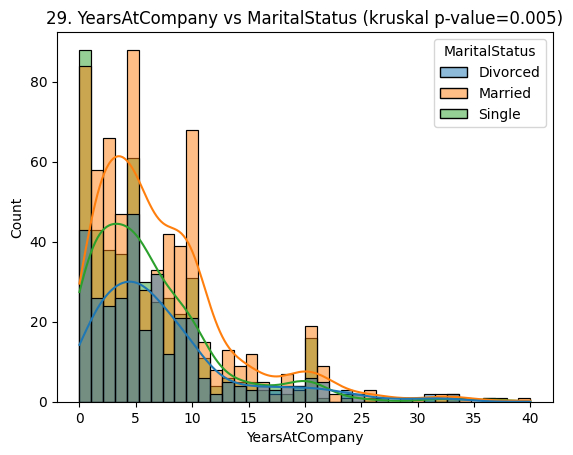

30. YearsInCurrentRole vs JobLevel (kruskal p-value=0.0)


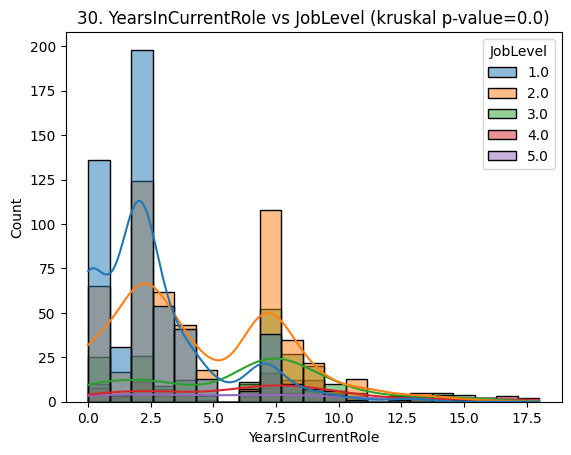

31. YearsInCurrentRole vs StockOptionLevel (kruskal p-value=0.016)


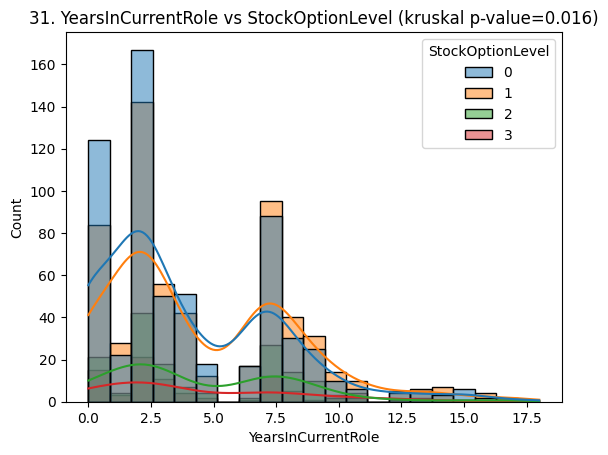

32. YearsInCurrentRole vs JobRole (kruskal p-value=0.0)


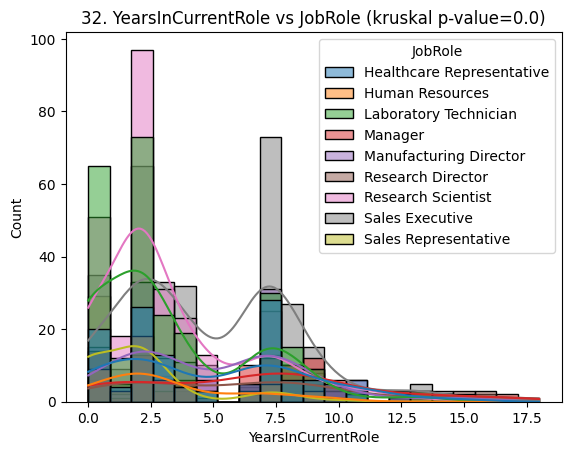

33. YearsInCurrentRole vs MaritalStatus (kruskal p-value=0.005)


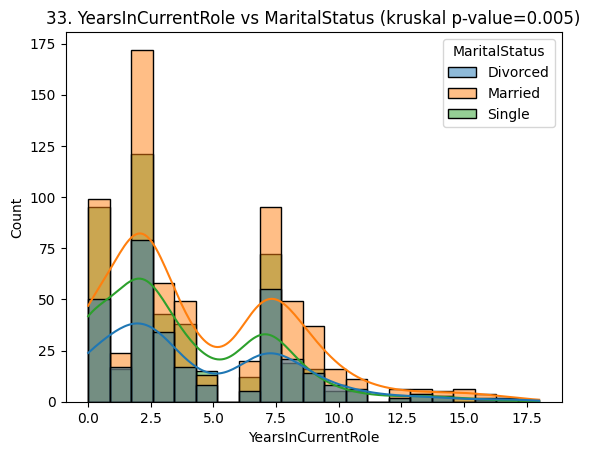

34. YearsSinceLastPromotion vs JobLevel (kruskal p-value=0.0)


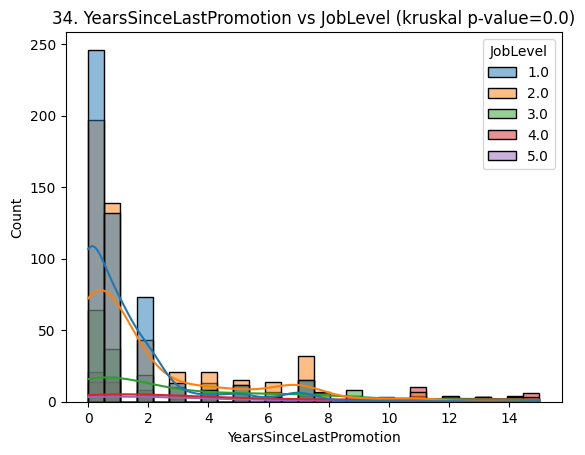

35. YearsSinceLastPromotion vs RelationshipSatisfaction (kruskal p-value=0.003)


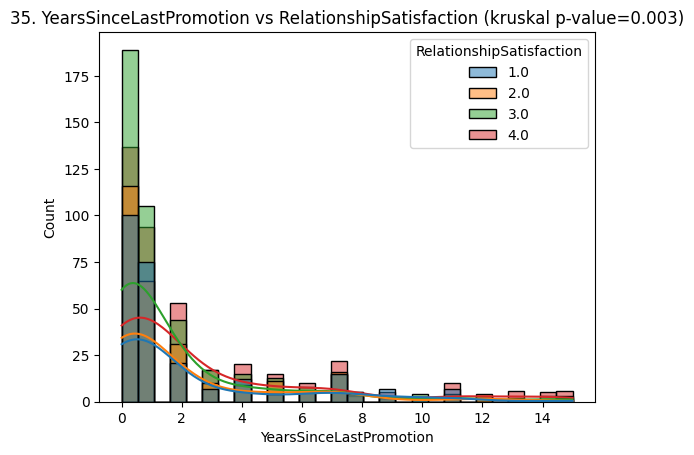

36. YearsSinceLastPromotion vs JobRole (kruskal p-value=0.0)


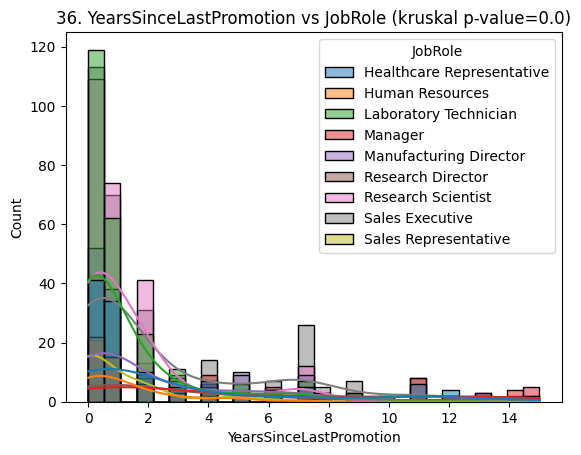

37. YearsSinceLastPromotion vs MaritalStatus (kruskal p-value=0.012)


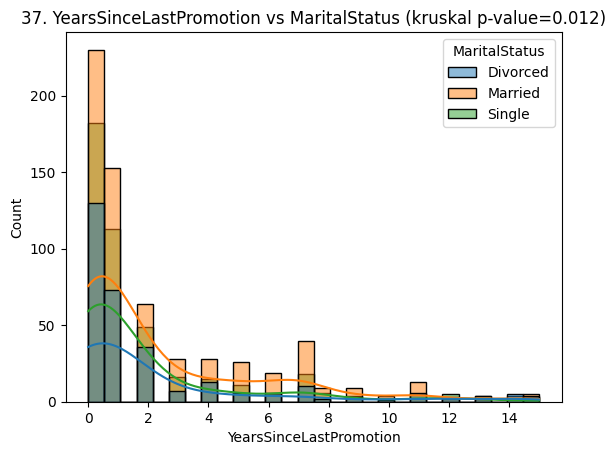

38. YearsWithCurrManager vs JobLevel (kruskal p-value=0.0)


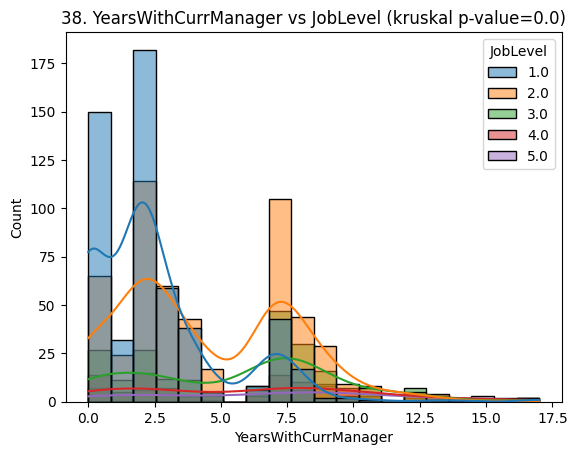

39. YearsWithCurrManager vs JobRole (kruskal p-value=0.0)


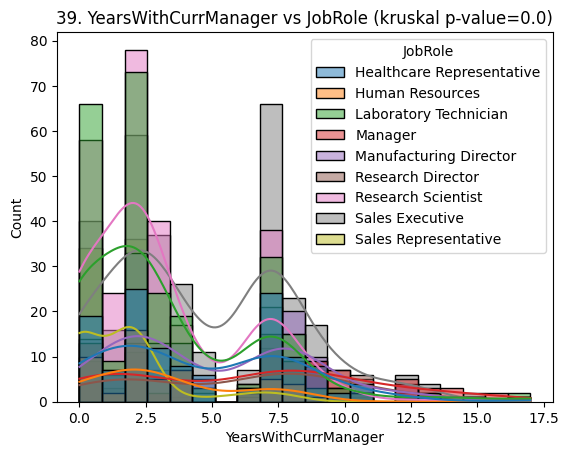

40. SalaryAddition vs PerformanceRating(mannwhitneyu p-value=0.033)


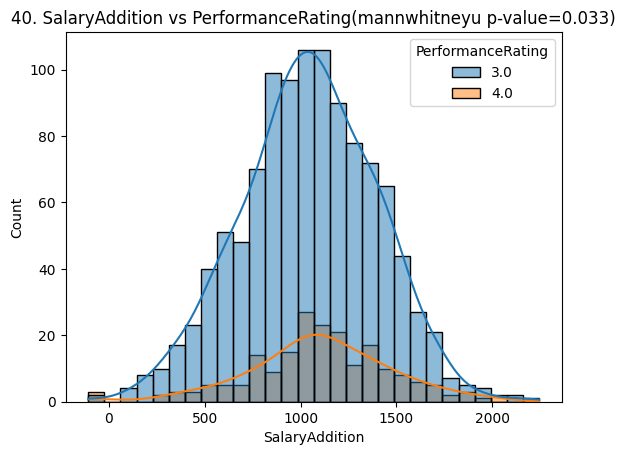

41. SalaryAddition vs RelationshipSatisfaction (kruskal p-value=0.011)


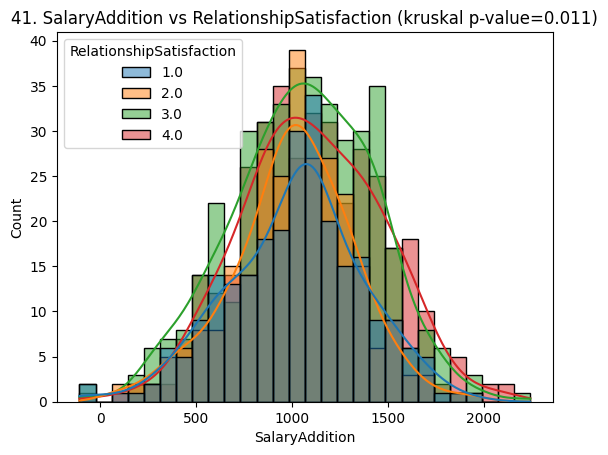

42. SalaryAddition vs Department (kruskal p-value=0.045)


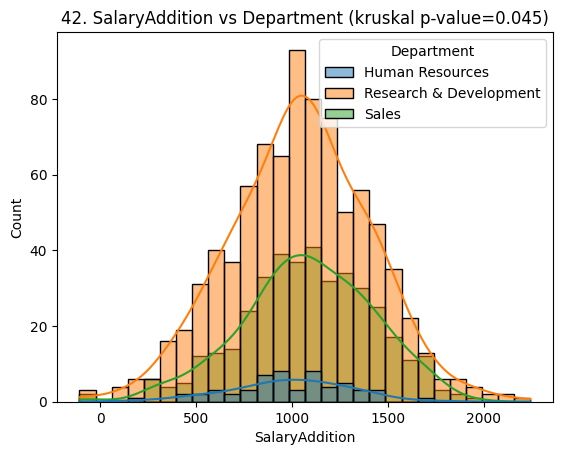

43. YearlyHollidayDays vs Department (kruskal p-value=0.005)


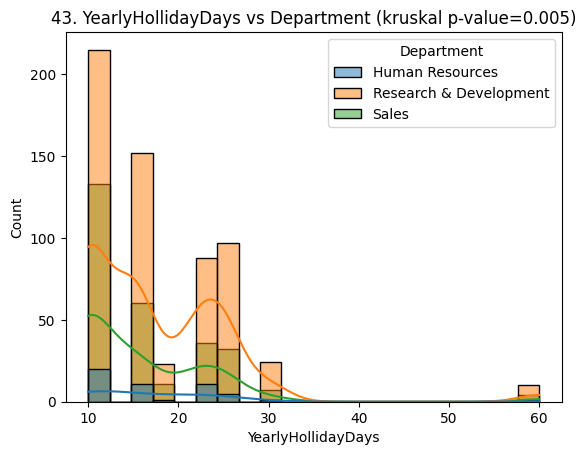

44. YearlyHollidayDays vs JobRole (kruskal p-value=0.049)


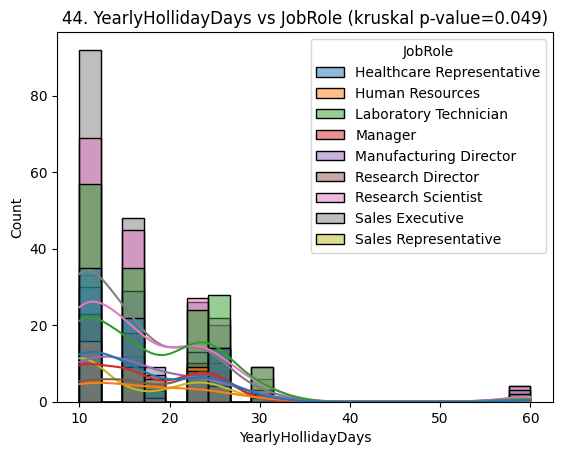

45. TrainingTimesLastYear vs OverTime(mannwhitneyu p-value=0.006)


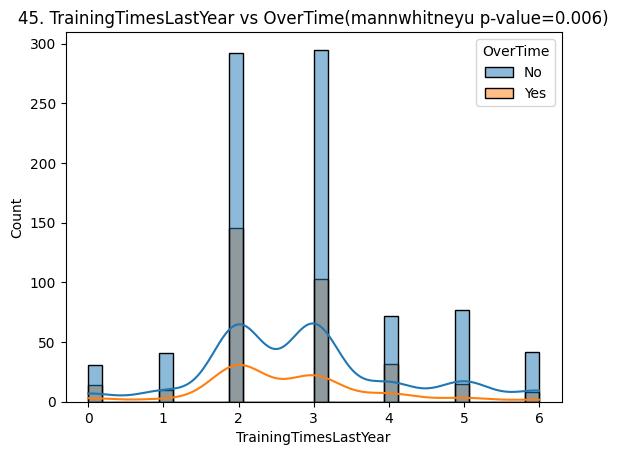

In [ ]:
total_idx = 0

for i in range(0,len(numvar)):
    for j in range(0,len(catvar)):
        title = numvar[i]," vs ", catvar[j]
        df1 = df[[numvar[i],catvar[j]]].dropna()
        catgrp = []
        for c in df1[catvar[j]].cat.categories:
            catgrp.append(np.array(list(df1.loc[df1[catvar[j]]==c,numvar[i]])))
        if (len(catgrp)==1):
            # this is constant
            continue
        elif (len(catgrp)==2):
            mu = mannwhitneyu(*catgrp)
            cl = ['red' if mu[1] < 0.05 else 'green']
            bg = ['Yellow' if mu[1] < 0.05 else 'white']
            title = numvar[i] + ' vs ' + catvar[j] + '(mannwhitneyu p-value=' + str(round(mu[1],3)) + ')'
        else:
            mu = kruskal(*catgrp)
            cl = ['red' if mu[1] < 0.05 else 'green']
            bg = ['Yellow' if mu[1] < 0.05 else 'white']
            title = numvar[i] + ' vs ' + catvar[j] +  ' (kruskal p-value=' + str(round(mu[1],3)) + ')'

        if mu[1] <= 0.05:
            total_idx += 1
            title = str(total_idx) + ". " + title
            print(title)
            sns.histplot(x=df1[numvar[i]], hue=df1[catvar[j]], kde=True).set_title(title)
            plt.show()

In [ ]:
# All the p_values below p = 0.05 are significantly different when dividing to categories

In [ ]:
df['BusinessTravel'].replace({'Non-Travel': 0, 'Travel_Rarely': 1, 'Travel_Frequently': 2}, inplace=True)

In [ ]:
df['Gender'].replace({'Female': 0, 'Male': 1}, inplace=True)

# Question 6 - PCA in order to check if there are subgroup of individuals that can be identified

In [ ]:
# PCA should be only on the continues variables

In [ ]:
type_to_col['continuous'], len(type_to_col['continuous'])

(['Age',
  'DailyRate',
  'DistanceFromHome',
  'HourlyRate',
  'MonthlyIncome',
  'MonthlyRate',
  'NumCompaniesWorked',
  'PercentSalaryHike',
  'TotalWorkingYears',
  'YearsAtCompany',
  'YearsInCurrentRole',
  'YearsSinceLastPromotion',
  'YearsWithCurrManager',
  'SalaryAddition',
  'YearlyHollidayDays',
  'TrainingTimesLastYear',
  'DrivingKilometers'],
 17)

In [ ]:
# Dividing the variables into relatable groups
cols_family_years = ['Age', 'NumCompaniesWorked', 'TotalWorkingYears']
cols_family_company = ['YearsAtCompany', 'YearsInCurrentRole', 'YearsSinceLastPromotion', 'YearsWithCurrManager']
cols_family_money = ['DailyRate', 'HourlyRate', 'MonthlyIncome', 'MonthlyRate', 'PercentSalaryHike', 'SalaryAddition']
cols_distance = ["DistanceFromHome", "DrivingKilometers"]
cols_family_other = ['YearlyHollidayDays', 'TrainingTimesLastYear']


print(sorted(cols_family_years + cols_family_company + cols_family_money + cols_distance + cols_family_other) == sorted(type_to_col['continuous']))
family_to_cols = {"years": cols_family_years, "company": cols_family_company, "money": cols_family_money, "distance": cols_distance, "other": cols_family_other}

True


In [ ]:
# PCA as in the first two answers of this post: https://stackoverflow.com/questions/50796024/feature-variable-importance-after-a-pca-analysis

In [ ]:
def myplot(score,coeff,labels=None):
    xs = score[:,0]
    ys = score[:,1]
    n = coeff.shape[0]
    scalex = 1.0/(xs.max() - xs.min())
    scaley = 1.0/(ys.max() - ys.min())
    plt.scatter(xs * scalex,ys * scaley, c = y)
    for i in range(n):
        plt.arrow(0, 0, coeff[i,0], coeff[i,1], color = 'r',alpha = 0.5)
        if labels is None:
            plt.text(coeff[i,0]* 1.15, coeff[i,1] * 1.15, "Var"+str(i+1), color = 'g', ha = 'center', va = 'center')
        else:
            plt.text(coeff[i,0]* 1.15, coeff[i,1] * 1.15, labels[i], color = 'g', ha = 'center', va = 'center')

years


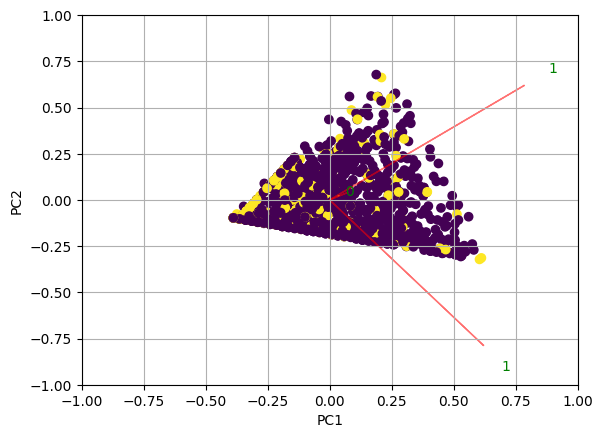

[0.81451727 0.14865873 0.036824  ]
[pca] >Extracting column labels from dataframe.
[pca] >Extracting row labels from dataframe.
[pca] >The PCA reduction is performed to capture [95.0%] explained variance using the [3] columns of the input data.
[pca] >Fit using PCA.
[pca] >Compute loadings and PCs.
[pca] >Compute explained variance.
[pca] >Number of components is [2] that covers the [95.00%] explained variance.
[pca] >The PCA reduction is performed on the [3] columns of the input dataframe.
[pca] >Fit using PCA.
[pca] >Compute loadings and PCs.
[pca] >Outlier detection using Hotelling T2 test with alpha=[0.05] and n_components=[2]
[pca] >Multiple test correction applied for Hotelling T2 test: [fdr_bh]
[pca] >Outlier detection using SPE/DmodX with n_std=[3]
    PC             feature   loading  type
0  PC1                 Age  0.782307  best
1  PC2   TotalWorkingYears -0.785385  best
2  PC1  NumCompaniesWorked  0.070680  weak
company


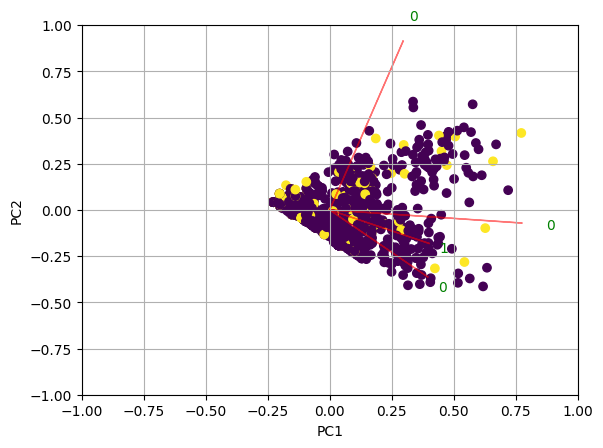

[0.80476899 0.08063784 0.06448232 0.05011084]
[pca] >Extracting column labels from dataframe.
[pca] >Extracting row labels from dataframe.
[pca] >The PCA reduction is performed to capture [95.0%] explained variance using the [4] columns of the input data.
[pca] >Fit using PCA.
[pca] >Compute loadings and PCs.
[pca] >Compute explained variance.
[pca] >Number of components is [4] that covers the [95.00%] explained variance.
[pca] >The PCA reduction is performed on the [4] columns of the input dataframe.
[pca] >Fit using PCA.
[pca] >Compute loadings and PCs.
[pca] >Outlier detection using Hotelling T2 test with alpha=[0.05] and n_components=[4]
[pca] >Multiple test correction applied for Hotelling T2 test: [fdr_bh]
[pca] >Outlier detection using SPE/DmodX with n_std=[3]
    PC                  feature   loading  type
0  PC1           YearsAtCompany  0.772826  best
1  PC2  YearsSinceLastPromotion  0.911891  best
2  PC3       YearsInCurrentRole -0.681870  best
3  PC4     YearsWithCurrManage

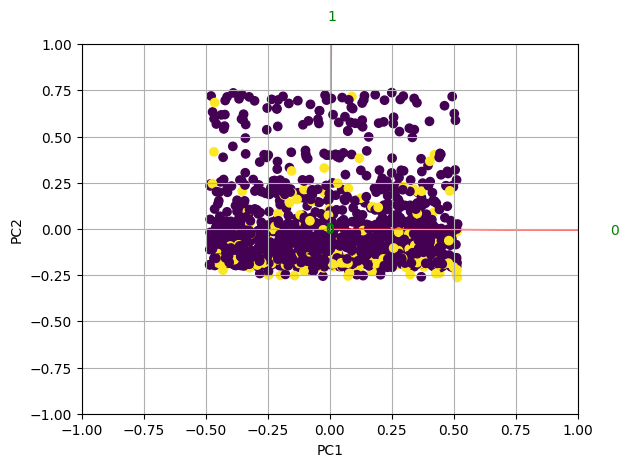

[7.41418535e-01 2.54346951e-01 2.37495773e-03 1.85334747e-03
 6.01180610e-06 1.96984933e-07]
[pca] >Extracting column labels from dataframe.
[pca] >Extracting row labels from dataframe.
[pca] >The PCA reduction is performed to capture [95.0%] explained variance using the [6] columns of the input data.
[pca] >Fit using PCA.
[pca] >Compute loadings and PCs.
[pca] >Compute explained variance.
[pca] >Number of components is [2] that covers the [95.00%] explained variance.
[pca] >The PCA reduction is performed on the [6] columns of the input dataframe.
[pca] >Fit using PCA.
[pca] >Compute loadings and PCs.
[pca] >Outlier detection using Hotelling T2 test with alpha=[0.05] and n_components=[2]
[pca] >Multiple test correction applied for Hotelling T2 test: [fdr_bh]
[pca] >Outlier detection using SPE/DmodX with n_std=[3]
    PC            feature   loading  type
0  PC1        MonthlyRate  0.999975  best
1  PC2      MonthlyIncome  0.999976  best
2  PC1          DailyRate -0.001418  weak
3  PC2 

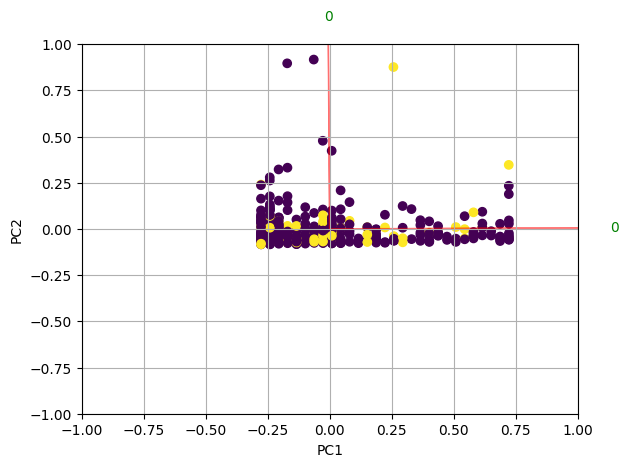

[0.98152544 0.01847456]
[pca] >Extracting column labels from dataframe.
[pca] >Extracting row labels from dataframe.
[pca] >The PCA reduction is performed to capture [95.0%] explained variance using the [2] columns of the input data.
[pca] >Fit using PCA.
[pca] >Compute loadings and PCs.
[pca] >Compute explained variance.
[pca] >Number of components is [1] that covers the [95.00%] explained variance.
[pca] >The PCA reduction is performed on the [2] columns of the input dataframe.
[pca] >Fit using PCA.
[pca] >Compute loadings and PCs.
[pca] >Outlier detection using Hotelling T2 test with alpha=[0.05] and n_components=[1]
[pca] >Multiple test correction applied for Hotelling T2 test: [fdr_bh]
[pca] >Outlier detection using SPE/DmodX with n_std=[3]
    PC            feature   loading  type
0  PC1   DistanceFromHome  0.999986  best
1  PC1  DrivingKilometers -0.005298  weak
other


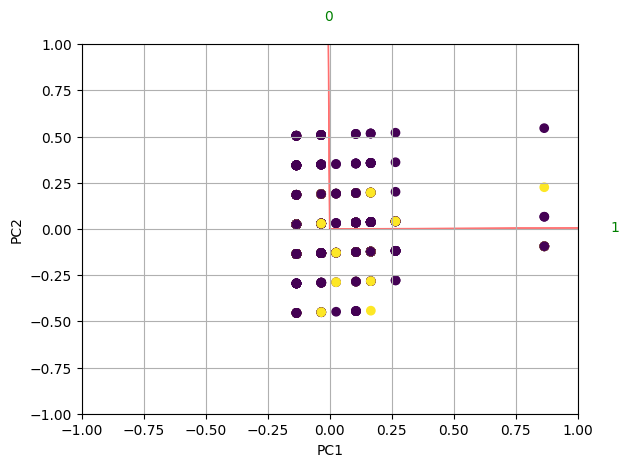

[0.97646555 0.02353445]
[pca] >Extracting column labels from dataframe.
[pca] >Extracting row labels from dataframe.
[pca] >The PCA reduction is performed to capture [95.0%] explained variance using the [2] columns of the input data.
[pca] >Fit using PCA.
[pca] >Compute loadings and PCs.
[pca] >Compute explained variance.
[pca] >Number of components is [1] that covers the [95.00%] explained variance.
[pca] >The PCA reduction is performed on the [2] columns of the input dataframe.
[pca] >Fit using PCA.
[pca] >Compute loadings and PCs.
[pca] >Outlier detection using Hotelling T2 test with alpha=[0.05] and n_components=[1]
[pca] >Multiple test correction applied for Hotelling T2 test: [fdr_bh]
[pca] >Outlier detection using SPE/DmodX with n_std=[3]
    PC                feature   loading  type
0  PC1     YearlyHollidayDays  0.999987  best
1  PC1  TrainingTimesLastYear -0.005155  weak


In [ ]:
# Performing and visualizing PCA
from sklearn.decomposition import PCA
from pca import pca

pca_sklearn = PCA()

for family_cols in family_to_cols.keys():
    df_without_nans = df[[label_col] + family_to_cols[family_cols]].copy()
    df_without_nans = df_without_nans.dropna()

    X = df_without_nans.loc[:, df_without_nans.columns != label_col]
    y = df_without_nans[label_col]
    principalComponents = pca_sklearn.fit_transform(X)
    y = pd.Series(np.where(y.values == 'Yes', 1, 0))
#     print(X, y)

    plt.xlim(-1,1)
    plt.ylim(-1,1)
    plt.xlabel("PC{}".format(1))
    plt.ylabel("PC{}".format(2))
    plt.grid()

    # Call the function. Use only the 2 PCs.
    print(family_cols)
    myplot(principalComponents[:,0:2],np.transpose(pca_sklearn.components_[0:2, :]), y)
    plt.show()
    print(pca_sklearn.explained_variance_ratio_)

    # Lets create a dataset with features that have decreasing variance.
    # We want to extract feature f1 as most important, followed by f2 etc

    # Initialize
    model = pca(n_components=0.95)
    # Fit transform
    out = model.fit_transform(X)

    # Print the top features. The results show that f1 is best, followed by f2 etc
    print(out['topfeat'])

In [ ]:
# In the graph of:
# 0  PC1           YearsAtCompany  0.772826  best
# 1  PC2  YearsSinceLastPromotion  0.911891  best
# 2  PC3       YearsInCurrentRole -0.681870  best
# 3  PC4     YearsWithCurrManager -0.774209  best
# money
# it might be that the yellow group are tending to be in the lowest 1 axis

# In the graph of:
#     PC            feature   loading  type
# 0  PC1        MonthlyRate  0.999975  best
# 1  PC2      MonthlyIncome  0.999976  best
# 2  PC1          DailyRate -0.001418  weak
# 3  PC2         HourlyRate -0.000074  weak
# 4  PC2  PercentSalaryHike -0.000020  weak
# 5  PC2     SalaryAddition  0.000836  weak
# distance

# I think the yellows tend to be close to y axis

# ---
# However, it seems to me that there no any division to "good" groups in the PCA Analysis